In [ ]:
%%time
import os
os.environ['OMP_NUM_THREADS'] = '1'
import SynPy as sp
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.patches as patches
# import matplotlib.cm as cm
import re
from tqdm import tqdm
import seaborn as sns
import multiprocessing as mp
import fnmatch
import pickle
from sklearn import preprocessing
from scipy.stats import linregress

#--Run Options--#
conf_dir = os.path.join(os.getcwd(), 'confs/')
output_dir = os.path.join(os.getcwd(), 'outputs/')


grid_dir_name = 'bursts_oscillation_fixed'
new_conf_dir = os.path.join(conf_dir, grid_dir_name)
new_output_dir = os.path.join(output_dir, grid_dir_name)

In [ ]:
with open('scaled-105_t0s.pkl', 'rb') as file:
    taus = pickle.load(file)
    
taus.keys()

In [ ]:
iaf_values = {float(key.split('=')[-1]): value for key, value in data_dict.items()}

IAF 13.0: Correlation = -0.411, p-value = 0.000000. corrected_p = True

IAF 12.5: Correlation = -0.398, p-value = 0.000000. corrected_p = True

IAF 12.0: Correlation = -0.286, p-value = 0.000001. corrected_p = True

IAF 11.5: Correlation = -0.234, p-value = 0.000052. corrected_p = True

IAF 11.0: Correlation = -0.210, p-value = 0.000125. corrected_p = False

IAF 10.5: Correlation = -0.562, p-value = 0.000000. corrected_p = True

IAF 10.0: Correlation = -0.366, p-value = 0.000000. corrected_p = True

IAF 9.5: Correlation = -0.370, p-value = 0.000000. corrected_p = True

IAF 9.0: Correlation = -0.359, p-value = 0.000000. corrected_p = True

IAF 8.5: Correlation = -0.310, p-value = 0.000014. corrected_p = True

IAF 8.0: Correlation = -0.105, p-value = 0.064644. corrected_p = False



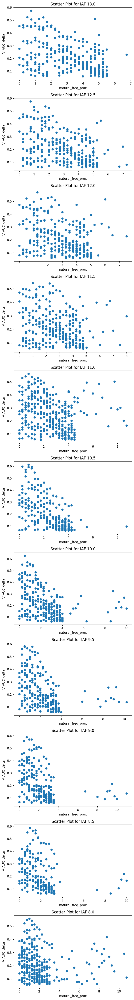

In [144]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

def find_closest_harmonic(value, dominant_freq, max_harmonic=1, max_subharmonic=2):
    frequencies = np.concatenate([dominant_freq * np.arange(1, max_harmonic + 1),
                                  dominant_freq / np.arange(1, max_subharmonic + 1)])
    closest_freq = frequencies[np.argmin(np.abs(value - frequencies))]
    deviation = np.abs(value - closest_freq)
    return round(deviation, 3)

# Set up the number of subplots
fig, axs = plt.subplots(len(iaf_values), figsize=(6, len(iaf_values) * 4))

for i, (iaf, df) in enumerate(iaf_values.items()):
    
    # Filter the subset where V_AUC_delta is >= 10% of its maximum
    subset = df.loc[df['V_AUC_delta'] >= df['V_AUC_delta'].max() * 0.1].index

    # Calculate deviations for each value in PARAM_osc
    array_values = df['PARAM_osc']
    deviations = [find_closest_harmonic(value, iaf) for value in array_values]
    df['natural_freq_prox'] = deviations

    # Calculate the correlation coefficient and p-value
    corr_coeff, p_value = pearsonr(df['natural_freq_prox'].loc[subset], df['V_AUC_delta'].loc[subset])
    print(f"IAF {iaf}: Correlation = {corr_coeff:.3f}, p-value = {p_value:.6f}. corrected_p = {.001 > p_value * len(iaf_values)}")
    print()
    
    # Plot the scatter plot for this IAF, using the subset for filtering
    axs[i].scatter(df['natural_freq_prox'].loc[subset], df['V_AUC_delta'].loc[subset])
    axs[i].set_title(f'Scatter Plot for IAF {iaf}')
    axs[i].set_xlabel('natural_freq_prox')
    axs[i].set_ylabel('V_AUC_delta')

plt.tight_layout()
plt.show()


    


In [147]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm

def find_closest_harmonic(value, dominant_freq, max_harmonic=1, max_subharmonic=2):
    frequencies = np.concatenate([dominant_freq * np.arange(1, max_harmonic + 1),
                                  dominant_freq / np.arange(1, max_subharmonic + 1)])
    closest_freq = frequencies[np.argmin(np.abs(value - frequencies))]
    deviation = np.abs(value - closest_freq)
    return round(deviation, 3)


# Dictionary to store results for each IAF
results_dict = {}

# Iterate over each IAF and perform MLR analysis
for iaf, df in iaf_values.items():
    
    # Filter the subset where V_AUC_delta is >= 10% of its maximum
    subset = df.loc[df['V_AUC_delta'] >= df['V_AUC_delta'].max() * 0.1].index

    # Calculate deviations for each value in PARAM_osc
    array_values = df['PARAM_osc']
    deviations = [find_closest_harmonic(value, iaf) for value in array_values]
    df['natural_freq_prox'] = deviations

    # Subset the data
    df_subset = df.loc[subset]

    # Prepare the data for MLR (add constant for intercept)
    X = sm.add_constant(df_subset['natural_freq_prox'])  # IV
    y = df_subset['V_AUC_delta']  # DV

    # Fit the OLS regression model
    model = sm.OLS(y, X)
    results = model.fit()

    # Store the regression results in the dictionary
    results_dict[iaf] = {
        'coef': results.params['natural_freq_prox'],
        't_value': results.tvalues['natural_freq_prox'],
        'p_value': results.pvalues['natural_freq_prox'],
        'corrected_p_value': results.pvalues['natural_freq_prox'] * len(iaf_values),
        'r_squared': results.rsquared
    }

# After all iterations, print the summarized results
for iaf, res in results_dict.items():
    print(f"IAF {iaf}:")
    print(f"  Coefficient for natural_freq_prox: {res['coef']:.3f}")
    print(f"  t-value: {res['t_value']:.3f}")
    print(f"  p-value: {res['p_value']:.6f}")
    print(f"  Bonferroni corrected p-value: {res['corrected_p_value']:.6f}")
    print(f"  R-squared: {res['r_squared']:.3f}")
    print()


IAF 13.0:
  Coefficient for natural_freq_prox: -0.030
  t-value: -7.415
  p-value: 0.000000
  Bonferroni corrected p-value: 0.000000
  R-squared: 0.169

IAF 12.5:
  Coefficient for natural_freq_prox: -0.030
  t-value: -7.197
  p-value: 0.000000
  Bonferroni corrected p-value: 0.000000
  R-squared: 0.159

IAF 12.0:
  Coefficient for natural_freq_prox: -0.023
  t-value: -5.009
  p-value: 0.000001
  Bonferroni corrected p-value: 0.000011
  R-squared: 0.082

IAF 11.5:
  Coefficient for natural_freq_prox: -0.019
  t-value: -4.108
  p-value: 0.000052
  Bonferroni corrected p-value: 0.000570
  R-squared: 0.055

IAF 11.0:
  Coefficient for natural_freq_prox: -0.016
  t-value: -3.883
  p-value: 0.000125
  Bonferroni corrected p-value: 0.001375
  R-squared: 0.044

IAF 10.5:
  Coefficient for natural_freq_prox: -0.056
  t-value: -10.011
  p-value: 0.000000
  Bonferroni corrected p-value: 0.000000
  R-squared: 0.316

IAF 10.0:
  Coefficient for natural_freq_prox: -0.026
  t-value: -6.175
  p-value

In [296]:
np.corrcoef(fixed_105['bursts_oscillation_600'].loc[subset]['coupling.se.gnmda_std'],
            fixed_syn_change['coupling.se.nu_post'])

array([[ 1.       , -0.9836003],
       [-0.9836003,  1.       ]])

In [13]:
with open('scaled-105.pkl', 'rb') as file:
    scaled_105 = pickle.load(file)
    
with open('fixed-105.pkl', 'rb') as file:
    fixed_105 = pickle.load(file)

In [14]:
# subset = (scaled_105['bursts_oscillation_600']['PARAM_bur'].between(2,21)) & (scaled_105['bursts_oscillation_600']['V_AUC_delta'] >= .05); subset = subset[subset == True].index
subset = scaled_105['bursts_oscillation_600'].loc[(scaled_105['bursts_oscillation_600']['V_AUC_delta'] >= scaled_105['bursts_oscillation_600']['V_AUC_delta'].max() * .1)].index

fixed_subset = fixed_105['bursts_oscillation_600'].loc[(fixed_105['bursts_oscillation_600']['V_AUC_delta'] >= fixed_105['bursts_oscillation_600']['V_AUC_delta'].max() * .1)].index

scaled_105['bursts_oscillation_600']['alpha_PW_delta'] = scaled_105['bursts_oscillation_600']['alpha_PW_delta']*-1 # invert alpha delta values so that negative values depict alpha suppression:
fixed_105['bursts_oscillation_600']['alpha_PW_delta'] = scaled_105['bursts_oscillation_600']['alpha_PW_delta']*-1

In [15]:
def find_closest_harmonic(value, dominant_freq, max_harmonic=1, max_subharmonic=2):
    frequencies = np.concatenate([dominant_freq * np.arange(1, max_harmonic + 1),
                                  dominant_freq / np.arange(1, max_subharmonic + 1)])
    closest_freq = frequencies[np.argmin(np.abs(value - frequencies))]
    deviation = np.abs(value - closest_freq)
    return round(deviation, 3)



# Example data
for cf, df in scaled_105.items():
    dominant_freq = 10.5
    array_values = df['PARAM_osc']
    
    # Calculate deviations for each value in the array
    deviations = [find_closest_harmonic(value, dominant_freq) for value in array_values]
    
    scaled_105[cf]['natural_freq_prox'] = deviations
    
# Example data
for cf, df in fixed_105.items():
    dominant_freq = 10.5
    array_values = df['PARAM_osc']
    
    # Calculate deviations for each value in the array
    deviations = [find_closest_harmonic(value, dominant_freq) for value in array_values]
    
    fixed_105[cf]['natural_freq_prox'] = deviations


In [16]:
scaled_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_data = fixed_105['bursts_oscillation_600'].loc[subset]

# Synaptic Weight
remove_nu_list = ['coupling.sn.nu_delta', 'coupling.ex.nu_delta', 'coupling.sn.nu_post', 'coupling.ex.nu_post']
nu_deltas = [col for col in scaled_data.columns if 'nu_delta' in col and col not in remove_nu_list]

scaled_nus = scaled_data[nu_deltas]
scaled_nus_normal = (scaled_nus - scaled_nus.min()) / (scaled_nus.max() - scaled_nus.min())

fixed_nus = fixed_data[nu_deltas]
fixed_nus_normal = (fixed_nus - fixed_nus.min()) / (fixed_nus.max() - fixed_nus.min())

scaled_105['bursts_oscillation_600']['mean_synaptic_weight_delta'] = scaled_nus.mean(axis = 1)
fixed_105['bursts_oscillation_600']['mean_synaptic_weight_delta'] = fixed_nus.mean(axis = 1)


In [17]:
xyz_gainer = scaled_105['bursts_oscillation_600']

remove_nu_list = ['coupling.sn.nu_delta', 'coupling.ex.nu_delta', 'coupling.sn.nu_post', 'coupling.ex.nu_post']
remove_ca_list = ['sn_Ca_active', 'ex_Ca_active', 'RAW_sn_Ca_active', 'RAW_ex_Ca_active']

ltp_cols = [col for col in xyz_gainer.columns if 'Ca_ltp' in col and col not in remove_ca_list and 'RAW' in col]
ltd_cols = [col for col in xyz_gainer.columns if 'Ca_ltd' in col and col not in remove_ca_list and 'RAW' in col]


def remove_suffix(column_name):
    return column_name.replace('_ltp', '').replace('_ltd', '')

ltp_ltd_diffs_df = pd.DataFrame()

for dose, df in scaled_105.items():
#     ltps = sp.norm(df[ltp_cols])[subset]
#     ltds = sp.norm(df[ltd_cols])[subset]
    
    scaled_ltps = df[ltp_cols].loc[subset]
    scaled_ltds = df[ltd_cols].loc[subset]

    scaled_ltps_full = df[ltp_cols]
    scaled_ltds_full = df[ltd_cols]

    
    scaled_ltps.columns = scaled_ltps.columns.map(remove_suffix)
    scaled_ltds.columns = scaled_ltds.columns.map(remove_suffix)

    
    scaled_105[dose]['ltp_ltd_diff'] = (scaled_ltps - scaled_ltds).mean(axis = 1)
    
    
ltp_ltd_diffs_df = pd.DataFrame()
    
for dose, df in fixed_105.items():
    fixed_ltps = df[ltp_cols].loc[subset]
    fixed_ltds = df[ltd_cols].loc[subset]

    
    fixed_ltps_full = df[ltp_cols]
    fixed_ltds_full = df[ltd_cols]
    
    fixed_ltps.columns = fixed_ltps.columns.map(remove_suffix)
    fixed_ltds.columns = fixed_ltds.columns.map(remove_suffix)

    
    fixed_105[dose]['ltp_ltd_diff'] = (fixed_ltps - fixed_ltds).mean(axis = 1)



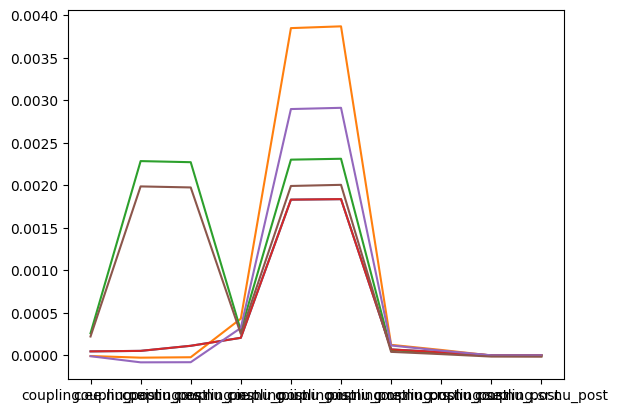

In [18]:
# Example DataFrame
nu_post = [col for col in scaled_105['bursts_oscillation_600'].columns if 'nu_post' in col and col not in remove_nu_list]
gain_post = ['X', 'Y', 'Z']

scaled_syn_df = scaled_105['bursts_oscillation_600'][nu_post].loc[subset]
scaled_syn_df_full = scaled_105['bursts_oscillation_600'][nu_post]

fixed_syn_df = fixed_105['bursts_oscillation_600'][nu_post].loc[subset]

# Initial weights
syn_init_weight = [
    0.001200,
    -0.009839,
    0.009732,
    0.001532,
    -0.009639,
    0.009732,
    0.000143,
    0.000058,
    0.001135,
    -0.001222
]


scaled_gain_df = scaled_105['bursts_oscillation_600'][gain_post].loc[subset]
fixed_gain_df = fixed_105['bursts_oscillation_600'][gain_post].loc[subset]

scaled_gain_df_full = scaled_105['bursts_oscillation_600'][gain_post]
fixed_gain_df_full = fixed_105['bursts_oscillation_600'][gain_post]

gain_init_weight = [.1074,
               .4201,
               .0201
]

# Function to calculate the enhancement or dampening coefficient
def enhancement_or_dampening(col, initial_val):
    delta = abs(col) - abs(initial_val)  # Distance of the new value from zero
    return delta  # Positive = enhancement, Negative = dampening

# Apply the function to each column
scaled_syn_change = scaled_syn_df.apply(lambda col: enhancement_or_dampening(col, syn_init_weight[nu_post.index(col.name)]), axis=0)
scaled_syn_change_full = scaled_syn_df_full.apply(lambda col: enhancement_or_dampening(col, syn_init_weight[nu_post.index(col.name)]), axis=0)

fixed_syn_change = fixed_syn_df.apply(lambda col: enhancement_or_dampening(col, syn_init_weight[nu_post.index(col.name)]), axis=0)


scaled_gain_change = scaled_gain_df.apply(lambda col: enhancement_or_dampening(col, gain_init_weight[gain_post.index(col.name)]), axis=0)
fixed_gain_change = fixed_gain_df.apply(lambda col: enhancement_or_dampening(col, gain_init_weight[gain_post.index(col.name)]), axis=0)

scaled_gain_change_full = scaled_gain_df.apply(lambda col: enhancement_or_dampening(col, gain_init_weight[gain_post.index(col.name)]), axis=0)
fixed_gain_change_full = fixed_gain_df.apply(lambda col: enhancement_or_dampening(col, gain_init_weight[gain_post.index(col.name)]), axis=0)


# Plotting example coefficients
plt.plot(scaled_syn_change.loc['eirs-tms-custom_PERM_[bur=3.00_osc=5.00].output'])
plt.plot(scaled_syn_change.loc['eirs-tms-custom_PERM_[bur=2.00_osc=5.50].output'])
plt.plot(scaled_syn_change.loc['eirs-tms-custom_PERM_[bur=11.00_osc=1.00].output'])

plt.plot(fixed_syn_change.loc['eirs-tms-custom_PERM_[bur=3.00_osc=5.00].output'])
plt.plot(fixed_syn_change.loc['eirs-tms-custom_PERM_[bur=2.00_osc=5.50].output'])
plt.plot(fixed_syn_change.loc['eirs-tms-custom_PERM_[bur=11.00_osc=1.00].output'])

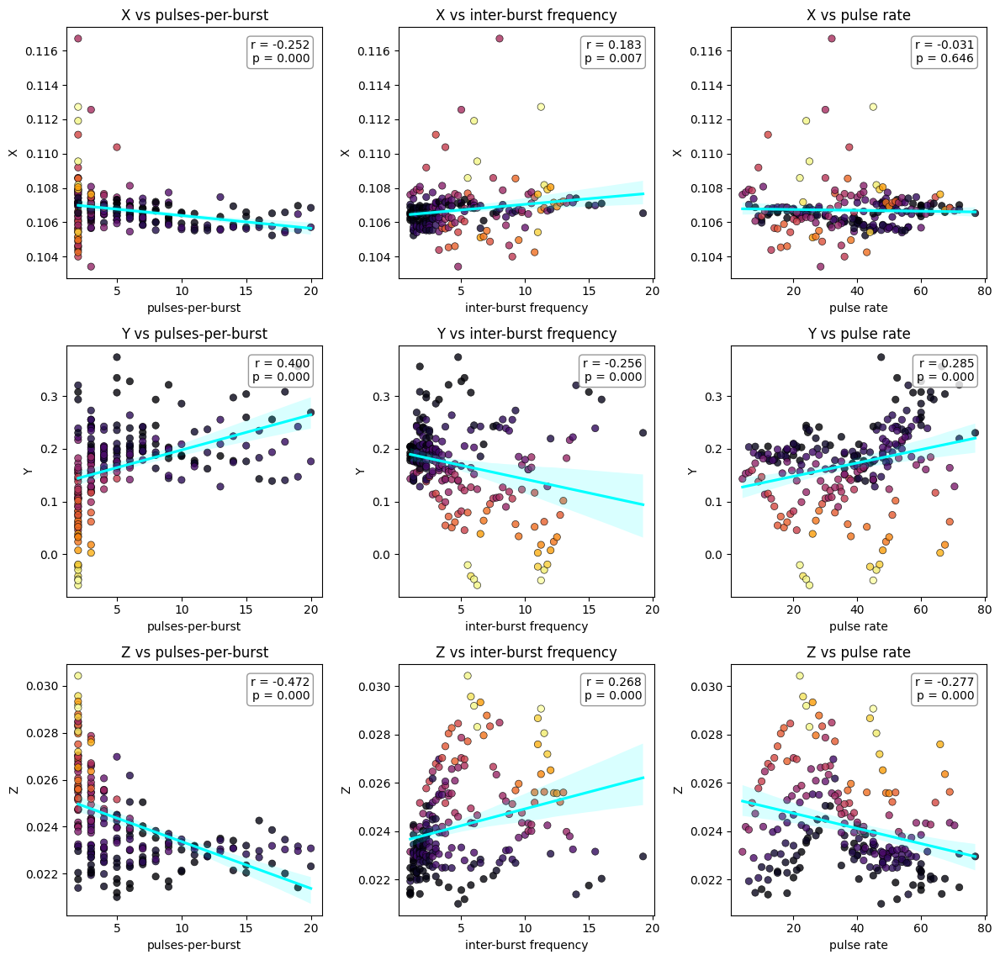

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

# Get the relevant DataFrame
df = scaled_105['bursts_oscillation_600'].loc[subset]

# Define variables
dvs = ['X', 'Y', 'Z']
ivs = ['PARAM_bur', 'PARAM_osc', 'train_dose']
iv_labels = {
    'PARAM_bur': 'pulses-per-burst',
    'PARAM_osc': 'inter-burst frequency',
    'train_dose': 'pulse rate'
}

# Create 3x3 grid
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
# fig.suptitle("Regression Plots Colored by V_AUC_delta", fontsize=16)

# Loop through DV and IV combos
for i, dv in enumerate(dvs):
    for j, iv in enumerate(ivs):
        ax = axes[i, j]

        # Drop NaNs
        subset_df = df[[iv, dv, 'V_AUC_delta']].dropna()

        x = subset_df[iv]
        y = subset_df[dv]
        hue = subset_df['V_AUC_delta']

        # Scatter with thinner edge line
        sc = ax.scatter(x, y, c=hue, cmap='inferno', edgecolor='k', linewidth=0.5, alpha=0.8)

        # Regression line only
        sns.regplot(x=x, y=y, ax=ax, scatter=False, line_kws={"color": "b"})

        # r and p
        if len(x) > 1:
            r_val, p_val = pearsonr(x, y)
            p_text = f"p = {p_val:.3f}"
            annotation = f"r = {r_val:.3f}\n{p_text}"
        else:
            annotation = "r = N/A\np = N/A"

        # Bubble annotation (top-right)
        ax.annotate(annotation, 
                    xy=(0.95, 0.95), 
                    xycoords='axes fraction',
                    fontsize=10,
                    ha='right',
                    bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
                    verticalalignment='top')

        # Titles and labels
        ax.set_title(f'{dv} vs {iv_labels[iv]}')
        ax.set_xlabel(iv_labels[iv])
        ax.set_ylabel(dv)

# Final layout
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.8495255363105957 3.4200484060602536e-62


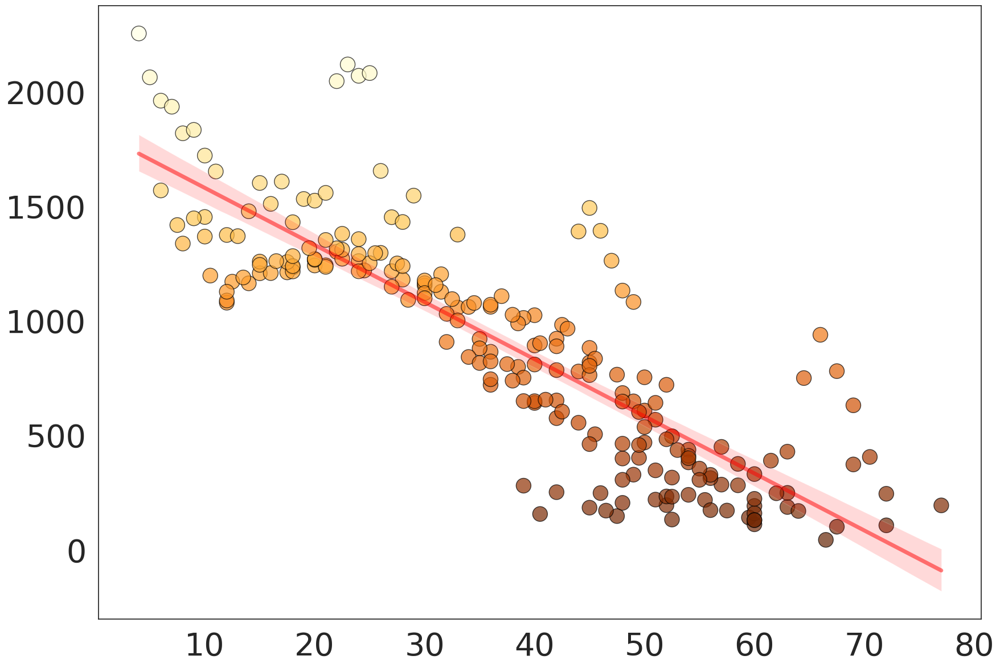

In [137]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = scaled_ltps.mean(axis = 1)
color_variable = y


points = ax.scatter(x, y,c=color_variable, s=350, cmap="YlOrBr_r", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'red', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
# cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


0.838945606887923 2.9572895107874274e-59


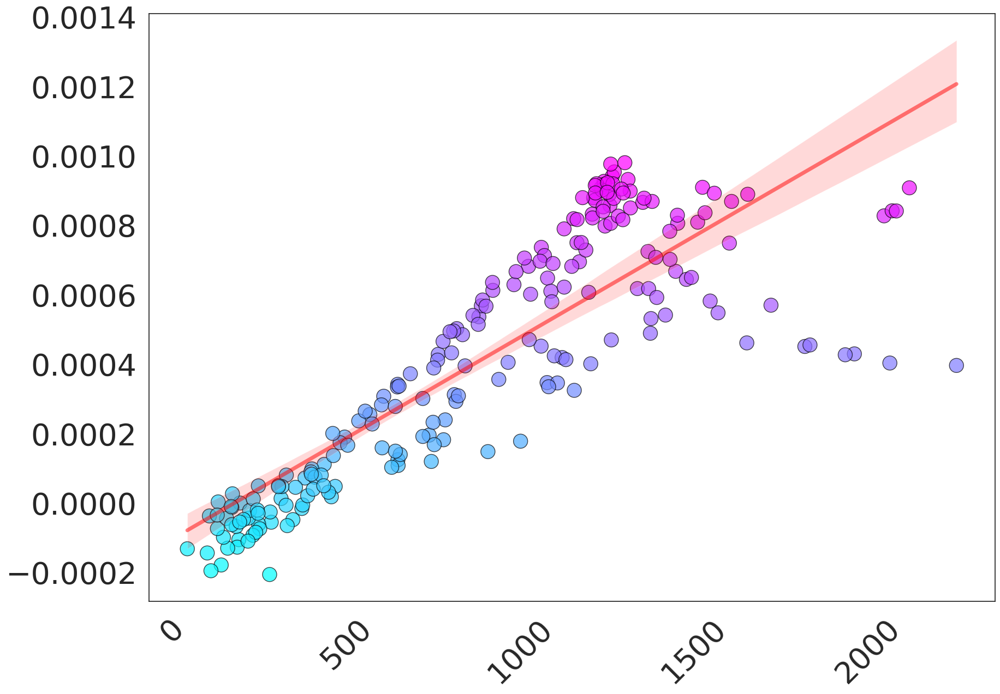

In [136]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = scaled_ltps.mean(axis = 1)
y = scaled_syn_change.mean(axis=1)
color_variable = y


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'red', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })


# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)

ax.tick_params(axis='x', rotation=45)

# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

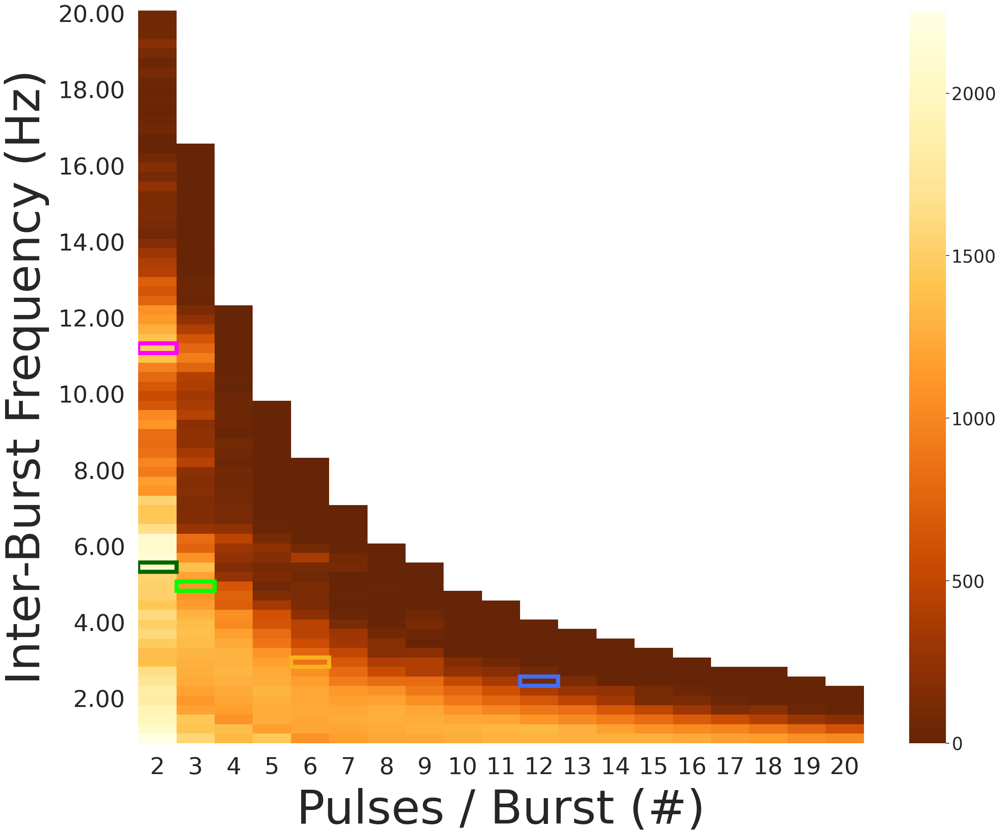

In [139]:
fig, ax = plt.subplots(figsize=(25,20))

ax = sns.heatmap(sp.param_space(scaled_ltps_full.mean(axis=1)), cmap = 'YlOrBr_r')
colorbar = ax.collections[0].colorbar
# colorbar.set_label(r'Cortical E Alpha Power $\Delta$', fontsize = 60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)

xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 21, 1)], fontsize = 40)

ytick_occurance = 8

yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels([format(i, '.2f') for i in np.arange(1, 20 + .25, .25)][::-ytick_occurance], fontsize = 40, rotation = 0)

ax.tick_params(axis='both', pad=10, length = 12, width=3.0)

rect_x = 0
rect_y = 48
rect_width = 5
rect_height = 17

# add physiological range rectangle
dashed_rect = patches.Rectangle(
    (rect_x, rect_y),
    rect_width,
    rect_height,
    linestyle='--',
    linewidth=8,
    edgecolor='white',  # Set the edge color
    facecolor='none', # Make the rectangle transparent inside
    alpha = .8,
)

conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='lime', facecolor='none')
ax.add_patch(conv_itbs)

optimal_itbs = patches.Rectangle((0, 58), 1, 1, linewidth=7, edgecolor='darkgreen', facecolor='none')
ax.add_patch(optimal_itbs)

two_eleven = patches.Rectangle((0, 35), 1, 1, linewidth=7, edgecolor='fuchsia', facecolor='none') # fuchsia
ax.add_patch(two_eleven)

six_three = patches.Rectangle((4, 68), 1, 1, linewidth=7, edgecolor='#fab11e', facecolor='none') # red
ax.add_patch(six_three)

twelve_twofive = patches.Rectangle((10, 70), 1, 1, linewidth=7, edgecolor='#426ff5', facecolor='none') # yellow
ax.add_patch(twelve_twofive)


ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad = 15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad = 15) 

    
plt.tight_layout()

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.3604241177997048 4.045284766231315e-08


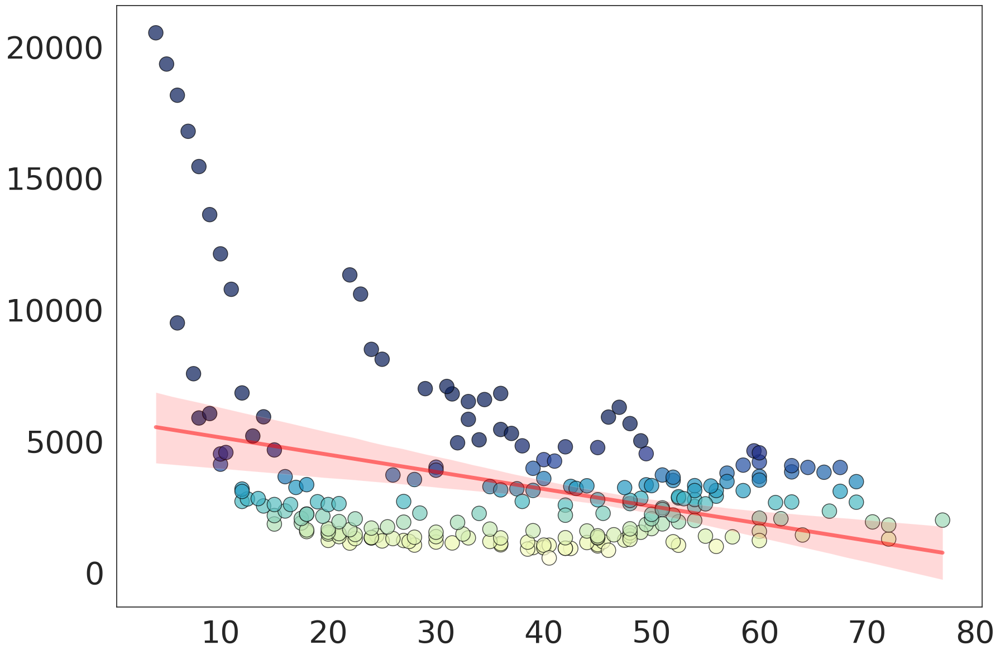

In [132]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = scaled_ltds.mean(axis = 1)
color_variable = y


points = ax.scatter(x, y,c=color_variable, s=350, cmap="YlGnBu", alpha = .7, edgecolor = 'black', vmax = 5000)

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'red', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
# cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.027200127692199302 0.6889387815820748


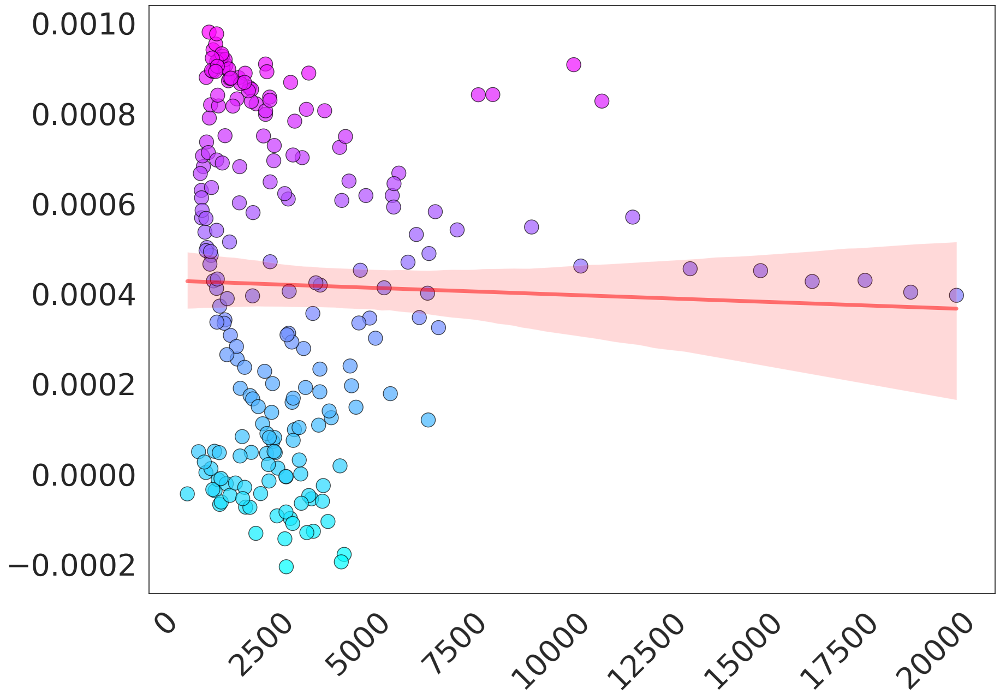

In [135]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = scaled_ltds.mean(axis = 1)
y = scaled_syn_change.mean(axis=1)
color_variable = y


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'red', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })


# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)

ax.tick_params(axis='x', rotation=45)

# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

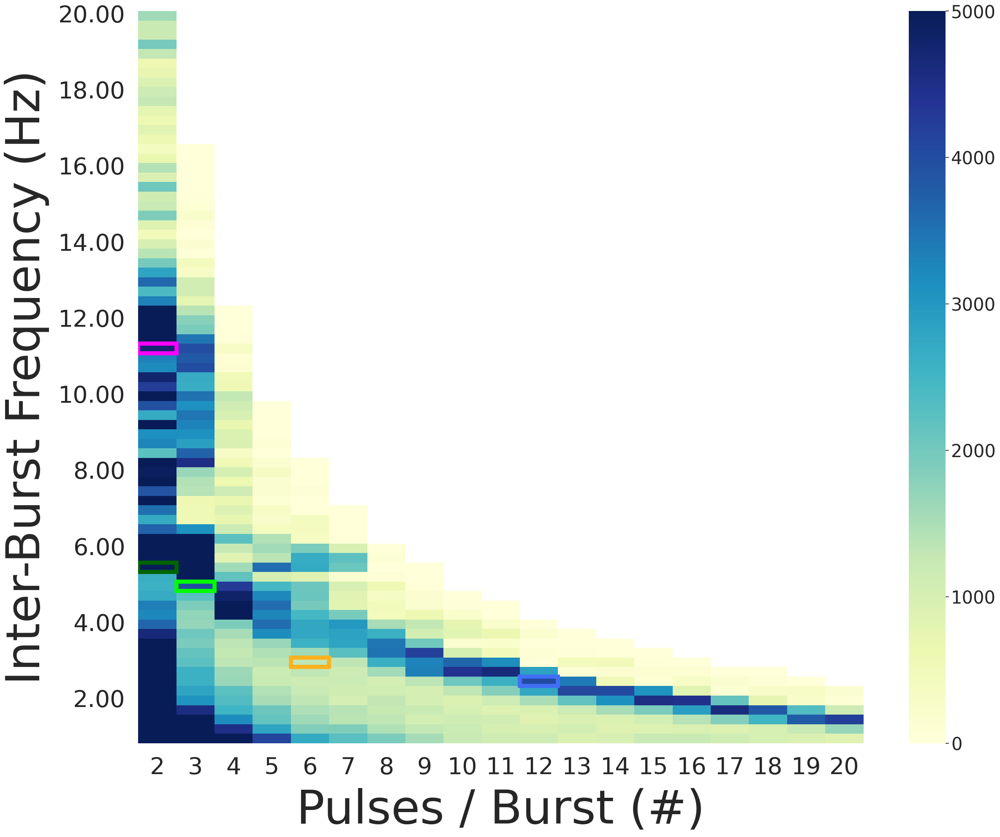

In [138]:
fig, ax = plt.subplots(figsize=(25,20))

ax = sns.heatmap(sp.param_space(scaled_ltds_full.mean(axis=1)), cmap = 'YlGnBu', vmax = 5000)
colorbar = ax.collections[0].colorbar
# colorbar.set_label(r'Cortical E Alpha Power $\Delta$', fontsize = 60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)

xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 21, 1)], fontsize = 40)

ytick_occurance = 8

yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels([format(i, '.2f') for i in np.arange(1, 20 + .25, .25)][::-ytick_occurance], fontsize = 40, rotation = 0)

ax.tick_params(axis='both', pad=10, length = 12, width=3.0)

rect_x = 0
rect_y = 48
rect_width = 5
rect_height = 17

# add physiological range rectangle
dashed_rect = patches.Rectangle(
    (rect_x, rect_y),
    rect_width,
    rect_height,
    linestyle='--',
    linewidth=8,
    edgecolor='white',  # Set the edge color
    facecolor='none', # Make the rectangle transparent inside
    alpha = .8,
)

conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='lime', facecolor='none')
ax.add_patch(conv_itbs)

optimal_itbs = patches.Rectangle((0, 58), 1, 1, linewidth=7, edgecolor='darkgreen', facecolor='none')
ax.add_patch(optimal_itbs)

two_eleven = patches.Rectangle((0, 35), 1, 1, linewidth=7, edgecolor='fuchsia', facecolor='none') # fuchsia
ax.add_patch(two_eleven)

six_three = patches.Rectangle((4, 68), 1, 1, linewidth=7, edgecolor='#fab11e', facecolor='none') # red
ax.add_patch(six_three)

twelve_twofive = patches.Rectangle((10, 70), 1, 1, linewidth=7, edgecolor='#426ff5', facecolor='none') # yellow
ax.add_patch(twelve_twofive)


ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad = 15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad = 15) 


    
plt.tight_layout()

In [ ]:
# Multiple Linear Regression of IVs: post-stim nu weights, against DV: V_AUC_delta 


import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

# Assuming your DataFrame is named MLR_df and contains the following columns:
IVs = ['coupling.ee.nu_post', 'coupling.ei.nu_post', 'coupling.es.nu_post', 
       'coupling.ie.nu_post', 'coupling.ii.nu_post', 'coupling.is.nu_post', 
       'coupling.re.nu_post', 'coupling.rs.nu_post', 'coupling.se.nu_post', 
       'coupling.sr.nu_post']
DV = 'natural_freq_prox'

# Extract the relevant columns from the DataFrames
MLR_df = pd.concat([scaled_syn_change[IVs], 
                    scaled_105['bursts_oscillation_600'].loc[subset][DV]], axis=1)

# Rename columns to avoid issues with the ols package (replace '.' with '_')
MLR_df.columns = MLR_df.columns.str.replace('.', '_')

# Adjust IVs list to match renamed columns
IVs = [iv.replace('.', '_') for iv in IVs]

# Initialize lists to store results
results = []
p_values = []

# Perform multiple linear regression for each IV
for IV in IVs:
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    results.append(model)
    p_values.append(model.pvalues[IV])

# Apply Bonferroni correction
alpha_bonferroni = 0.001
reject_bonferroni, corrected_p_values_bonferroni, _, _ = multipletests(p_values, alpha=alpha_bonferroni, method='bonferroni')

# Apply FDR correction
reject_fdr, corrected_p_values_fdr, _, _ = multipletests(p_values, alpha=alpha_bonferroni, method='fdr_bh')

# Create a summary DataFrame with original and corrected p-values
summary_data = {
    'Independent Variable': IVs,
    'Original p-value': p_values,
    'Bonferroni corrected p-value': corrected_p_values_bonferroni,
    'FDR corrected p-value': corrected_p_values_fdr,
    'Bonferroni reject': reject_bonferroni,
    'FDR reject': reject_fdr
}

# Display coefficients, standard errors, t-values, and p-values for each IV
for idx, IV in enumerate(IVs):
    model = results[idx]
    print(f"===== {IV} =====")
    print(model.summary())

# Create a DataFrame for summary results
summary_results = pd.DataFrame(summary_data)

# Print the summary results
print("\nSummary Results:")
print(summary_results)

In [264]:
### Multiple linear regerssion

import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

IV = 'natural_freq_prox'

# Assuming your DataFrame is named MLR_df and contains the following columns:
MLR_df = pd.concat([scaled_105['bursts_oscillation_600'].loc[subset][[IV]], 
                       scaled_ltps.rename(columns=lambda x: f'ltp_{x}', inplace=False), 
                       scaled_ltds.rename(columns=lambda x: f'ltd_{x}', inplace=False)], axis = 1)

# Identify the independent variable and the dependent variables
DVs = [col for col in MLR_df.columns if col.startswith(('ltp_', 'ltd_'))]
DVs = [DV for DV in DVs if MLR_df[DV].nunique() > 1] # remove non-changing DVs (ie. Se, sr)

# Initialize lists to store results
models = []
summaries = []

# Perform regression analysis for each DV
for DV in DVs:
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    models.append(model)
    summaries.append(model.summary())

# Display summaries of all models
for summary in summaries:
    print(summary)

# Extract p-values for multiple comparison adjustment
p_values = pd.Series({DV: model.pvalues[IV] for DV, model in zip(DVs, models)})

# Apply Bonferroni correction
_, corrected_p_values_bonferroni, _, _ = multipletests(p_values, method='bonferroni')

# Apply FDR correction
_, corrected_p_values_fdr, _, _ = multipletests(p_values, method='fdr_bh')

# Bold the DVs with original p-values less than 0.001
bolded_dvs = [f'**{dv}**' if p < 0.001 else dv for dv, p in p_values.items()]

# Create a DataFrame to compare original and corrected p-values
results = pd.DataFrame({
    'Dependent Variable': bolded_dvs,
    'Original p-value': p_values.values,
    'Bonferroni corrected p-value': corrected_p_values_bonferroni,
    'FDR corrected p-value': corrected_p_values_fdr
})

print(results)

                            OLS Regression Results                            
Dep. Variable:          ltp_RAW_ee_Ca   R-squared:                       0.048
Model:                            OLS   Adj. R-squared:                  0.044
Method:                 Least Squares   F-statistic:                     11.05
Date:                Tue, 20 Aug 2024   Prob (F-statistic):            0.00104
Time:                        03:54:45   Log-Likelihood:                -1769.7
No. Observations:                 219   AIC:                             3543.
Df Residuals:                     217   BIC:                             3550.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept           703.0710    106.20

In [148]:
scaled_105['bursts_oscillation_600']['coupling.ee.nu_post'].loc[subset]
coefficients['coupling.ee.nu_post']

eirs-tms-custom_PERM_[bur=2.00_osc=1.00].output     0.000031
eirs-tms-custom_PERM_[bur=3.00_osc=1.00].output     0.000109
eirs-tms-custom_PERM_[bur=4.00_osc=1.00].output     0.000157
eirs-tms-custom_PERM_[bur=5.00_osc=1.00].output     0.000194
eirs-tms-custom_PERM_[bur=6.00_osc=1.00].output     0.000168
                                                      ...   
eirs-tms-custom_PERM_[bur=2.00_osc=14.00].output   -0.000019
eirs-tms-custom_PERM_[bur=2.00_osc=15.00].output   -0.000022
eirs-tms-custom_PERM_[bur=2.00_osc=15.50].output   -0.000043
eirs-tms-custom_PERM_[bur=2.00_osc=16.00].output   -0.000022
eirs-tms-custom_PERM_[bur=2.00_osc=19.25].output   -0.000025
Name: coupling.ee.nu_post, Length: 219, dtype: float64

In [397]:
for syn in scaled_syn_change.columns:

    print(coef, np.corrcoef(scaled_105['bursts_oscillation_600']['natural_freq_prox'].loc[subset],
          scaled_syn_change[syn])[0][1])

coupling.sr.nu_post 0.4400445101993464
coupling.sr.nu_post 0.42584195224002647
coupling.sr.nu_post 0.42428909661662356
coupling.sr.nu_post -0.0374288776947267
coupling.sr.nu_post -0.09726715999798628
coupling.sr.nu_post -0.09669564824427383
coupling.sr.nu_post -0.3669280288487329
coupling.sr.nu_post -0.4068870997063357
coupling.sr.nu_post -0.18032976341196943
coupling.sr.nu_post -0.18101325488119763


In [153]:
for nu in scaled_nus_normal:

    print(nu, np.corrcoef(scaled_105['bursts_oscillation_600']['V_AUC_delta'].loc[subset], 
            scaled_105['bursts_oscillation_600'][nu].loc[subset])[0][1])

coupling.ee.nu_delta -0.4052056918639509
coupling.ei.nu_delta -0.38841123545998996
coupling.es.nu_delta -0.38902976311249793
coupling.ie.nu_delta 0.4254129377584488
coupling.ii.nu_delta 0.5241241176993761
coupling.is.nu_delta 0.5232815672185217
coupling.re.nu_delta 0.8669770068889331
coupling.rs.nu_delta 0.8487074336954454
coupling.se.nu_delta -0.17336955076216187
coupling.sr.nu_delta -0.17285562936184637


In [168]:
for ltps in scaled_ltps:

    print(ltps, np.corrcoef(scaled_105['bursts_oscillation_600']['natural_freq_prox'].loc[subset], 
            scaled_ltps[ltps])[0][1])

RAW_ee_Ca 0.22010558123101623
RAW_ei_Ca 0.30275014294936453
RAW_es_Ca 0.30402176105243567
RAW_ie_Ca 0.00037627706467479336
RAW_ii_Ca -0.027171930811740734
RAW_is_Ca -0.027354655066428032
RAW_re_Ca -0.2538203228966103
RAW_rs_Ca -0.3635367977403634
RAW_se_Ca nan
RAW_sr_Ca nan


### Scaled

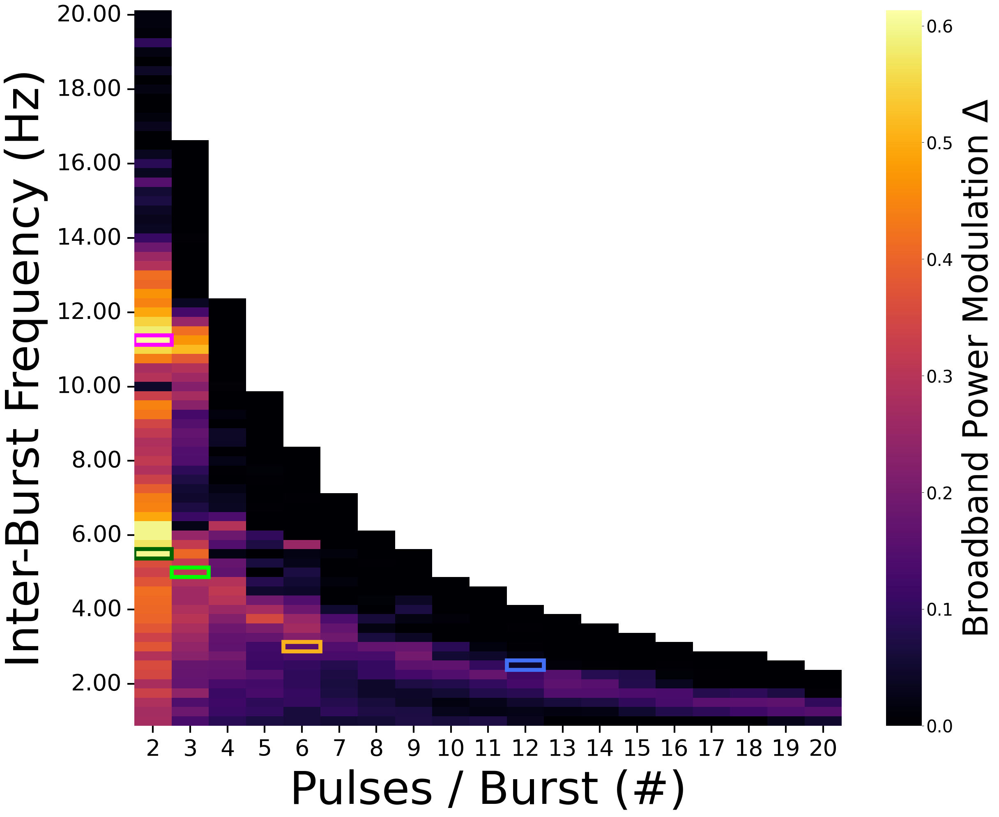

In [22]:
fig, ax = plt.subplots(figsize=(25,20))

ax = sns.heatmap(sp.param_space(scaled_105['bursts_oscillation_600']['V_AUC_delta']), cmap = 'inferno', vmin = 0)
colorbar = ax.collections[0].colorbar
colorbar.set_label(r'Broadband Power Modulation $\Delta$', fontsize = 60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)

xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 21, 1)], fontsize = 40)

ytick_occurance = 8

yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels([format(i, '.2f') for i in np.arange(1, 20 + .25, .25)][::-ytick_occurance], fontsize = 40, rotation = 0)

ax.tick_params(axis='both', pad=10, length = 12, width=3.0)

rect_x = 0
rect_y = 48
rect_width = 5
rect_height = 17

# add physiological range rectangle
dashed_rect = patches.Rectangle(
    (rect_x, rect_y),
    rect_width,
    rect_height,
    linestyle='--',
    linewidth=8,
    edgecolor='white',  # Set the edge color
    facecolor='none', # Make the rectangle transparent inside
    alpha = .8,
)

# ax.add_patch(dashed_rect)

# Add conventional iTBS rectangle

# conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='black', facecolor='lime')
# ax.add_patch(conv_itbs)
conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='lime', facecolor='none')
ax.add_patch(conv_itbs)

optimal_itbs = patches.Rectangle((0, 58), 1, 1, linewidth=7, edgecolor='darkgreen', facecolor='none')
ax.add_patch(optimal_itbs)


two_eleven = patches.Rectangle((0, 35), 1, 1, linewidth=7, edgecolor='fuchsia', facecolor='none') # fuchsia
ax.add_patch(two_eleven)

six_three = patches.Rectangle((4, 68), 1, 1, linewidth=7, edgecolor='#fab11e', facecolor='none') # red
ax.add_patch(six_three)

twelve_twofive = patches.Rectangle((10, 70), 1, 1, linewidth=7, edgecolor='#426ff5', facecolor='none') # yellow
ax.add_patch(twelve_twofive)


ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad = 15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad = 15) 


    
plt.tight_layout()

In [ ]:
taus['bursts_oscillation_600_iaf=8.0']['V_AUC_delta'].isbetween()

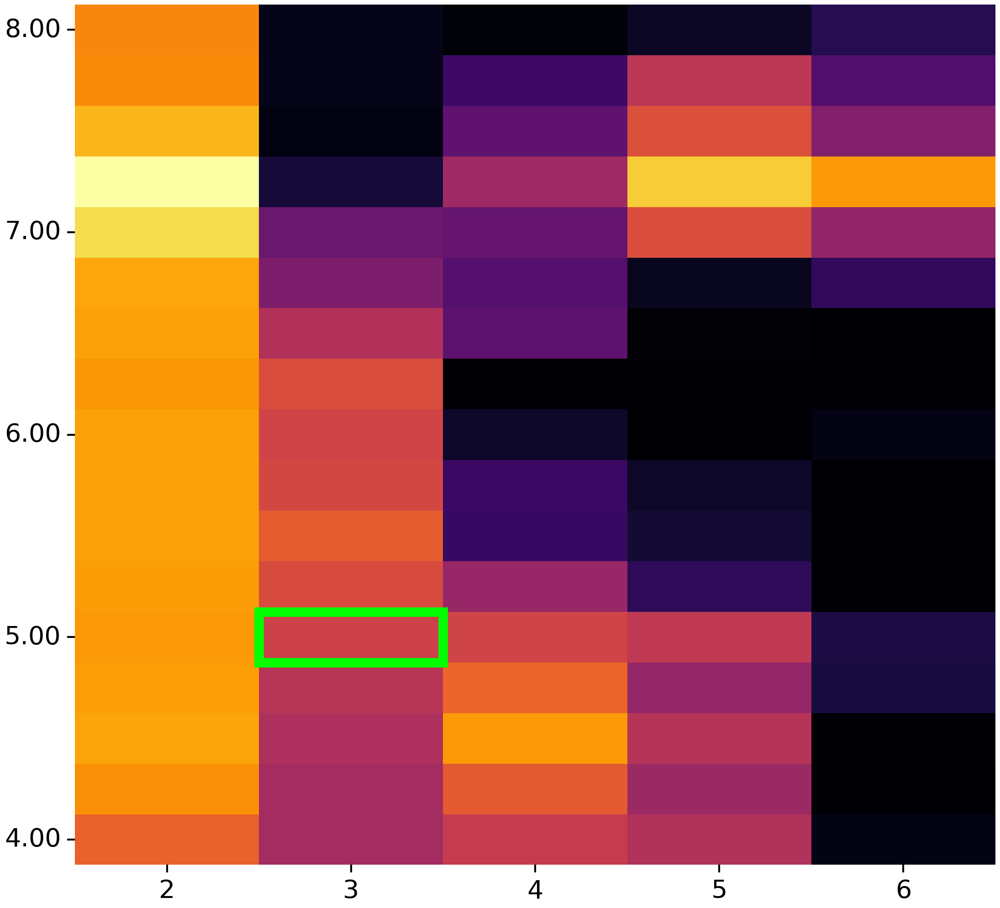

In [49]:
# Filter the DataFrame for PARAM_bur between 2-6 and PARAM_osc between 4-8
filtered_data = taus['bursts_oscillation_600_iaf=13.0'][
    (taus['bursts_oscillation_600_iaf=8.0']['PARAM_bur'] >= 2) & 
    (taus['bursts_oscillation_600_iaf=8.0']['PARAM_bur'] <= 6) &
    (taus['bursts_oscillation_600_iaf=8.0']['PARAM_osc'] >= 4) & 
    (taus['bursts_oscillation_600_iaf=8.0']['PARAM_osc'] <= 8)
]

# Generate the heatmap based on the filtered data
fig, ax = plt.subplots(figsize=(22, 20))

ax = sns.heatmap(
    sp.param_space(filtered_data['V_AUC_delta']), 
    cmap='inferno', 
    vmin=0,
    cbar = False
)

# colorbar = ax.collections[0].colorbar
# colorbar.set_label(r'Broadband Power Modulation $\Delta$', fontsize=60, labelpad=15)
# colorbar.ax.tick_params(labelsize=30)

xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 7, 1)], fontsize=40)  # Adjust the x-axis labels to reflect filtered data

ytick_occurance = 4
yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels(
    [format(i, '.2f') for i in np.arange(4, 8 + .25, .25)][::-ytick_occurance], 
    fontsize=40, rotation=0
)

ax.tick_params(axis='both', pad=10, length=12, width=3.0)

# Add your rectangles and other elements as before
conv_itbs = patches.Rectangle((1, 12), 1, 1, linewidth=15, edgecolor='lime', facecolor='none')
ax.add_patch(conv_itbs)

# optimal_itbs = patches.Rectangle((0, 10), 1, 1, linewidth=10, edgecolor='darkgreen', facecolor='none')
# ax.add_patch(optimal_itbs)

# two_eleven = patches.Rectangle((0, 35), 1, 1, linewidth=7, edgecolor='fuchsia', facecolor='none') 
# ax.add_patch(two_eleven)

# six_three = patches.Rectangle((4, 68), 1, 1, linewidth=7, edgecolor='#fab11e', facecolor='none') 
# ax.add_patch(six_three)

# twelve_twofive = patches.Rectangle((10, 70), 1, 1, linewidth=7, edgecolor='#426ff5', facecolor='none')
# ax.add_patch(twelve_twofive)

# Set x and y labels
ax.set_xlabel('', fontsize=80, labelpad=15) 
ax.set_ylabel('', fontsize=80, labelpad=15) 

plt.tight_layout()


-0.5620731020238697 1.2243234688716676e-19


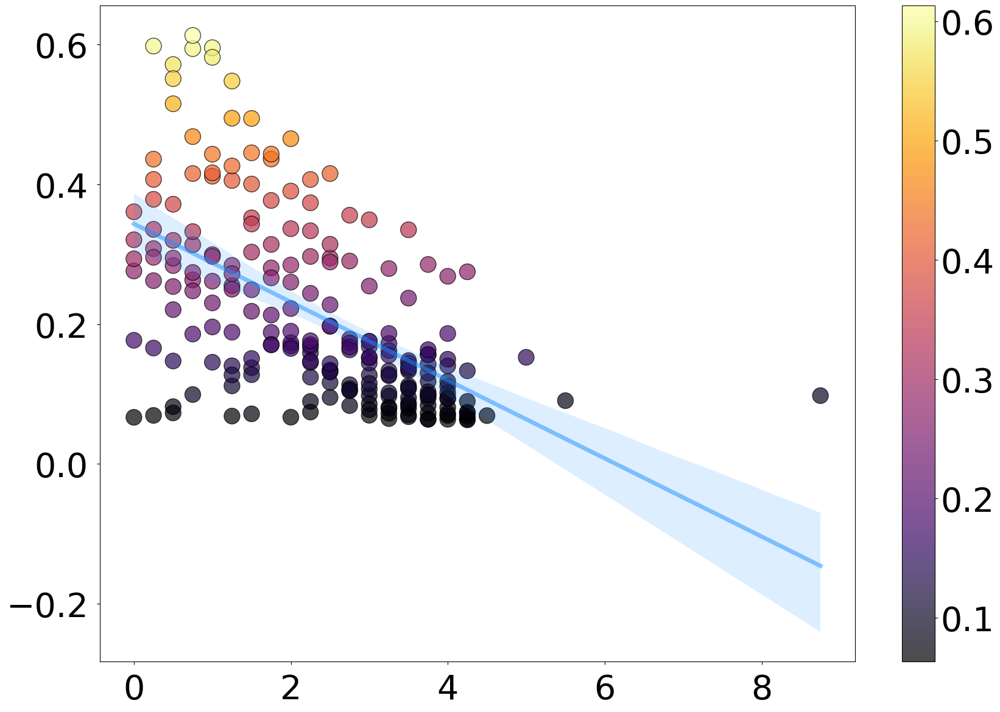

In [54]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['natural_freq_prox']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="inferno", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

-0.5351048231187582 1.2704547859493914e-17


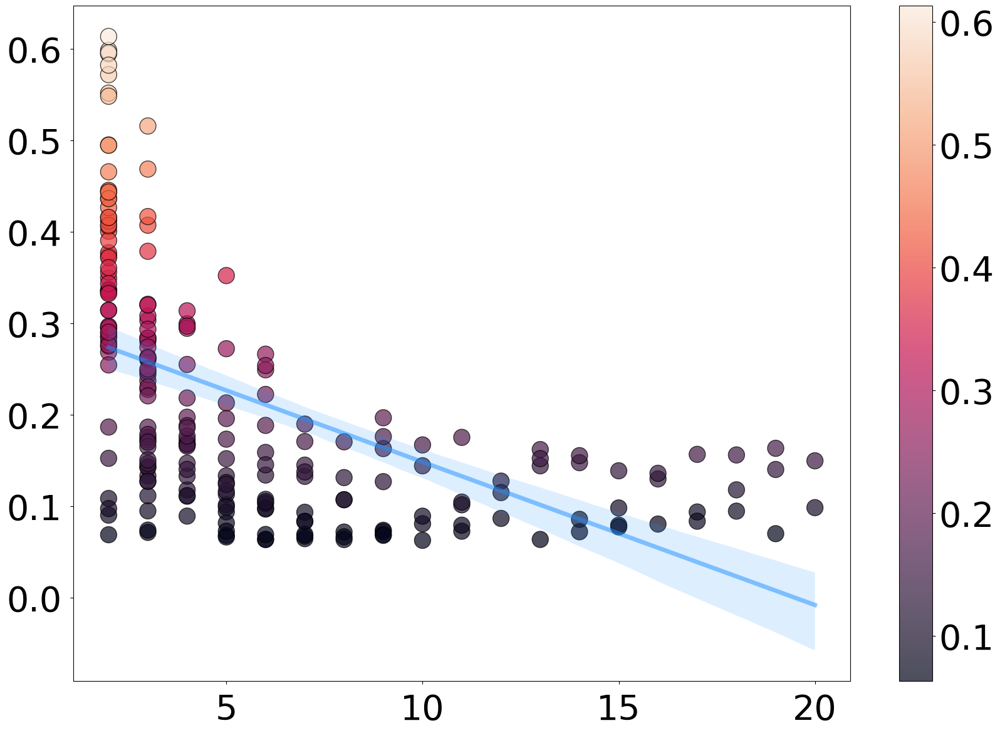

In [92]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_bur']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

0.46332520923920895 4.715139732939028e-13


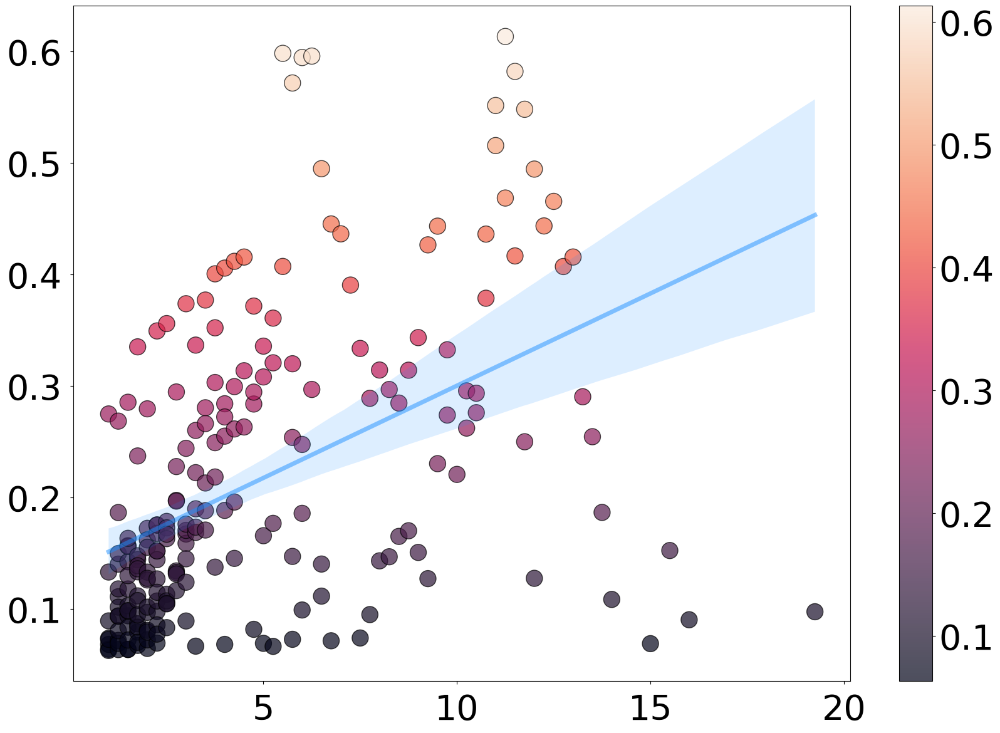

In [93]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_osc']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

-0.11551470091429486 0.08812132807403622


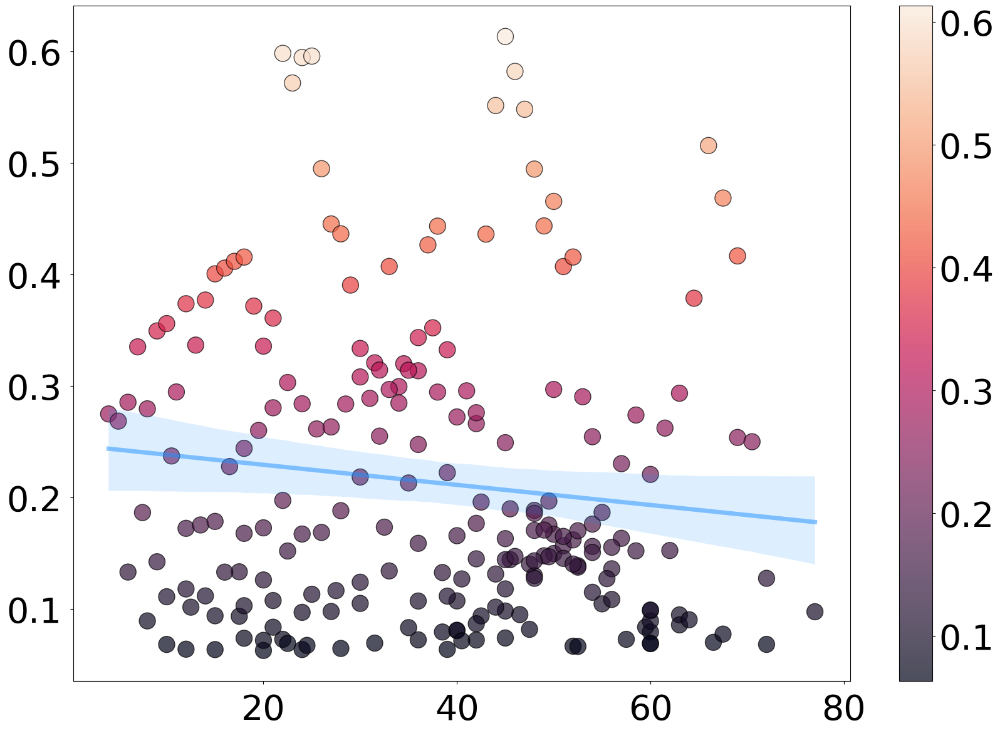

In [94]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

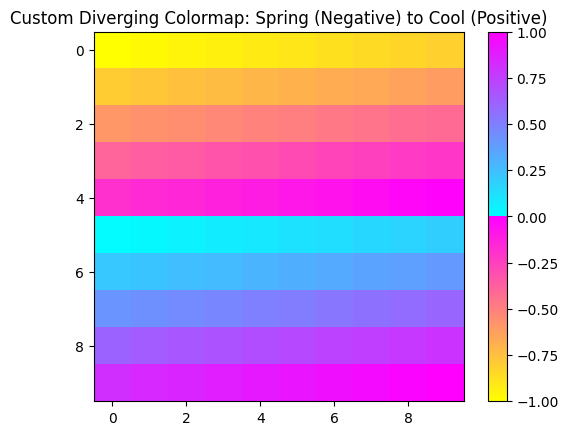

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Step 1: Extract the 'spring' colormap for negative values
spring_cmap = plt.get_cmap('spring')

# Step 2: Extract the 'cool' colormap for positive values
cool_cmap = plt.get_cmap('cool')

# Step 3: Define the number of segments for each side
n_segments = 256

# Step 4: Get color arrays from both colormaps
negative_colors = spring_cmap(np.linspace(1, 0, n_segments))  # Pink at negative, yellow near zero
positive_colors = cool_cmap(np.linspace(0, 1, n_segments))    # Blue near zero, purple at positive

# Step 5: Combine both arrays into a diverging colormap
combined_colors = np.vstack((negative_colors, positive_colors))
diverging_cmap = LinearSegmentedColormap.from_list('spring_cool_diverging', combined_colors)

# Step 6: Test the colormap by plotting a heatmap
data = np.linspace(-1, 1, 100).reshape(10, 10)  # Example data ranging from -1 to 1
plt.imshow(data, cmap=diverging_cmap)
plt.colorbar()
plt.title('Custom Diverging Colormap: Spring (Negative) to Cool (Positive)')
plt.show()


In [43]:
sp.param_space(scaled_syn_change_full.mean(axis=1))

Pulses / Burst,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,15.0,16.0,17.0,18.0,19.0,20.0
Inter-Burst Frequency (Hz),,,,,,,,,,,,,,,,,,,
20.00,-0.000083,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19.75,-0.000066,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19.50,-0.000069,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19.25,-0.000055,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19.00,-0.000052,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2.00,0.000450,0.000621,0.000820,0.000919,0.000914,0.000879,0.000846,0.000736,0.000584,0.000465,0.000334,0.000173,-0.000007,-0.000195,-0.000186,-0.000162,-0.000068,-0.000016,-0.000004
1.75,0.000426,0.000606,0.000749,0.000888,0.000901,0.000919,0.000948,0.000874,0.000783,0.000666,0.000568,0.000484,0.000341,0.000190,0.000013,-0.000179,-0.000128,-0.000132,-0.000096
1.50,0.000429,0.000667,0.000609,0.000856,0.000872,0.000918,0.000976,0.000953,0.000924,0.000897,0.000806,0.000705,0.000612,0.000502,0.000372,0.000254,0.000111,-0.000056,-0.000106


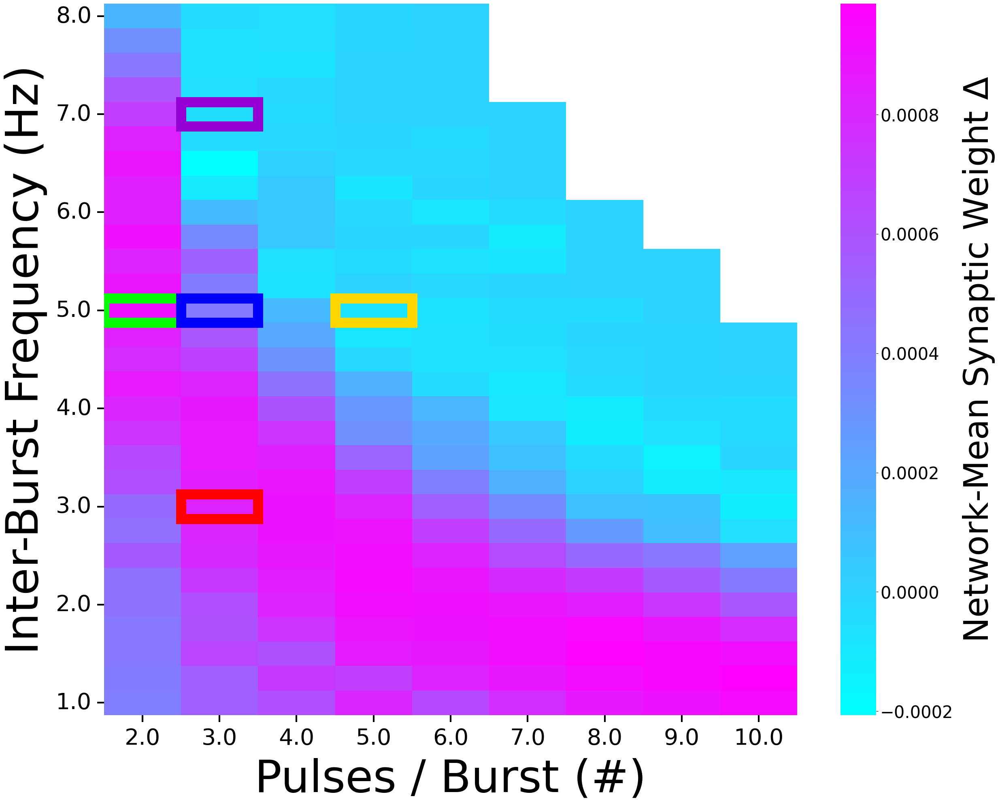

In [48]:
fig, ax = plt.subplots(figsize=(25,20))

# Get the heatmap data
heatmap_data = sp.param_space(scaled_syn_change_full.mean(axis=1))

# Truncate the DataFrame to only include frequencies up to 8 Hz and pulses up to 10
pulse_columns = [col for col in heatmap_data.columns if float(col) <= 10.0]
freq_rows = [row for row in heatmap_data.index if float(row) <= 8.0]

# Extract the relevant subset
truncated_data = heatmap_data.loc[freq_rows, pulse_columns]

# Reorder the data to have increasing frequency (1.0 to 8.0 from bottom to top)
truncated_data = truncated_data.sort_index()

# Flip the data vertically to correct the orientation
truncated_data = truncated_data.iloc[::-1]

# Create the heatmap with the truncated and reordered data
ax = sns.heatmap(truncated_data, cmap='cool')

colorbar = ax.collections[0].colorbar
colorbar.set_label(r'Network-Mean Synaptic Weight $\Delta$', fontsize=60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)

# Set tick parameters
ax.tick_params(axis='both', pad=10, length=12, width=3.0)

# Set x-axis labels - using the actual column names
ax.set_xticklabels(pulse_columns, fontsize=40)

# Set y-axis labels - using the actual row names but in reverse order due to the flip
freq_labels = list(truncated_data.index)  # These are now in reversed order
ytick_indices = np.linspace(0, len(freq_labels)-1, 8, dtype=int)
ytick_labels = [freq_labels[i] for i in ytick_indices]
ax.set_yticks(ytick_indices + 0.5)  # Add 0.5 to center the ticks on their squares
ax.set_yticklabels(ytick_labels, fontsize=40, rotation=0)

# Do the same for x-axis to ensure consistency
ax.set_xticks(np.arange(len(pulse_columns)) + 0.5)  # Center x-ticks on squares

# Determine rectangle positions based on the flipped indices
# Map the values to indices in the truncated dataframe
def get_index(value, labels):
    try:
        return labels.index(str(value))
    except ValueError:
        # Find the closest value
        return min(range(len(labels)), key=lambda i: abs(float(labels[i]) - value))

# Calculate positions for rectangles
# Need to adjust for the vertical flip
def find_freq_index(freq_value):
    original_idx = get_index(freq_value, list(truncated_data.index))
    return original_idx  # Already in the correct orientation now

# 2 x 5 Hz - Green 
two_idx = get_index(2.0, pulse_columns)
five_idx = find_freq_index(5.0)
two_five = patches.Rectangle((two_idx, five_idx), 1, 1, linewidth=18, edgecolor='lime', facecolor='none')
ax.add_patch(two_five)

# 3 x 3 Hz - Red
three_idx = get_index(3.0, pulse_columns)
three_hz_idx = find_freq_index(3.0)
three_three = patches.Rectangle((three_idx, three_hz_idx), 1, 1, linewidth=18, edgecolor='red', facecolor='none')
ax.add_patch(three_three)

# 3 x 7 Hz - Purple
seven_idx = find_freq_index(7.0)
three_seven = patches.Rectangle((three_idx, seven_idx), 1, 1, linewidth=18, edgecolor='darkviolet', facecolor='none')
ax.add_patch(three_seven)

# 5 x 5 Hz - Gold
five_pulse_idx = get_index(5.0, pulse_columns)
five_five = patches.Rectangle((five_pulse_idx, five_idx), 1, 1, linewidth=18, edgecolor='gold', facecolor='none')
ax.add_patch(five_five)

# 3 pulses per burst x 5 Hz - Blue
three_five = patches.Rectangle((three_idx, five_idx), 1, 1, linewidth=18, edgecolor='blue', facecolor='none')
ax.add_patch(three_five)

ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad=15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad=15) 

plt.tight_layout()

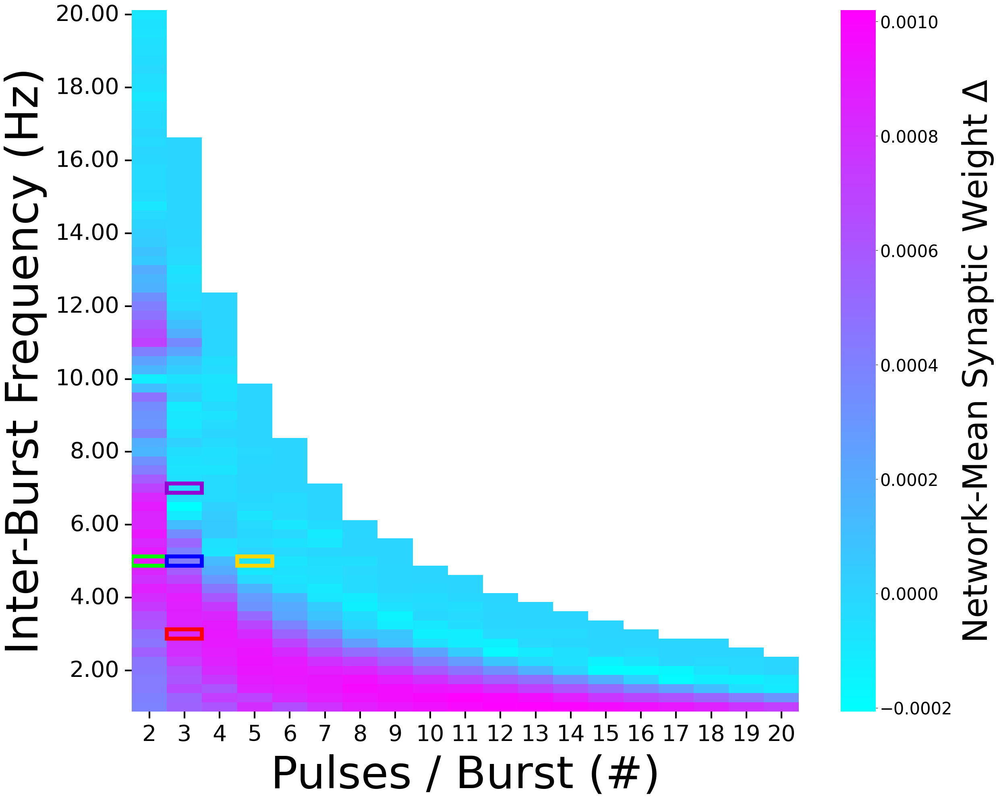

In [40]:
fig, ax = plt.subplots(figsize=(25,20))
ax = sns.heatmap(sp.param_space(scaled_syn_change_full.mean(axis=1)), cmap = 'cool')
colorbar = ax.collections[0].colorbar
colorbar.set_label(r'Network-Mean Synaptic Weight $\Delta$', fontsize = 60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)
xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 21, 1)], fontsize = 40)
ytick_occurance = 8
yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels([format(i, '.2f') for i in np.arange(1, 20 + .25, .25)][::-ytick_occurance], fontsize = 40, rotation = 0)
ax.tick_params(axis='both', pad=10, length = 12, width=3.0)
rect_x = 0
rect_y = 48
rect_width = 5
rect_height = 17
# add physiological range rectangle
dashed_rect = patches.Rectangle(
    (rect_x, rect_y),
    rect_width,
    rect_height,
    linestyle='--',
    linewidth=8,
    edgecolor='white',  # Set the edge color
    facecolor='none', # Make the rectangle transparent inside
    alpha = .8,
)
# ax.add_patch(dashed_rect)

# Updated boxes with the specified colors:

# 2 x 5 Hz - Green 
two_five = patches.Rectangle((0, 60), 1, 1, linewidth=7, edgecolor='lime', facecolor='none')
ax.add_patch(two_five)

# 3 x 3 Hz - Red
three_three = patches.Rectangle((1, 68), 1, 1, linewidth=7, edgecolor='red', facecolor='none')
ax.add_patch(three_three)

# 3 x 7 Hz - Purple
three_seven = patches.Rectangle((1, 52), 1, 1, linewidth=7, edgecolor='darkviolet', facecolor='none')
ax.add_patch(three_seven)

# 5 x 5 Hz - Gold
five_five = patches.Rectangle((3, 60), 1, 1, linewidth=7, edgecolor='gold', facecolor='none')
ax.add_patch(five_five)

# 3 pulses per burst x 5 Hz - Blue
three_five = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='blue', facecolor='none')
ax.add_patch(three_five)

ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad = 15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad = 15) 
    
plt.tight_layout()

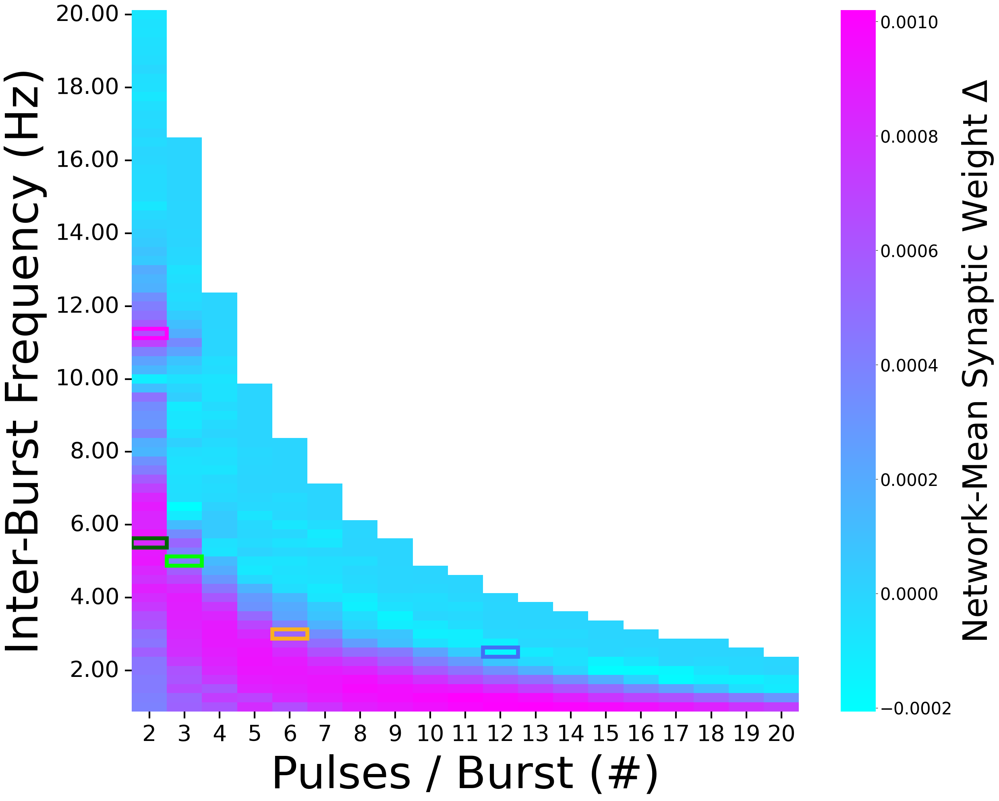

In [15]:
fig, ax = plt.subplots(figsize=(25,20))

ax = sns.heatmap(sp.param_space(scaled_syn_change_full.mean(axis=1)), cmap = 'cool')
colorbar = ax.collections[0].colorbar
colorbar.set_label(r'Network-Mean Synaptic Weight $\Delta$', fontsize = 60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)

xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 21, 1)], fontsize = 40)

ytick_occurance = 8

yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels([format(i, '.2f') for i in np.arange(1, 20 + .25, .25)][::-ytick_occurance], fontsize = 40, rotation = 0)

ax.tick_params(axis='both', pad=10, length = 12, width=3.0)

rect_x = 0
rect_y = 48
rect_width = 5
rect_height = 17

# add physiological range rectangle
dashed_rect = patches.Rectangle(
    (rect_x, rect_y),
    rect_width,
    rect_height,
    linestyle='--',
    linewidth=8,
    edgecolor='white',  # Set the edge color
    facecolor='none', # Make the rectangle transparent inside
    alpha = .8,
)

# ax.add_patch(dashed_rect)

# Add conventional iTBS rectangle

# conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='black', facecolor='lime')
# ax.add_patch(conv_itbs)
conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=7, edgecolor='lime', facecolor='none')
ax.add_patch(conv_itbs)

optimal_itbs = patches.Rectangle((0, 58), 1, 1, linewidth=7, edgecolor='darkgreen', facecolor='none')
ax.add_patch(optimal_itbs)


two_eleven = patches.Rectangle((0, 35), 1, 1, linewidth=7, edgecolor='fuchsia', facecolor='none') # fuchsia
ax.add_patch(two_eleven)

six_three = patches.Rectangle((4, 68), 1, 1, linewidth=7, edgecolor='#fab11e', facecolor='none') # red
ax.add_patch(six_three)

twelve_twofive = patches.Rectangle((10, 70), 1, 1, linewidth=7, edgecolor='#426ff5', facecolor='none') # yellow
ax.add_patch(twelve_twofive)


ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad = 15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad = 15) 


    
plt.tight_layout()

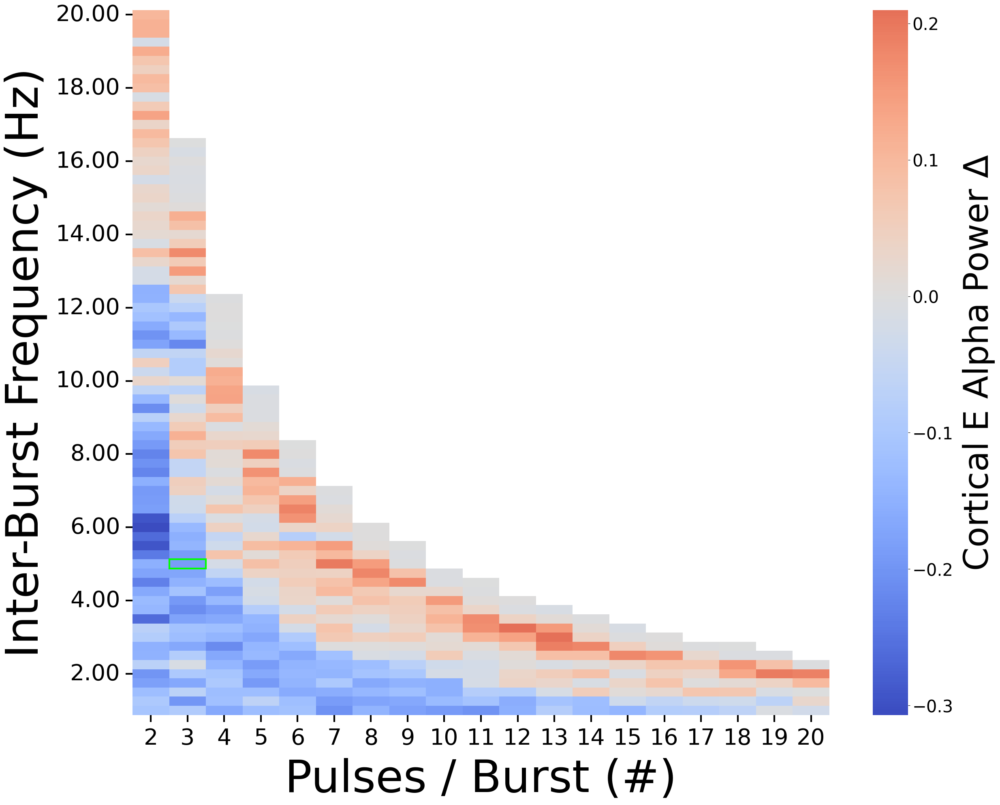

In [35]:
fig, ax = plt.subplots(figsize=(25,20))

ax = sns.heatmap(sp.param_space(scaled_105['bursts_oscillation_600']['alpha_PW_delta']), cmap = 'coolwarm', center = 0)
colorbar = ax.collections[0].colorbar
colorbar.set_label(r'Cortical E Alpha Power $\Delta$', fontsize = 60, labelpad=15)
colorbar.ax.tick_params(labelsize=30)

xticks = ax.get_xticks()
ax.set_xticks(xticks)
ax.set_xticklabels([i for i in range(2, 21, 1)], fontsize = 40)

ytick_occurance = 8

yticks = ax.get_yticks()
ax.set_yticks(yticks[::ytick_occurance])
ax.set_yticklabels([format(i, '.2f') for i in np.arange(1, 20 + .25, .25)][::-ytick_occurance], fontsize = 40, rotation = 0)

ax.tick_params(axis='both', pad=10, length = 12, width=3.0)

rect_x = 0
rect_y = 48
rect_width = 5
rect_height = 17

# add physiological range rectangle
dashed_rect = patches.Rectangle(
    (rect_x, rect_y),
    rect_width,
    rect_height,
    linestyle='--',
    linewidth=8,
    edgecolor='white',  # Set the edge color
    facecolor='none', # Make the rectangle transparent inside
    alpha = .8,
)

conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=3, edgecolor='lime', facecolor='none')
ax.add_patch(conv_itbs)


ax.set_xlabel('Pulses / Burst (#)', fontsize=80, labelpad = 15) 
ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=80, labelpad = 15) 


    
plt.tight_layout()

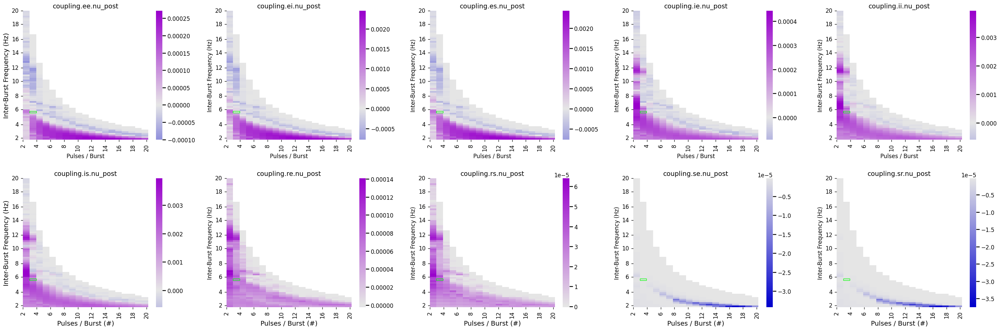

In [76]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap

# Create a bidirectional colormap (purple for positive, blue for negative, white-grey for zero)
colors = [(0, 0, 0.8), (0.9, 0.9, 0.9), (0.6, 0, 0.8)]  # blue, light grey, purple
cmap_bidir = LinearSegmentedColormap.from_list('blue_white_purple', colors, N=256)

# Calculate grid dimensions based on number of columns
num_cols = len(scaled_syn_change_full.columns)
nrows = (num_cols + 4) // 5  # Ceiling division to determine number of rows needed
ncols = min(5, num_cols)     # Use 5 columns or fewer if not enough data

# Create subplot grid
fig, axes = plt.subplots(nrows, ncols, figsize=(30, nrows * 5))
axes = axes.flatten() if nrows > 1 or ncols > 1 else [axes]  # Handle case of only 1 subplot

# Define explicit tick values we want to show
x_tick_values = np.arange(2, 21, 2)  # [2, 4, 6, 8, 10, 12, 14, 16, 18, 20]
y_tick_values = np.arange(2, 21, 2)  # [2, 4, 6, 8, 10, 12, 14, 16, 18, 20]

# Plot each column in a separate subplot
for i, column in enumerate(scaled_syn_change_full.columns):
    if i < len(axes):  # Ensure we don't exceed the number of created subplots
        ax = axes[i]
        data = sp.param_space(scaled_syn_change_full[column])
        heatmap = sns.heatmap(data, 
                             cmap=cmap_bidir, 
                             center=0,  # Center the colormap at 0
                             ax=ax)
        
        # Get dimensions of the heatmap
        data_height, data_width = data.shape
        
        # Account for different x-axis resolution (0.25 as you mentioned)
        x_resolution = 0.25
        x_range = np.arange(2, 20 + x_resolution, x_resolution)  # Full range with resolution 0.25
        
        # Calculate positions for our desired tick values in the x_range
        x_positions = []
        for val in x_tick_values:
            # Find the closest index in x_range to our desired value
            idx = np.abs(x_range - val).argmin()
            # Map this to the appropriate position in the heatmap width
            pos = idx * data_width / len(x_range)
            x_positions.append(pos)
        
        # Calculate y-tick positions (simple linear mapping from 2-20 to the plot height)
        y_range = np.linspace(2, 20, data_height)
        y_positions = []
        for val in y_tick_values:
            idx = np.abs(y_range - val).argmin()
            pos = idx
            y_positions.append(pos)
        
        # Set x-ticks
        ax.set_xticks(x_positions)
        ax.set_xticklabels(x_tick_values, fontsize=12)
        
        # Set y-ticks (reversed for bottom-to-top)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(y_tick_values[::-1], fontsize=12, rotation=0)
        
        # Add conventional iTBS indicator
        conv_itbs = patches.Rectangle((1, 60), 1, 1, linewidth=1, edgecolor='lime', facecolor='none')
        ax.add_patch(conv_itbs)
        
        # Set titles for each subplot
        ax.set_title(column, fontsize=14)
        
        # Only add x and y labels to the bottom and left subplots
        if i >= len(axes) - ncols:  # Bottom row
            ax.set_xlabel('Pulses / Burst (#)', fontsize=14)
        if i % ncols == 0:  # Left column
            ax.set_ylabel('Inter-Burst Frequency (Hz)', fontsize=14)
            
        ax.tick_params(axis='both', pad=5, length=4, width=1.0)

# Hide any unused subplots
for i in range(num_cols, len(axes)):
    axes[i].set_visible(False)

plt.tight_layout()
plt.subplots_adjust(wspace=0.3, hspace=0.3)  # Add space between subplots

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


0.15826798878040513 0.019101781391784554


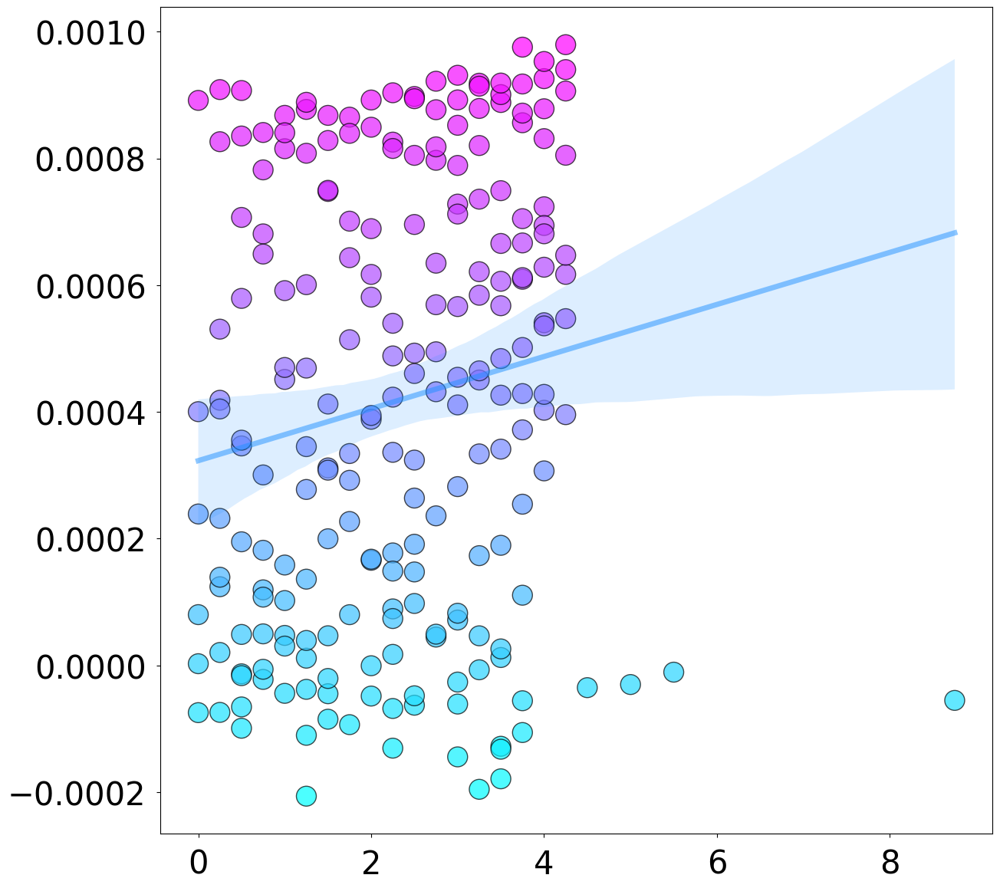

In [42]:
fig, ax = plt.subplots(figsize=(14, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['natural_freq_prox']
y = scaled_syn_change.mean(axis=1)
color_variable = scaled_syn_change.mean(axis=1)


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
# cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=30)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.16433154023609356 0.014910677304351687


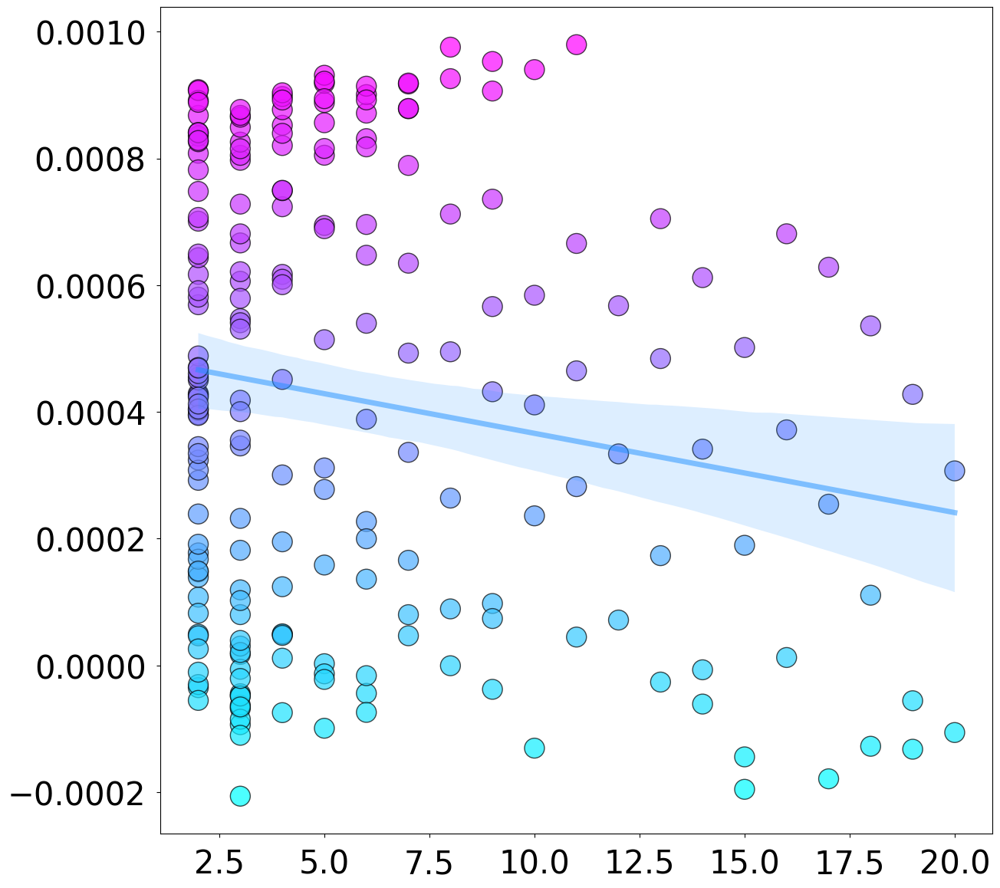

In [44]:
fig, ax = plt.subplots(figsize=(14, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_bur']
y = scaled_syn_change.mean(axis=1)
color_variable = scaled_syn_change.mean(axis=1)


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
# cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=30)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.4203653306760265 8.678410280625904e-11


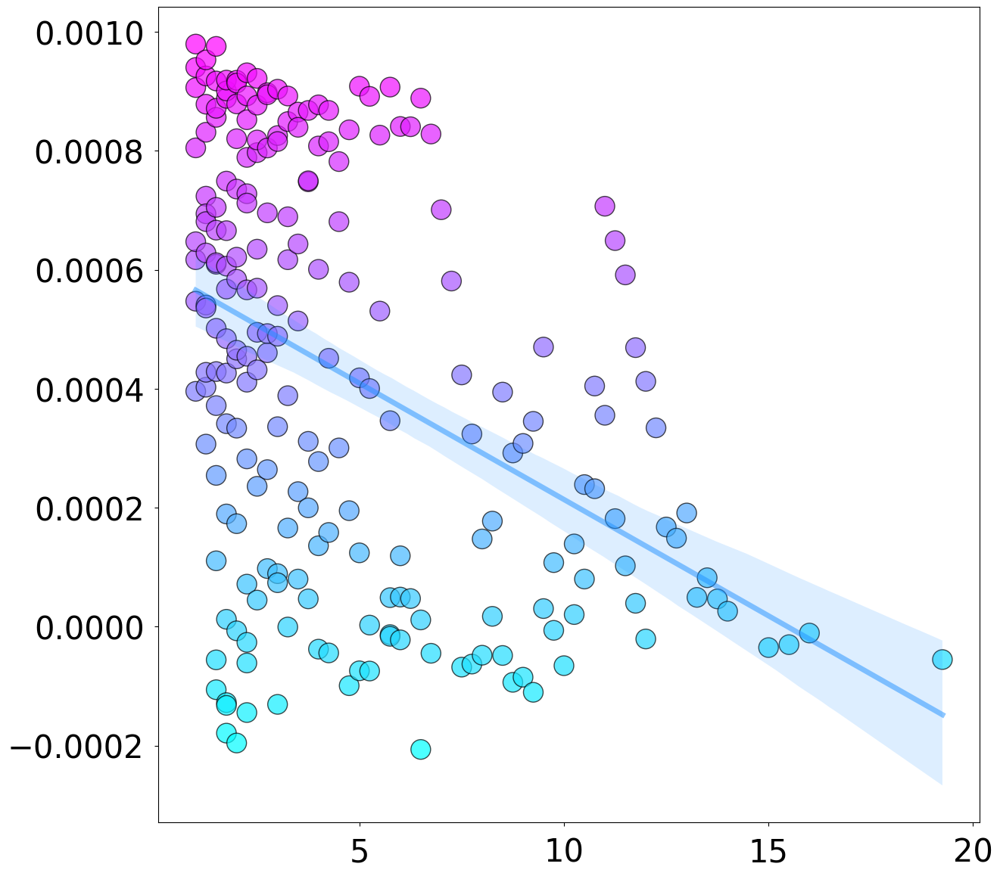

In [45]:
fig, ax = plt.subplots(figsize=(14, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_osc']
y = scaled_syn_change.mean(axis=1)
color_variable = scaled_syn_change.mean(axis=1)


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
# cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=30)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

-0.6219454627808991 7.761747211651138e-25


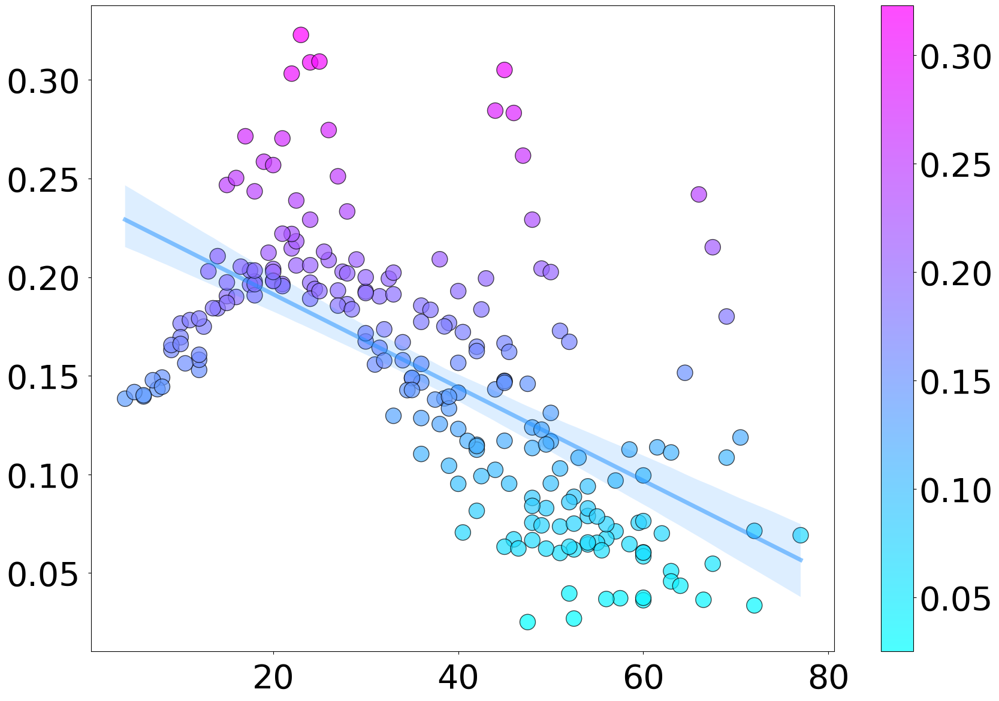

In [338]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = data['mean_synaptic_weight_delta'] # non normalized
color_variable = data['mean_synaptic_weight_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.7854502332805994 4.1907546094790224e-47


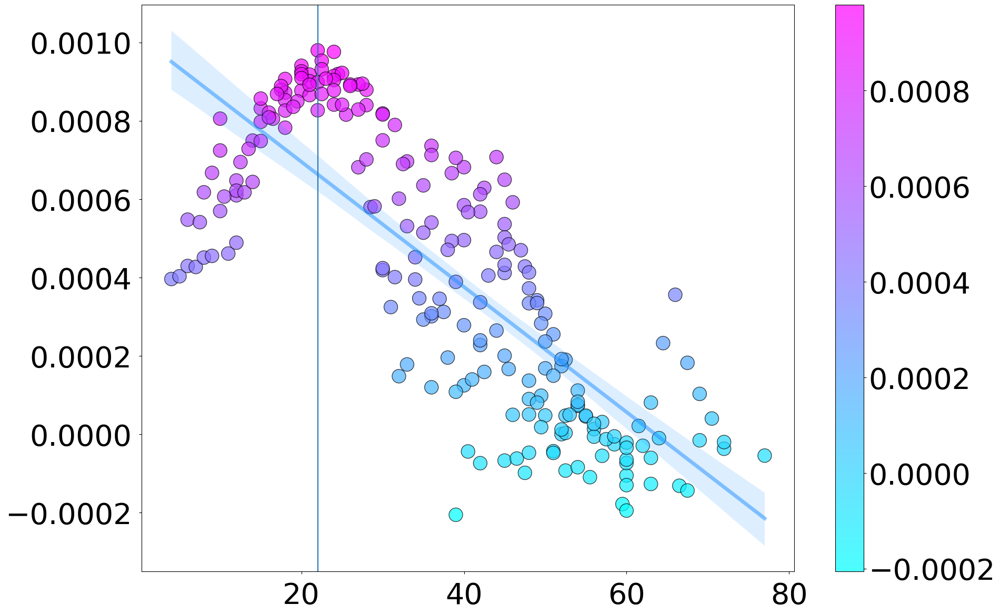

In [38]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = scaled_syn_change.mean(axis=1)
color_variable = scaled_syn_change.mean(axis=1)


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })


plt.axvline(22)

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

21.11944493428102


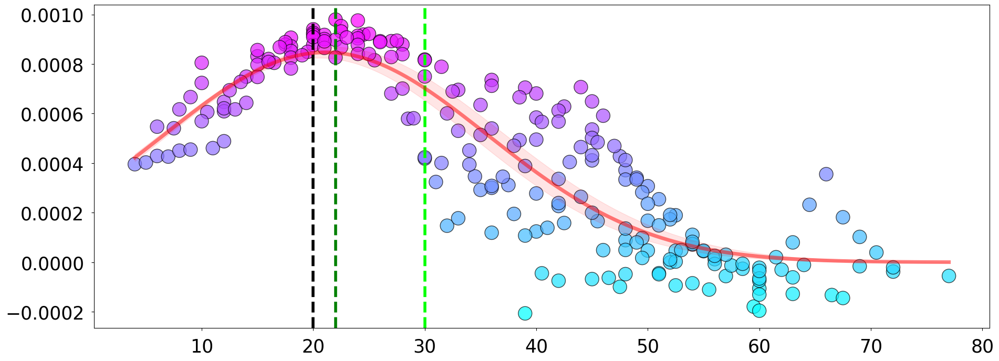

In [401]:
from scipy.optimize import curve_fit

# Define Gaussian function
def gaussian(x, amp, mean, stddev):
    return amp * np.exp(-((x - mean) ** 2) / (2 * stddev ** 2))

fig, ax = plt.subplots(figsize=(22, 8))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = scaled_syn_change.mean(axis=1)
color_variable = scaled_syn_change.mean(axis=1)

# Scatter plot
points = ax.scatter(x, y, c=color_variable, s=350, cmap="cool", alpha=.7, edgecolor='black')

# ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'red', 
#                                                            'linewidth' : 5,
#                                                            'alpha' : .5 })

# Fit Gaussian curve
popt, pcov = curve_fit(gaussian, x, y, p0=[1, np.mean(x), np.std(x)])

# Extract standard deviations of the parameters
perr = np.sqrt(np.diag(pcov))

# Generate fit data
x_fit = np.linspace(min(x), max(x), 1000)
y_fit = gaussian(x_fit, *popt)

# Generate upper and lower bounds
y_upper = gaussian(x_fit, *(popt + perr))
y_lower = gaussian(x_fit, *(popt - perr))

# Add dashed center line at the mean
center_point = popt[1]
ax.axvline(x=20, color='black', linestyle='--', linewidth=4, label='HF-rTMS')
ax.axvline(x=3*5*2, color='lime', linestyle='--', linewidth=4, label='Standard iTBS')
ax.axvline(x=2*5.5*2, color='green', linestyle='--', linewidth=4, label='Optimal Protocol')


# Plot Gaussian fit
ax.plot(x_fit, y_fit, color='red', linewidth=5, alpha=.5, label='Gaussian fit')

# Plot confidence interval
ax.fill_between(x_fit, y_lower, y_upper, color='red', alpha=0.1, label='Confidence interval')


print(center_point)

# Customize plot
ax.tick_params(axis='both', pad=10, labelsize=25)


plt.show()


/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


0.12765517600891002 0.059290046452599825


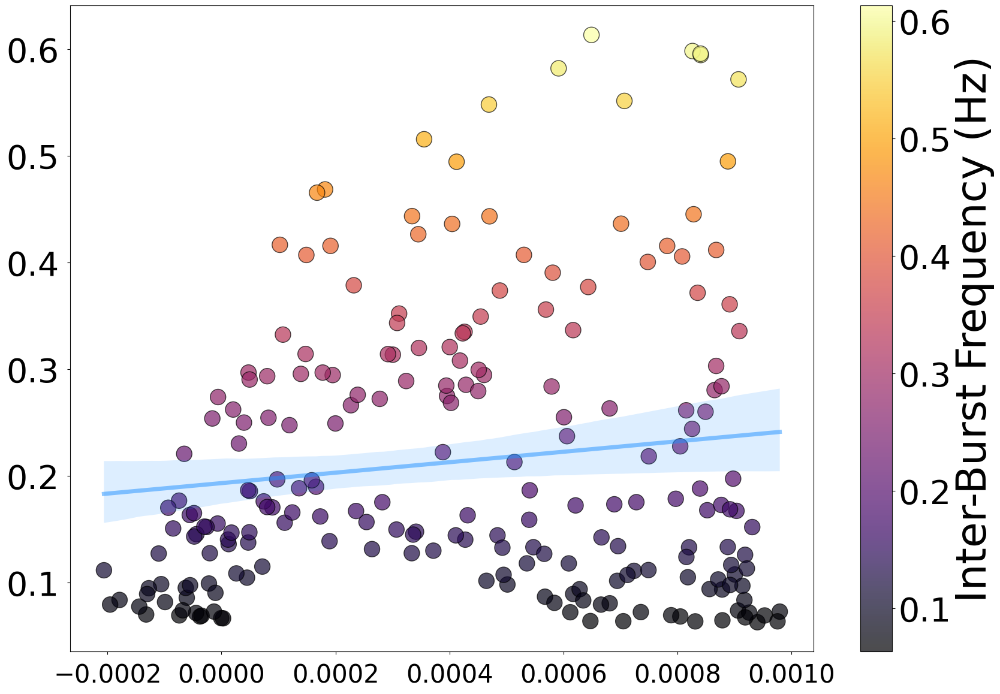

In [63]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['mean_synaptic_weight_delta']
x = scaled_syn_change.mean(axis=1)
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap='inferno', alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{x:}'))

cbar = plt.colorbar(points)
cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='y', pad=10, labelsize=40)
ax.tick_params(axis='x', pad=10, labelsize=30)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


0.12765517600891002 0.059290046452599825


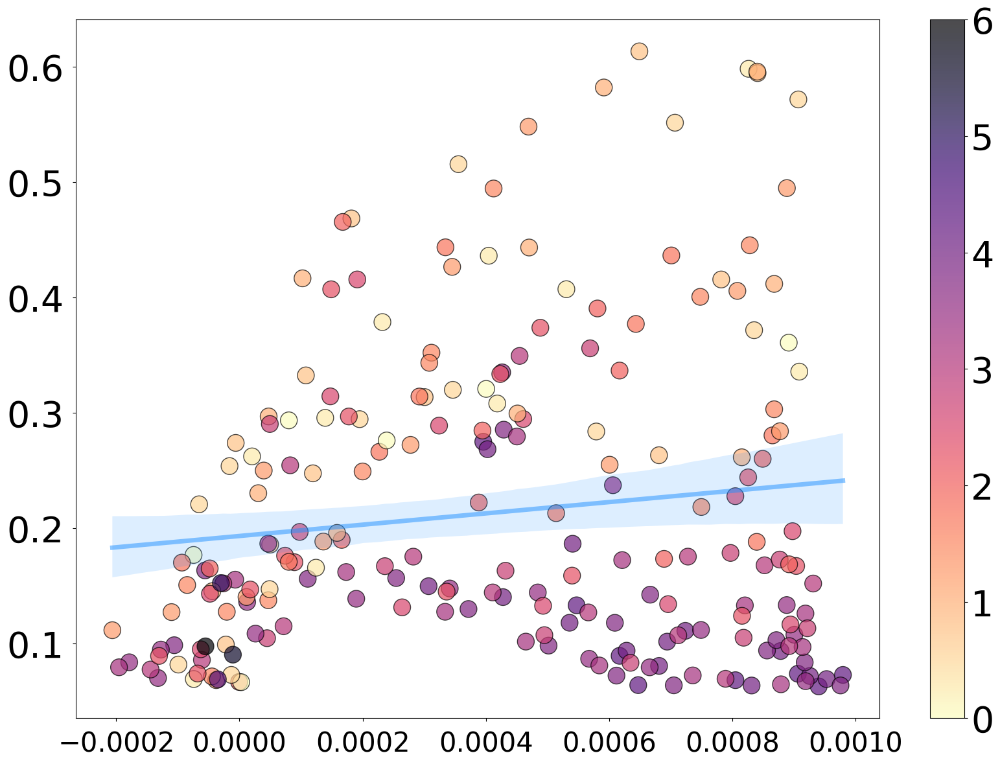

In [414]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = data['mean_synaptic_weight_delta']
x = scaled_syn_change.mean(axis=1)
y = data['V_AUC_delta']
color_variable = data['natural_freq_prox']


points = ax.scatter(x, y,c=color_variable, s=350, cmap='magma_r', alpha = .7, edgecolor = 'black', vmax = 6)

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{x:}'))

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='y', pad=10, labelsize=40)
ax.tick_params(axis='x', pad=10, labelsize=30)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

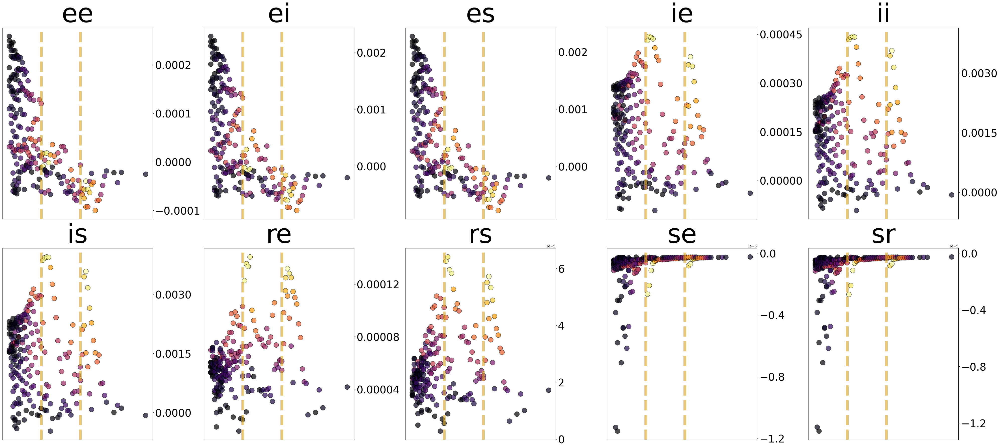

In [66]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

pre_stim_nus = {'ee' : 0.001200,
                'ei' : -0.009839,
                'es' : 0.009732,
                'ie' : 0.001532,
                'ii' : -0.009639,
                'is' : 0.009732,
                're' : 0.000143,
                'rs' : 0.000058,
                'se' : 0.001135,
                'sr' : -0.001222}


# Create a 2x5 subplot grid
fig, axes = plt.subplots(2, 5, figsize=(40, 18))

# Flatten the axes array to make indexing easier
axes = axes.flatten()

data = scaled_105['bursts_oscillation_600'].loc[subset]

# subset = (amp_105_limit['bursts_oscillation_600']['PARAM_bur'].between(2,21)) & (amp_105_limit['bursts_oscillation_600']['V_AUC_delta'] > .05)
x = data['PARAM_osc']
color_variable = data['V_AUC_delta']

dependent_variables = [c for c in data.columns if 'post' in c and c not in ['coupling.ex.nu_post', 'coupling.sn.nu_post']]
for i, y_variable in enumerate(dependent_variables):
    # Select the y variable
    working_nu = y_variable.split(".")[1]
    
    y = scaled_syn_change[y_variable]
    
    # Create a scatter plot
    axes[i].axvline(10.5, c = 'goldenrod', linestyle = '--', alpha = .6, linewidth = 8)
    axes[i].axvline(10.5/2, c = 'goldenrod', linestyle = '--', alpha = .6, linewidth = 8)
    
    scatter = axes[i].scatter(x, y, alpha=0.7, c=color_variable, cmap='inferno', edgecolors='black', s = 200)
#     axes[i].scatter(0, pre_stim_nus[str(working_nu)], s=1500, alpha = .8, c='#23ebe7', marker = 'X', edgecolors='black', linewidths=3)


    
    # Fit a regression line
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    regression_line = slope * x + intercept
    # axes[i].plot(x, regression_line, color='red')
    
    # Add title
    axes[i].set_title(f'{working_nu}', fontsize=75)
    
    # Adjust y-axis ticks
    axes[i].yaxis.set_major_locator(plt.MaxNLocator(4))  # Adjust the number of ticks
    axes[i].tick_params(axis='y', which='major', labelsize=30)  # Increase font size for y-axis ticks
    axes[i].yaxis.tick_right()
    
    # Remove x-axis ticks
    axes[i].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


In [82]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

IV = 'natural_freq_prox'  # Independent variable

scaled_syn_change.columns = scaled_syn_change.columns.str.replace('.', '_', regex=False)

# Concatenate the dependent variables (X, Y, Z) with the independent variable (natural_freq_prox)
MLR_df = pd.concat([scaled_syn_change, scaled_105['bursts_oscillation_600'][[IV]]], axis=1)

# Initialize dictionaries to store t-values and p-values
t_values = {}
p_values = {}

# Run the analysis for each dependent variable (X, Y, Z)
for DV in scaled_syn_change.columns:
    # Perform regression analysis
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    
    # Store t-values and p-values
    t_values[DV] = model.tvalues[IV]
    p_values[DV] = model.pvalues[IV]

# Convert p-values to a Series for multiple comparison corrections
p_values_series = pd.Series(p_values)

# Apply Bonferroni and FDR correction
_, corrected_p_values_bonferroni, _, _ = multipletests(p_values_series, method='bonferroni')
_, corrected_p_values_fdr, _, _ = multipletests(p_values_series, method='fdr_bh')

# Format and display results
for DV in scaled_syn_change.columns:
    formatted_t_p_value = (
        f"t = {t_values[DV]:.2f}, p = {p_values[DV]:.3f}" 
        if p_values[DV] >= (0.001 / len(p_values_series)) 
        else f"\\textbf{{t = {t_values[DV]:.2f}, p < 0.001}}"
    )
    
    # Display results
    print(f"\nResults for {DV}:\n")
    print(f"{DV} & {formatted_t_p_value}")


Results for coupling_ee_nu_post:

coupling_ee_nu_post & \textbf{t = 7.22, p < 0.001}

Results for coupling_ei_nu_post:

coupling_ei_nu_post & \textbf{t = 6.93, p < 0.001}

Results for coupling_es_nu_post:

coupling_es_nu_post & \textbf{t = 6.90, p < 0.001}

Results for coupling_ie_nu_post:

coupling_ie_nu_post & t = -0.55, p = 0.582

Results for coupling_ii_nu_post:

coupling_ii_nu_post & t = -1.44, p = 0.151

Results for coupling_is_nu_post:

coupling_is_nu_post & t = -1.43, p = 0.154

Results for coupling_re_nu_post:

coupling_re_nu_post & \textbf{t = -5.81, p < 0.001}

Results for coupling_rs_nu_post:

coupling_rs_nu_post & \textbf{t = -6.56, p < 0.001}

Results for coupling_se_nu_post:

coupling_se_nu_post & t = -2.70, p = 0.007

Results for coupling_sr_nu_post:

coupling_sr_nu_post & t = -2.71, p = 0.007


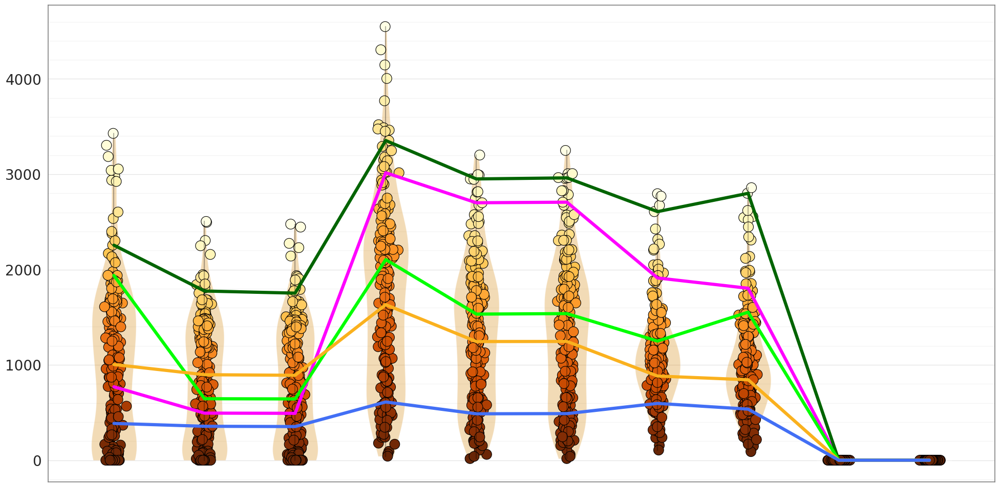

In [156]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.ticker as ticker

# Set up the figure for plotting
plt.figure(figsize=(20, 10))

# Prepare data for the violin plot
data_dict = {}
# Collect the data for each item
for j in scaled_ltps.columns:
    data = scaled_105['bursts_oscillation_600']['PARAM_osc'][subset], scaled_ltps[j]
    data_dict[j] = data

data_list = [data[1] for data in data_dict.values()]
positions = np.arange(1, len(data_list) + 1)

# Plot the violin plot
violin_plot = plt.violinplot(data_list, positions=positions, showmeans=False, showextrema=False)

# Iterate over the items and add scatter plot
for i, (item, data) in enumerate(data_dict.items()):
    # Scatter plot for the current item
    colors = [custom_color(val) for val in data[1]]
    plt.scatter(np.random.normal(i + 1, 0.04, size=len(data[1])), data[1], label=item, 
                c=data[1], s=200, edgecolor='black', linewidth=0.8, cmap='YlOrBr_r')
    # Plot a line connecting the scatter points
    plt.plot([i + 1] * len(data[1]), data[1], color='black', alpha=0.3)

for body in violin_plot['bodies']:
    body.set_facecolor('#d6890d')
    
protocol_colors = {
    'eirs-tms-custom_PERM_[bur=2.00_osc=11.00].output': 'fuchsia',
    'eirs-tms-custom_PERM_[bur=2.00_osc=5.50].output': 'darkgreen',
    'eirs-tms-custom_PERM_[bur=3.00_osc=5.00].output': 'lime',
    # 'eirs-tms-custom_PERM_[bur=3.00_osc=5.50].output': 'lightgreen',
    'eirs-tms-custom_PERM_[bur=6.00_osc=3.00].output': '#fab11e',
    'eirs-tms-custom_PERM_[bur=12.00_osc=2.25].output': '#426ff5'
}

for protocol, color in protocol_colors.items():
    protocol_x_values = []
    protocol_y_values = []
    
    for i, data in enumerate(data_dict.values()):
        if protocol in data[1].index:
            protocol_x_values.append(i + 1)
            protocol_y_values.append(data[1].loc[protocol])
    plt.plot(protocol_x_values, protocol_y_values, color=color, linewidth=4.5)

# Customize the plot
plt.title('', fontsize=16)
plt.grid(True)

# Improve tick readability
ax = plt.gca()

# Remove x-ticks and labels
plt.xticks([])
ax.xaxis.set_ticks_position('none')

# Y-axis improvements
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{x:.0f}'))
plt.yticks(fontsize=20)

# Add padding
plt.tight_layout(pad=2.0)

# Add more y-grid lines for better readability
ax.yaxis.set_major_locator(ticker.AutoLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)

# Add a light border to the plot
for spine in ax.spines.values():
    spine.set_linewidth(1.2)
    spine.set_color('gray')

plt.show()

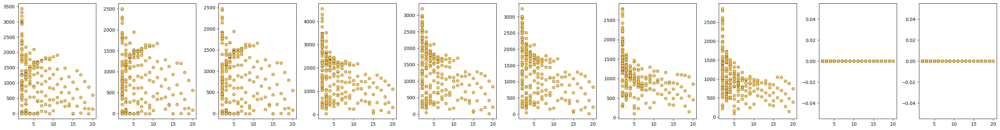

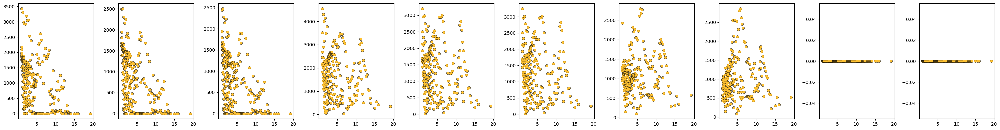

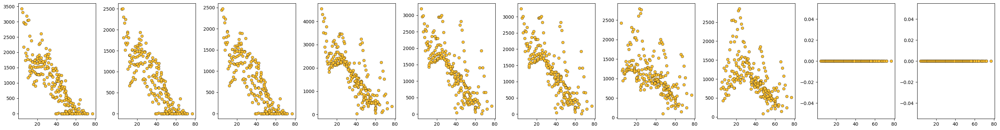

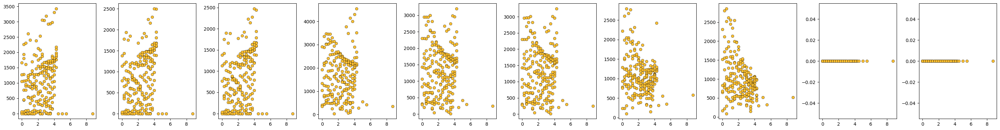

In [341]:
for iv in ['PARAM_bur', 'PARAM_osc', 'train_dose', 'natural_freq_prox']:
    fig, axes = plt.subplots(nrows=1, ncols=10, figsize=(30, 4), sharex=True)
    for i, col in enumerate(scaled_ltps.columns):
        axes[i].scatter(scaled_105['bursts_oscillation_600'].loc[subset][iv], 
                        scaled_ltps[col], c= '#ffc233', edgecolor = 'black', linewidth = .4)

#         print(i, np.corrcoef(xyz_gainer.loc[subset][iv], ltps[col])) 

    plt.tight_layout()
    plt.show()

In [75]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

DV = 'V_AUC_delta'  # Dependent variable

# Assume scaled_105['bursts_oscillation_600'] contains the DV (V_AUC_delta)
# Concatenate the LTP and LTD columns with the DV
MLR_df = pd.concat([scaled_105['bursts_oscillation_600'][[DV]], 
                    scaled_ltps.rename(columns=lambda x: f'ltp_{x}', inplace=False), 
                    scaled_ltds.rename(columns=lambda x: f'ltd_{x}', inplace=False)], axis=1)

# Identify the independent variables (LTP/LTD columns)
IVs = [col for col in MLR_df.columns if col.startswith(('ltp_', 'ltd_'))]
IVs = [iv for iv in IVs if MLR_df[iv].nunique() > 1]  # Filter out non-changing IVs

# Initialize dictionaries to store t-values and p-values
t_values = {}
p_values = {}

# Run the analysis for each independent variable (LTP/LTD)
for IV in IVs:
    # Perform regression analysis
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    
    # Store t-values and p-values
    t_values[IV] = model.tvalues[IV]
    p_values[IV] = model.pvalues[IV]

# Convert p-values to a Series for multiple comparison corrections
p_values_series = pd.Series(p_values)

# Apply Bonferroni and FDR corrections
_, corrected_p_values_bonferroni, _, _ = multipletests(p_values_series, method='bonferroni')
_, corrected_p_values_fdr, _, _ = multipletests(p_values_series, method='fdr_bh')

# Format t-values and p-values for LaTeX output
formatted_t_p_values = {
    iv: (
        f"t = {t_values[iv]:.2f}, p = {p_values[iv]:.3f}" 
        if p_values[iv] >= (0.001 / len(p_values_series)) 
        else f"\\textbf{{t = {t_values[iv]:.2f}, p < 0.001}}"
    )
    for iv in IVs
}

# Organize results into the desired LaTeX table format
latex_table_rows = [
    f"ee & {formatted_t_p_values.get('ltd_RAW_ee_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_ee_Ca', 'N/A')}",
    f"ei & {formatted_t_p_values.get('ltd_RAW_ei_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_ei_Ca', 'N/A')}",
    f"es & {formatted_t_p_values.get('ltd_RAW_es_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_es_Ca', 'N/A')}",
    f"ie & {formatted_t_p_values.get('ltd_RAW_ie_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_ie_Ca', 'N/A')}",
    f"ii & {formatted_t_p_values.get('ltd_RAW_ii_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_ii_Ca', 'N/A')}",
    f"is & {formatted_t_p_values.get('ltd_RAW_is_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_is_Ca', 'N/A')}",
    f"re & {formatted_t_p_values.get('ltd_RAW_re_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_re_Ca', 'N/A')}",
    f"rs & {formatted_t_p_values.get('ltd_RAW_rs_Ca', 'N/A')} & {formatted_t_p_values.get('ltp_RAW_rs_Ca', 'N/A')}",
    f"se & {formatted_t_p_values.get('ltd_RAW_se_Ca', 'N/A')} & N/A",
    f"sr & {formatted_t_p_values.get('ltd_RAW_sr_Ca', 'N/A')} & N/A",
]

# Join rows into a LaTeX table
latex_table = "\\begin{tabular}{|l|c|c|}\n\\hline\n\\textbf{Connection} & \\textbf{LTD} & \\textbf{LTP} \\\\\n\\hline\n"
latex_table += " \\\\\n".join(latex_table_rows)
latex_table += "\n\\hline\n\\end{tabular}"

print(latex_table)


\begin{tabular}{|l|c|c|}
\hline
\textbf{Connection} & \textbf{LTD} & \textbf{LTP} \\
\hline
ee & \textbf{t = 12.56, p < 0.001} & t = 2.85, p = 0.005 \\
ei & \textbf{t = 10.73, p < 0.001} & t = 0.47, p = 0.636 \\
es & \textbf{t = 10.64, p < 0.001} & t = 0.44, p = 0.660 \\
ie & t = 0.58, p = 0.564 & \textbf{t = 8.64, p < 0.001} \\
ii & t = 0.39, p = 0.693 & \textbf{t = 9.69, p < 0.001} \\
is & t = 0.40, p = 0.689 & \textbf{t = 9.69, p < 0.001} \\
re & t = 1.39, p = 0.167 & \textbf{t = 17.42, p < 0.001} \\
rs & t = 1.57, p = 0.118 & \textbf{t = 16.20, p < 0.001} \\
se & t = -2.21, p = 0.028 & N/A \\
sr & t = -2.21, p = 0.028 & N/A
\hline
\end{tabular}


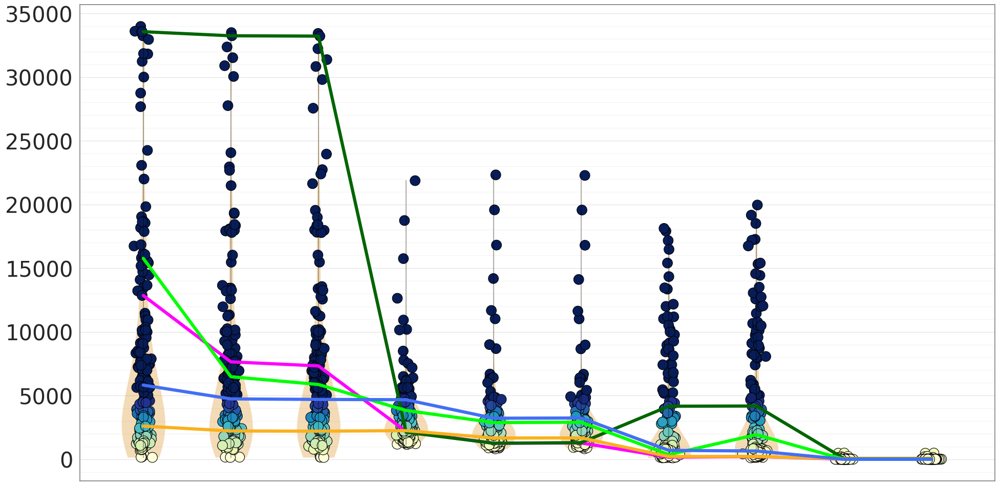

In [155]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.ticker as ticker

# Set up the figure for plotting
plt.figure(figsize=(20, 10))

# Prepare data for the violin plot
data_dict = {}
# Collect the data for each item
for j in scaled_ltps.columns:
    data = scaled_105['bursts_oscillation_600']['PARAM_osc'][subset], scaled_ltds[j]
    data_dict[j] = data

data_list = [data[1] for data in data_dict.values()]
positions = np.arange(1, len(data_list) + 1)

# Plot the violin plot
violin_plot = plt.violinplot(data_list, positions=positions, showmeans=False, showextrema=False)

# Iterate over the items and add scatter plot
for i, (item, data) in enumerate(data_dict.items()):
    # Scatter plot for the current item
    colors = [custom_color(val) for val in data[1]]
    plt.scatter(np.random.normal(i + 1, 0.04, size=len(data[1])), data[1], label=item, 
                c=data[1], s=200, edgecolor='black', linewidth=0.8, cmap='YlGnBu', vmax=5000)
    # Plot a line connecting the scatter points
    plt.plot([i + 1] * len(data[1]), data[1], color='black', alpha=0.3)

for body in violin_plot['bodies']:
    body.set_facecolor('#d6890d')
    
protocol_colors = {
    'eirs-tms-custom_PERM_[bur=2.00_osc=11.00].output': 'fuchsia',
    'eirs-tms-custom_PERM_[bur=2.00_osc=5.50].output': 'darkgreen',
    'eirs-tms-custom_PERM_[bur=3.00_osc=5.00].output': 'lime',
    # 'eirs-tms-custom_PERM_[bur=3.00_osc=5.50].output': 'lightgreen',
    'eirs-tms-custom_PERM_[bur=6.00_osc=3.00].output': '#fab11e',
    'eirs-tms-custom_PERM_[bur=12.00_osc=2.25].output': '#426ff5'
}

for protocol, color in protocol_colors.items():
    protocol_x_values = []
    protocol_y_values = []
    
    for i, data in enumerate(data_dict.values()):
        if protocol in data[1].index:
            protocol_x_values.append(i + 1)
            protocol_y_values.append(data[1].loc[protocol])
    plt.plot(protocol_x_values, protocol_y_values, color=color, linewidth=4.5)

# Customize the plot
plt.title('', fontsize=16)
plt.grid(True)

# Improve tick readability
ax = plt.gca()

# Remove x-ticks and labels
plt.xticks([])
ax.xaxis.set_ticks_position('none')

# Y-axis improvements
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{x:.0f}'))
plt.yticks(fontsize=20)

# Add padding
plt.tight_layout(pad=2.0)

# Add more y-grid lines for better readability
ax.yaxis.set_major_locator(ticker.AutoLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.grid(which='minor', alpha=0.2)
ax.grid(which='major', alpha=0.5)

# Add a light border to the plot
for spine in ax.spines.values():
    spine.set_linewidth(1.2)
    spine.set_color('gray')

plt.show()

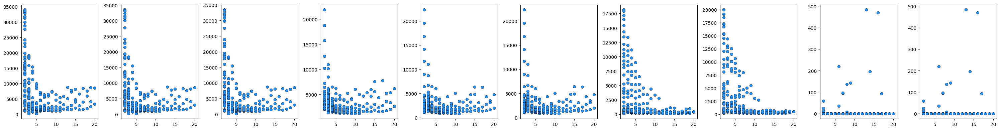

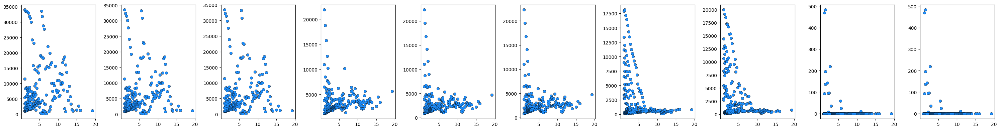

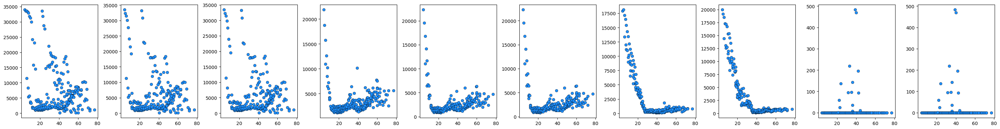

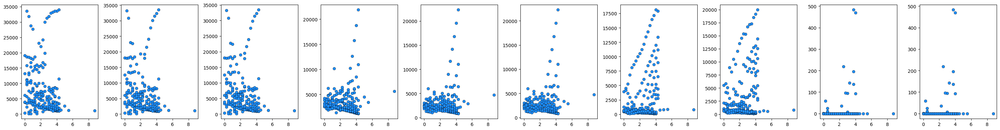

In [342]:
for iv in ['PARAM_bur', 'PARAM_osc', 'train_dose', 'natural_freq_prox']:
    fig, axes = plt.subplots(nrows=1, ncols=10, figsize=(30, 4), sharex=True)
    for i, col in enumerate(scaled_ltds.columns):
        axes[i].scatter(scaled_105['bursts_oscillation_600'].loc[subset][iv], 
                        scaled_ltds[col], c= 'dodgerblue', edgecolor = 'black', linewidth = .4)

#         print(i, np.corrcoef(xyz_gainer.loc[subset][iv], ltps[col])) 

    plt.tight_layout()
    plt.show()

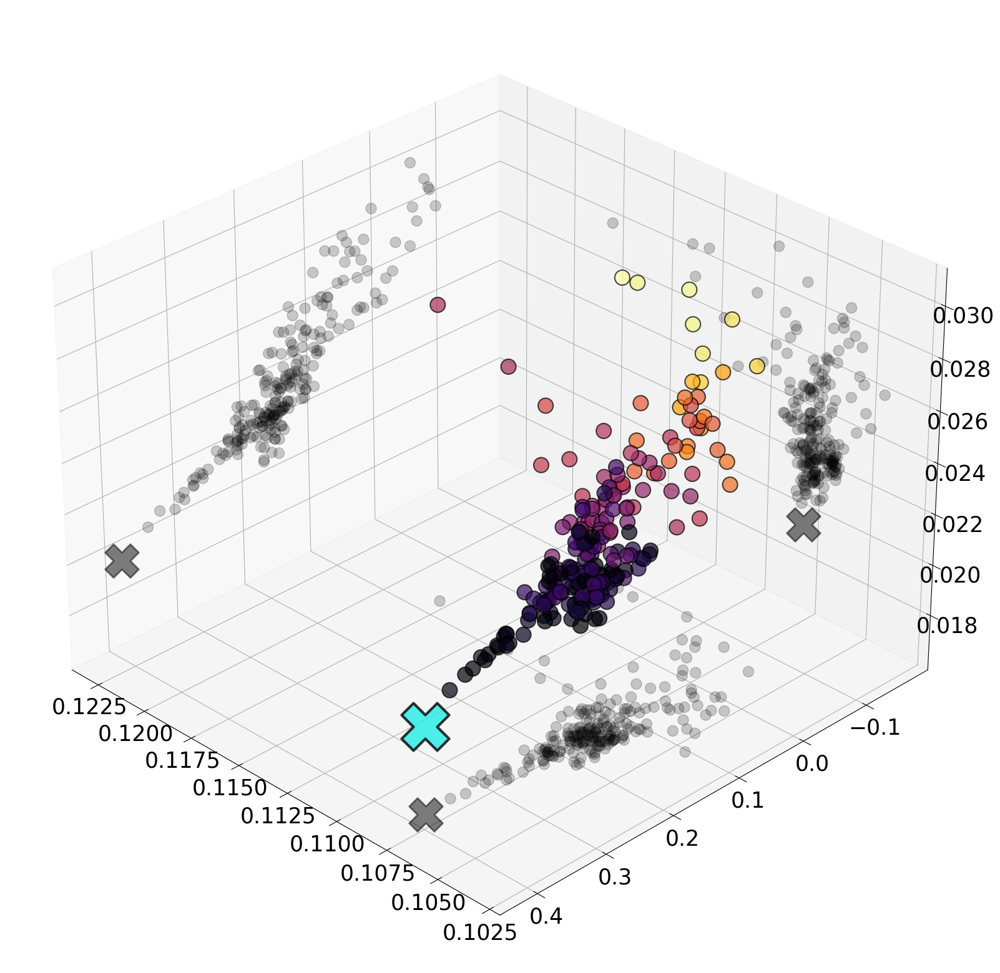

In [17]:
import matplotlib
from matplotlib.animation import FuncAnimation

# Create a 3D scatterplot
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

df = scaled_105['bursts_oscillation_600'].loc[subset]
X, Y, Z = df['X'], df['Y'], df['Z']
color_var = df['V_AUC_delta']
size_var = df['PARAM_bur']

# xyz_gains['alpha_PW_delta'].loc['eirs-tms-custom_PERM_[bur=3.00_osc=5.00].output']

norm_df = sp.norm(df)
# Step 2: Calculate the displacement from the start
displacement = np.sqrt(norm_df['X_delta']**2 +
                       norm_df['Y_delta']**2 +
                       norm_df['Z_delta']**2)

# Scatter plot for the main points
sc = ax.scatter(X, Y, Z, s=300, alpha = .7, c=color_var, cmap='inferno', edgecolors='black', linewidths=1.5)

ax.scatter(0.107, 0.412, 0.0202, s=3000, alpha = .8, c='#23ebe7', marker = 'X', edgecolors='black', linewidths=3)

ax.scatter(X.max() + (X.max() * .05), 0.412, 0.0202, s=1500, alpha = .5, c='black', marker = 'X', edgecolors='black', linewidths=2)
ax.scatter(0.107, Y.min() - .1, 0.0202, s=1500, alpha = .5, c='black', marker = 'X', edgecolors='black', linewidths=2)
ax.scatter(0.107, 0.412, Z.min() - (Z.min() * .2), s=1500, alpha = .5, c='black', marker = 'X', edgecolors='black', linewidths=2)

# Add labels and a colorbar
# ax.set_xlabel('Cortical (X)', fontsize=45, labelpad = 30)
# ax.set_ylabel('Cortico-thalamic (Y)', fontsize=45, labelpad = 30)
# ax.set_zlabel('Intrathalamic (Z)', fontsize=45, labelpad = 30)

ax.view_init(30, 180-45)

# Scatter plot for the shadows with reduced brightness (alpha)
ax.scatter(X.max() + (X.max() * .05), Y, Z, s=150, c='black', alpha=0.2)
ax.scatter(X, Y.min() - .1, Z, s=150, c='black', alpha=0.2)
ax.scatter(X, Y, Z.min() - (Z.min() * .2), s=150, c='black', alpha=0.2)

# ax.xaxis.line.set_color('#0099ff'); ax.xaxis.line.set_linewidth(10)
# ax.yaxis.line.set_color('#b663ab'); ax.yaxis.line.set_linewidth(10)
# ax.zaxis.line.set_color('#20abc7'); ax.zaxis.line.set_linewidth(10)

ax.tick_params(axis='both', which='major', labelsize=25, width = 'bold')

# plt.subplots_adjust(left=0.1, right=0.9, bottom=0.15, top=0.85)

plt.show()

In [69]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

DV = 'V_AUC_delta'  # Dependent variable stays the same

# Concatenate scaled_105['bursts_oscillation_600'][[DV]] and scaled_gain_change
MLR_df = pd.concat([scaled_105['bursts_oscillation_600'][[DV]], scaled_gain_change], axis=1)

# Run the analysis for each independent variable (X, Y, Z)
for IV in ['X', 'Y', 'Z']:
    # Perform regression analysis
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    
    # Store t-values and p-values
    t_value = model.tvalues[IV]
    p_value = model.pvalues[IV]
    
    # Convert p-value to a Series for multiple comparison corrections
    p_values_series = pd.Series({IV: p_value})
    
    # Apply Bonferroni correction
    _, corrected_p_values_bonferroni, _, _ = multipletests(p_values_series, method='bonferroni')
    
    # Apply FDR correction
    _, corrected_p_values_fdr, _, _ = multipletests(p_values_series, method='fdr_bh')
    
    # Format t-values and p-values together
    formatted_t_p_value = (
        f"t = {t_value:.2f}, p = {p_value:.3f}" if p_value >= (0.001 / len(p_values_series)) 
        else f"\\textbf{{t = {t_value:.2f}, p < 0.001}}"
    )
    
    # Organize results into LaTeX table format
    latex_table_row = f"{IV} & {formatted_t_p_value}"
    
    # Generate LaTeX table
    latex_table = "\\begin{tabular}{|l|c|}\n\\hline\n\\textbf{Independent Variable} & \\textbf{t-value, p-value} \\\\\n\\hline\n"
    latex_table += latex_table_row
    latex_table += "\n\\hline\n\\end{tabular}"
    
    print(f"\nResults for {IV}:\n")
    print(latex_table)




Results for X:

\begin{tabular}{|l|c|}
\hline
\textbf{Independent Variable} & \textbf{t-value, p-value} \\
\hline
X & \textbf{t = 4.18, p < 0.001}
\hline
\end{tabular}

Results for Y:

\begin{tabular}{|l|c|}
\hline
\textbf{Independent Variable} & \textbf{t-value, p-value} \\
\hline
Y & \textbf{t = -23.05, p < 0.001}
\hline
\end{tabular}

Results for Z:

\begin{tabular}{|l|c|}
\hline
\textbf{Independent Variable} & \textbf{t-value, p-value} \\
\hline
Z & \textbf{t = 25.46, p < 0.001}
\hline
\end{tabular}


In [84]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

IV = 'natural_freq_prox'  # Independent variable

# Concatenate the dependent variables (X, Y, Z) with the independent variable (natural_freq_prox)
MLR_df = pd.concat([scaled_gain_change[['X', 'Y', 'Z']], scaled_105['bursts_oscillation_600'][[IV]]], axis=1)

# Initialize dictionaries to store t-values and p-values
t_values = {}
p_values = {}

# Run the analysis for each dependent variable (X, Y, Z)
for DV in ['X', 'Y', 'Z']:
    # Perform regression analysis
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    
    # Store t-values and p-values
    t_values[DV] = model.tvalues[IV]
    p_values[DV] = model.pvalues[IV]

# Convert p-values to a Series for multiple comparison corrections
p_values_series = pd.Series(p_values)

# Apply Bonferroni and FDR correction
_, corrected_p_values_bonferroni, _, _ = multipletests(p_values_series, method='bonferroni')
_, corrected_p_values_fdr, _, _ = multipletests(p_values_series, method='fdr_bh')

# Format and display results
for DV in ['X', 'Y', 'Z']:
    formatted_t_p_value = (
        f"t = {t_values[DV]:.2f}, p = {p_values[DV]:.3f}" 
        if p_values[DV] >= (0.001 / len(p_values_series)) 
        else f"\\textbf{{t = {t_values[DV]:.2f}, p < 0.001}}"
    )
    
    # Display results
    print(f"\nResults for {DV}:\n")
    print(f"{DV} & {formatted_t_p_value}")



Results for X:

X & t = -2.02, p = 0.045

Results for Y:

Y & \textbf{t = 5.74, p < 0.001}

Results for Z:

Z & \textbf{t = -8.22, p < 0.001}


0.2732519521463263 4.151236840113816e-05


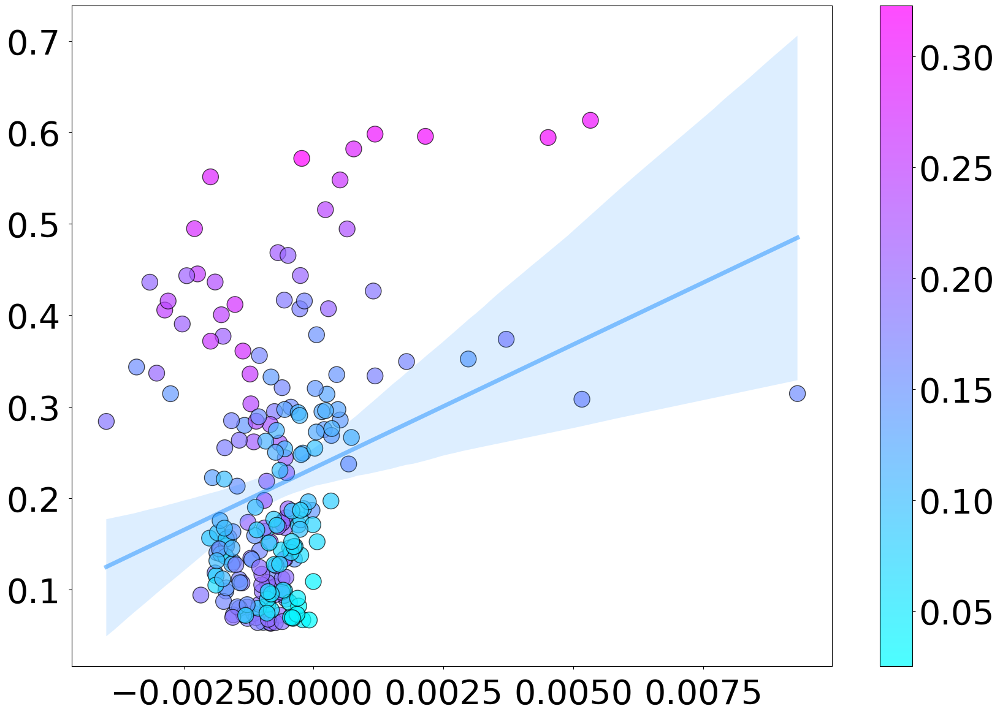

In [56]:
fig, ax = plt.subplots(figsize=(20, 14))

data = scaled_105['bursts_oscillation_600'].loc[subset]
x = scaled_gain_change['X']
y = data['V_AUC_delta'] # non normalized
color_variable = data['mean_synaptic_weight_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

In [172]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.multitest import multipletests

DV = 'alpha_PW_delta'  # Dependent variable stays the same

# Concatenate scaled_105['bursts_oscillation_600'][[DV]] and scaled_gain_change
MLR_df = pd.concat([scaled_105['bursts_oscillation_600'][[DV]], scaled_gain_change], axis=1)

# Run the analysis for each independent variable (X, Y, Z)
for IV in ['X', 'Y', 'Z']:
    # Perform regression analysis
    formula = f'{DV} ~ {IV}'
    model = ols(formula, data=MLR_df).fit()
    
    # Store t-values and p-values
    t_value = model.tvalues[IV]
    p_value = model.pvalues[IV]
    
    # Convert p-value to a Series for multiple comparison corrections
    p_values_series = pd.Series({IV: p_value})
    
    # Apply Bonferroni correction
    _, corrected_p_values_bonferroni, _, _ = multipletests(p_values_series, method='bonferroni')
    
    # Apply FDR correction
    _, corrected_p_values_fdr, _, _ = multipletests(p_values_series, method='fdr_bh')
    
    # Format t-values and p-values together
    formatted_t_p_value = (
        f"t = {t_value:.2f}, p = {p_value:.3f}" if p_value >= (0.001 / len(p_values_series)) 
        else f"\\textbf{{t = {t_value:.2f}, p < 0.001}}"
    )
    
    # Organize results into LaTeX table format
    latex_table_row = f"{IV} & {formatted_t_p_value}"
    
    # Generate LaTeX table
    latex_table = "\\begin{tabular}{|l|c|}\n\\hline\n\\textbf{Independent Variable} & \\textbf{t-value, p-value} \\\\\n\\hline\n"
    latex_table += latex_table_row
    latex_table += "\n\\hline\n\\end{tabular}"
    
    print(f"\nResults for {IV}:\n")
    print(latex_table)



Results for X:

\begin{tabular}{|l|c|}
\hline
\textbf{Independent Variable} & \textbf{t-value, p-value} \\
\hline
X & t = 2.86, p = 0.005
\hline
\end{tabular}

Results for Y:

\begin{tabular}{|l|c|}
\hline
\textbf{Independent Variable} & \textbf{t-value, p-value} \\
\hline
Y & \textbf{t = -10.59, p < 0.001}
\hline
\end{tabular}

Results for Z:

\begin{tabular}{|l|c|}
\hline
\textbf{Independent Variable} & \textbf{t-value, p-value} \\
\hline
Z & \textbf{t = 12.10, p < 0.001}
\hline
\end{tabular}


### Fixed

-0.6278548857359755 2.065109986594364e-25


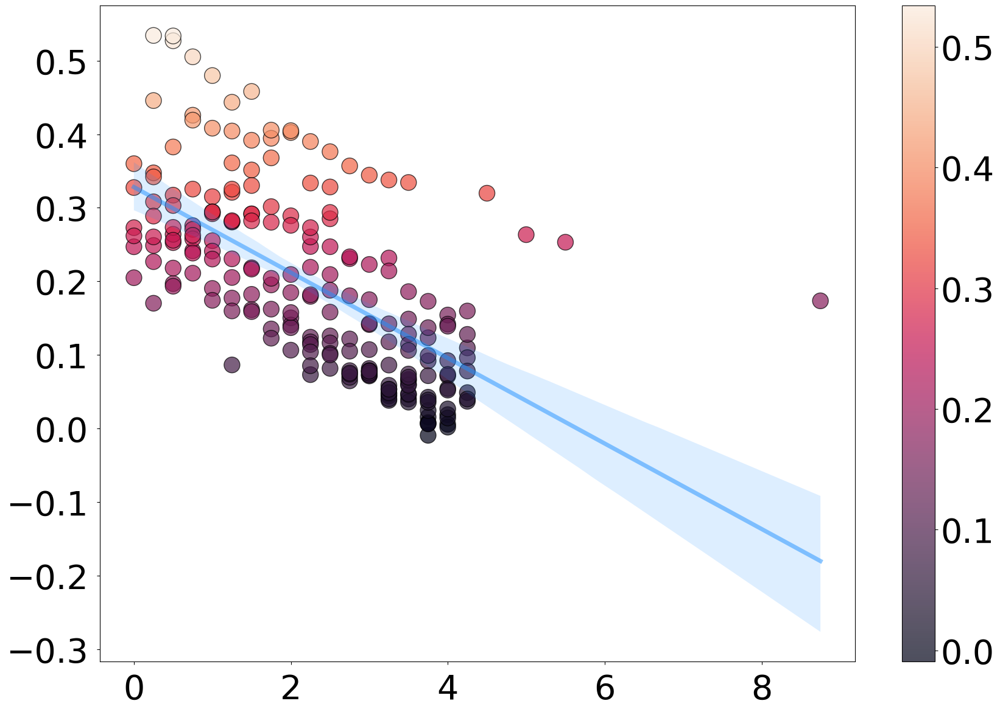

In [99]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['natural_freq_prox']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

-0.7478913036392808 1.7495109828757429e-40


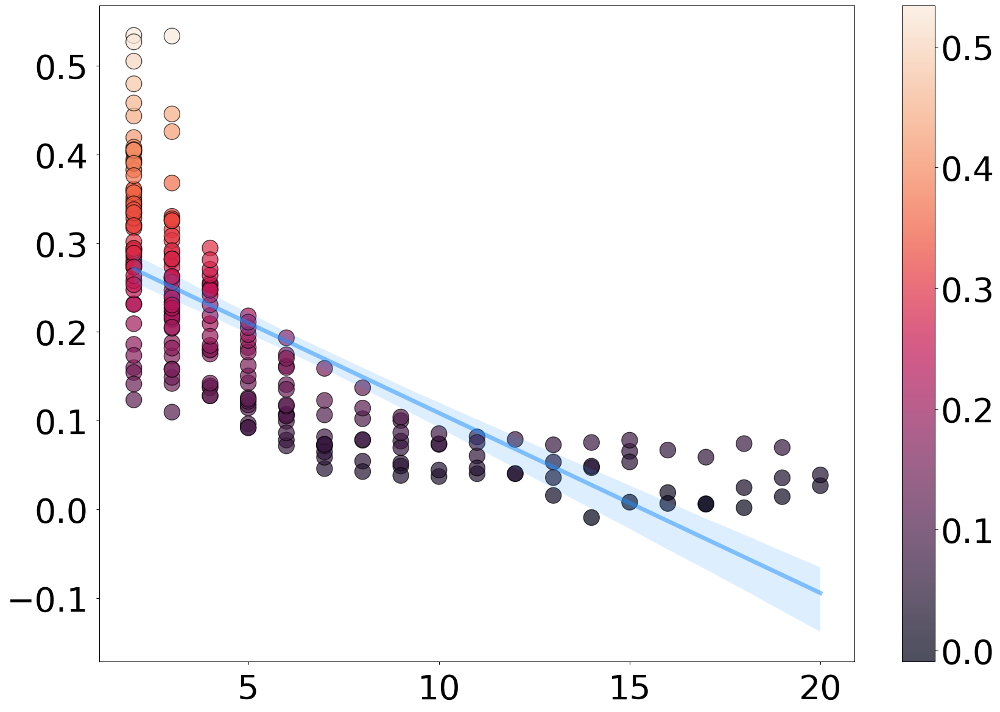

In [100]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_bur']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

0.6548502887088966 3.3388773616664276e-28


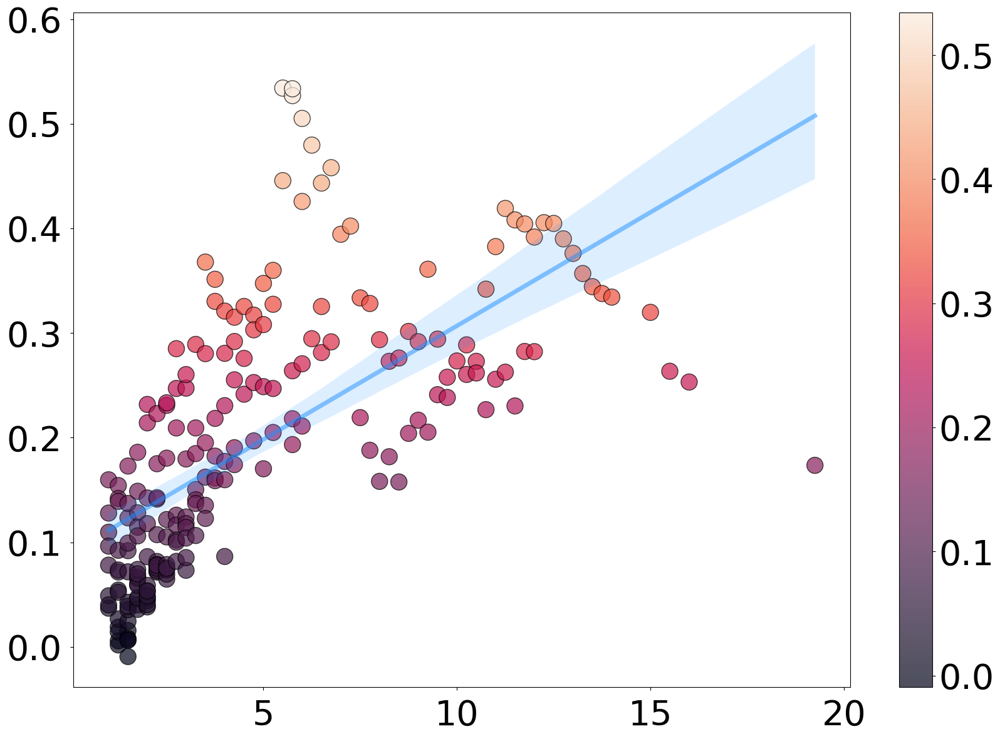

In [101]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_osc']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

-0.06907978283681235 0.3088427523981141


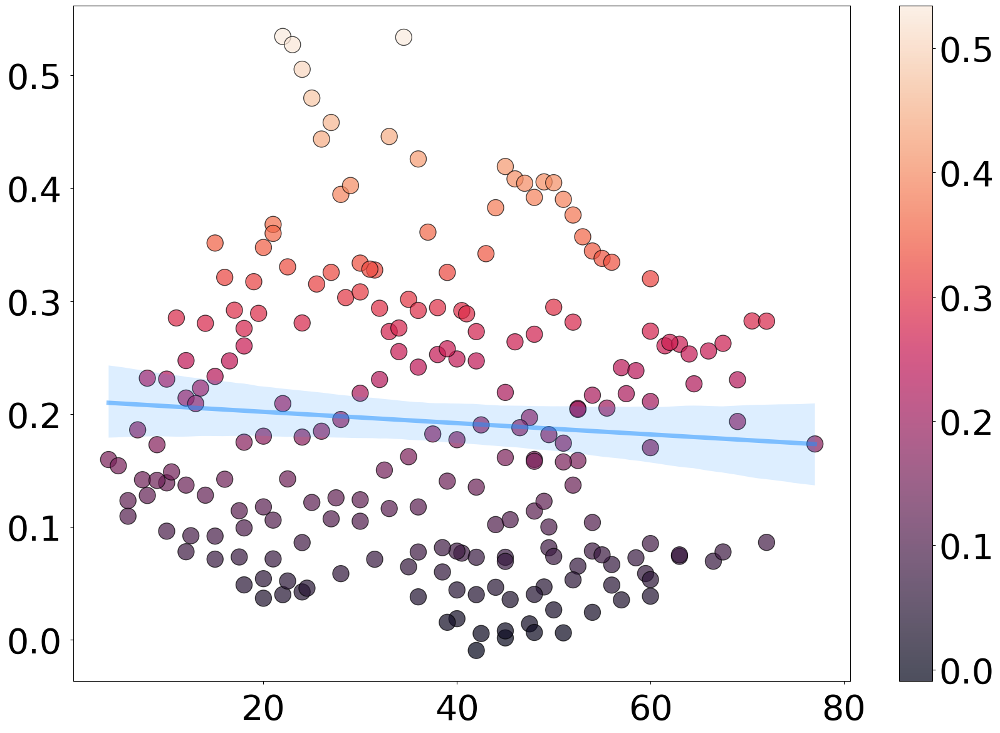

In [102]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = data['V_AUC_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rocket", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

0.05282590734147673 0.43667424711449


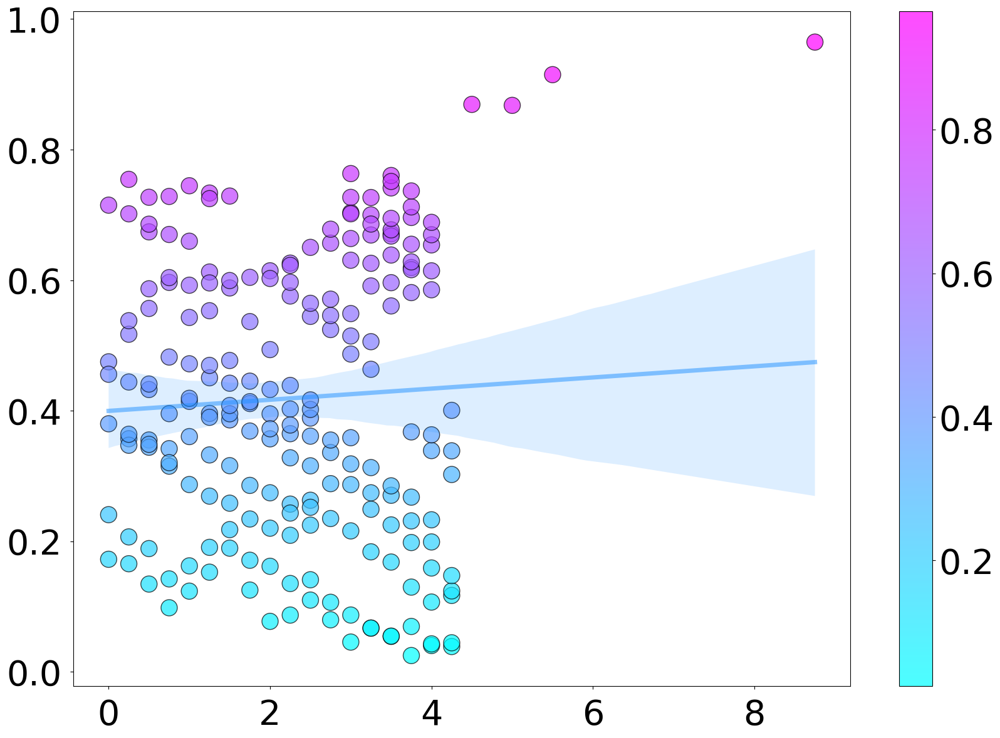

In [103]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['natural_freq_prox']
y = data['mean_synaptic_weight_delta']
color_variable = data['mean_synaptic_weight_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

0.47099915899892786 1.7157469014397887e-13


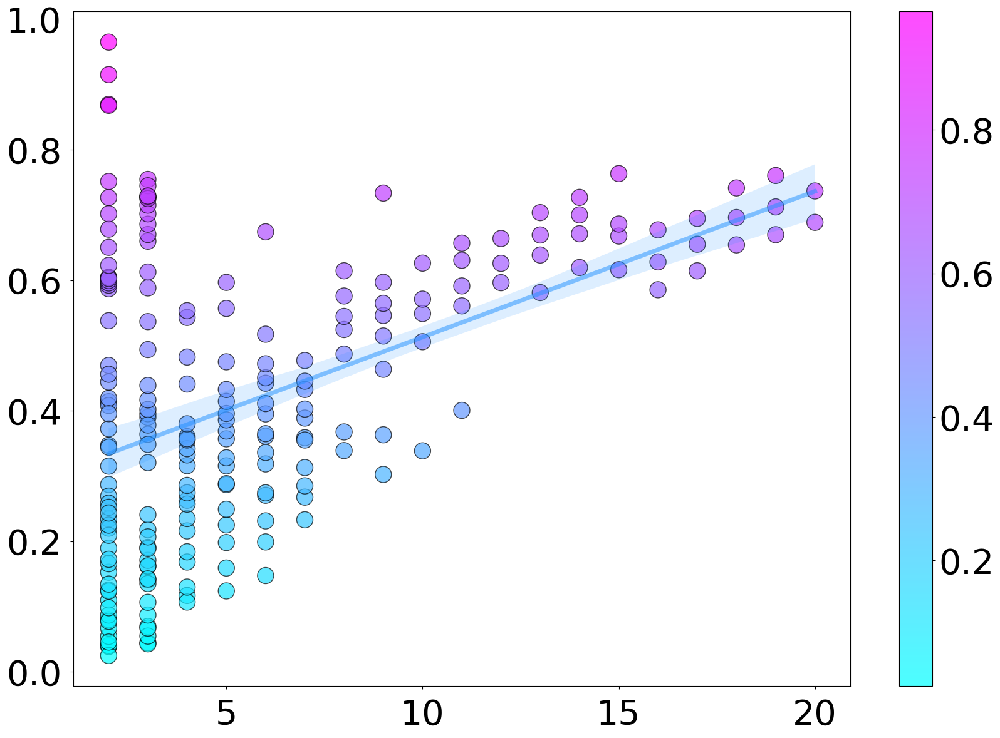

In [104]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_bur']
y = data['mean_synaptic_weight_delta']
color_variable = data['mean_synaptic_weight_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

0.4293816331577056 3.083804653052596e-11


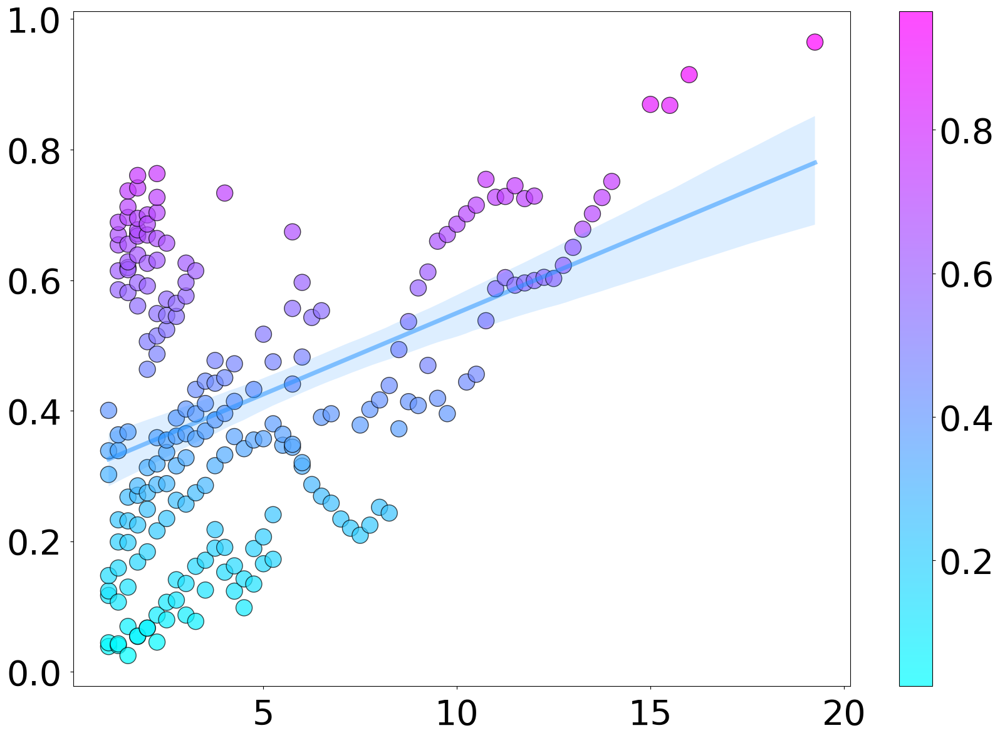

In [105]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['PARAM_osc']
y = data['mean_synaptic_weight_delta']
color_variable = data['mean_synaptic_weight_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


0.9414962143284182 1.825633841040821e-104


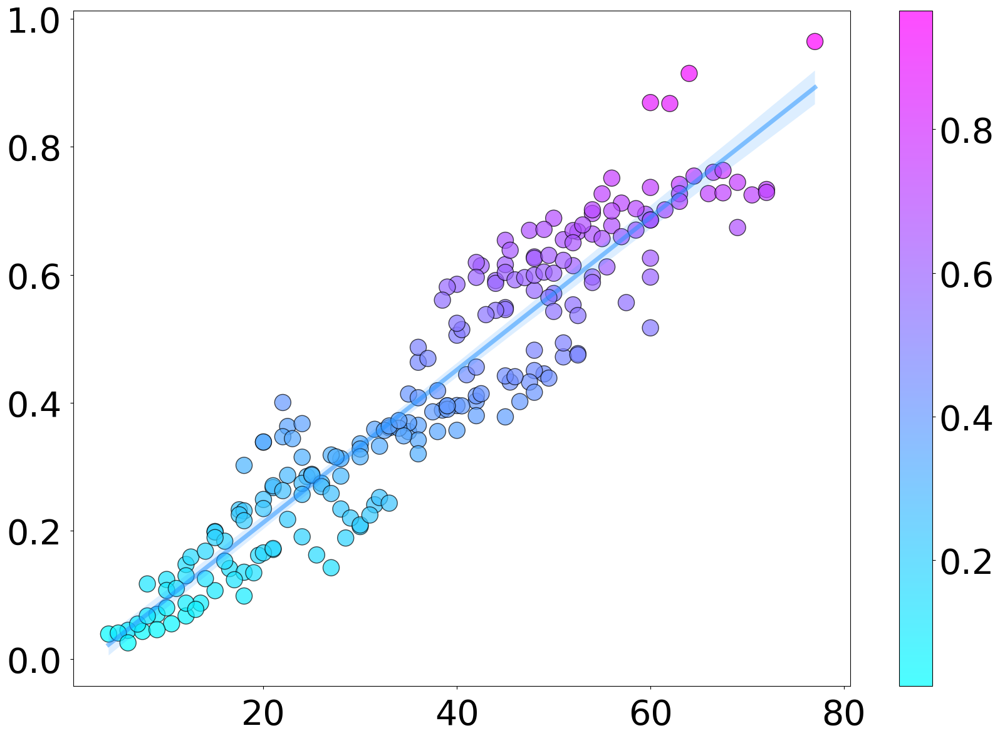

In [106]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['train_dose']
y = data['mean_synaptic_weight_delta']
color_variable = data['mean_synaptic_weight_delta']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="cool", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.16683646738504654 0.013429330413564736


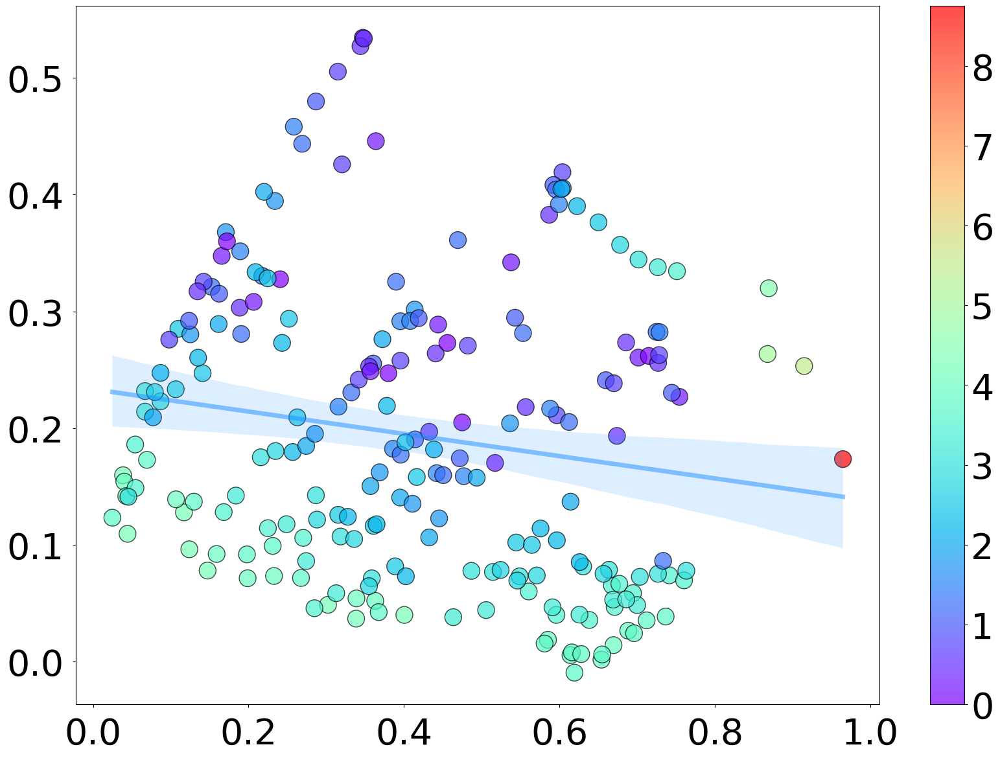

In [109]:
fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['mean_synaptic_weight_delta']
y = data['V_AUC_delta']
color_variable = data['natural_freq_prox']


points = ax.scatter(x, y,c=color_variable, s=350, cmap="rainbow", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='both', pad=10, labelsize=40)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

/home/j/johngrif/kadak/.local/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


-0.18059486393412127 0.007376929438922985


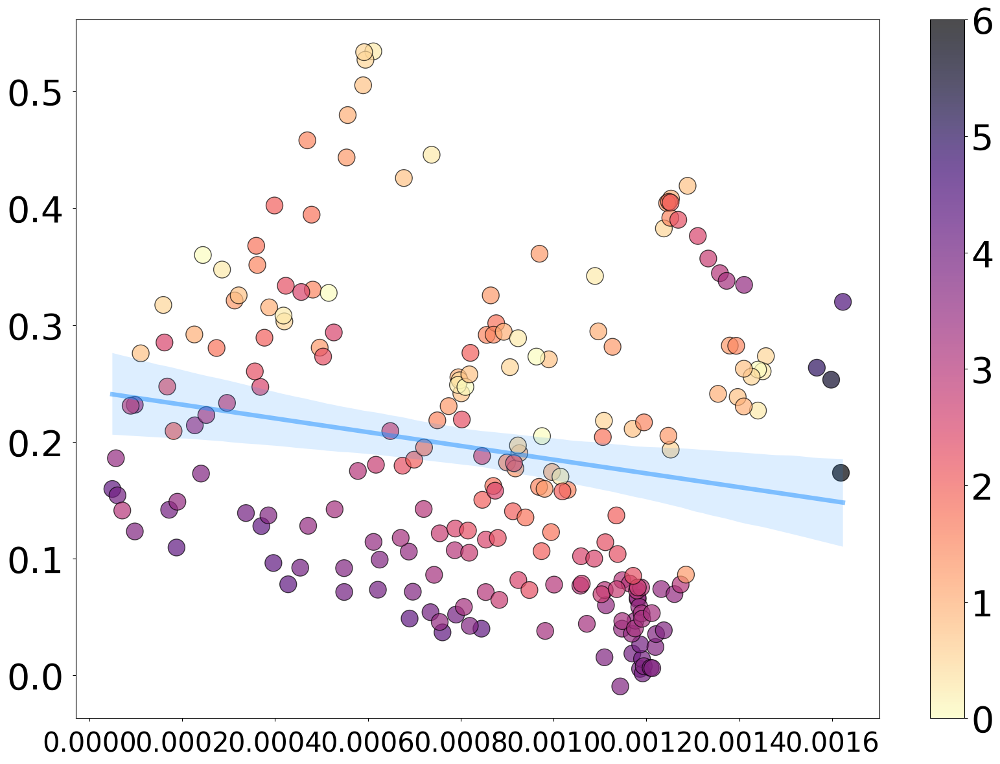

In [48]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(figsize=(20, 14))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = fixed_syn_change.mean(axis=1)
y = data['V_AUC_delta']
color_variable = data['natural_freq_prox']


points = ax.scatter(x, y,c=color_variable, s=350, cmap='magma_r', alpha = .7, edgecolor = 'black', vmax = 6)

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })

# ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{x:}'))

cbar = plt.colorbar(points)
# cbar.set_label('Inter-Burst Frequency (Hz)', fontsize=50)
cbar.ax.tick_params(labelsize=40)

# ax.set_xticks(np.arange(2, max(x) + 2, 2))
ax.tick_params(axis='y', pad=10, labelsize=40)
ax.tick_params(axis='x', pad=10, labelsize=30)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

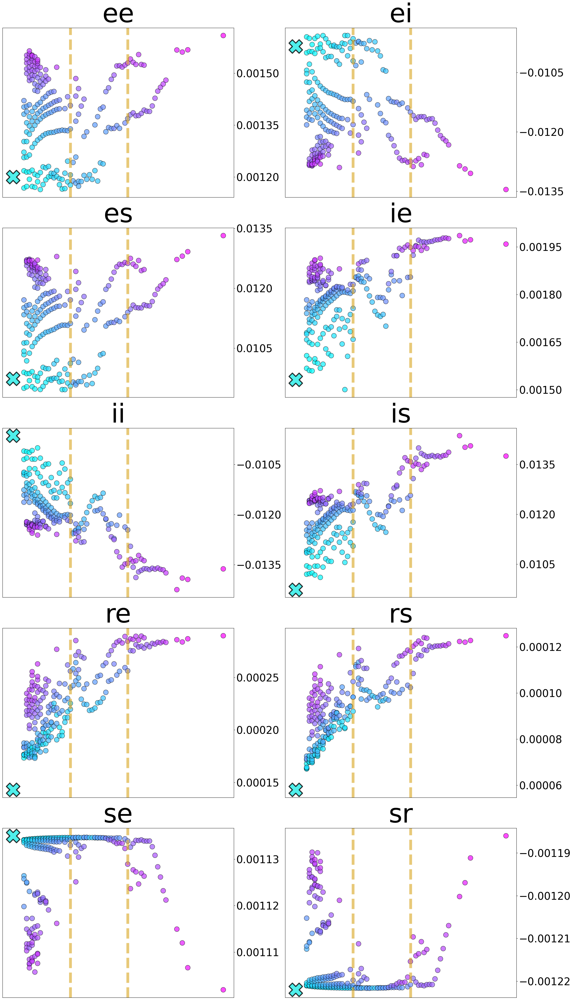

In [265]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

pre_stim_nus = {'ee' : 0.001200,
                'ei' : -0.009839,
                'es' : 0.009732,
                'ie' : 0.001532,
                'ii' : -0.009639,
                'is' : 0.009732,
                're' : 0.000143,
                'rs' : 0.000058,
                'se' : 0.001135,
                'sr' : -0.001222}


# Create a 2x5 subplot grid
fig, axes = plt.subplots(5, 2, figsize=(23, 40))

# Flatten the axes array to make indexing easier
axes = axes.flatten()

data = fixed_105['bursts_oscillation_600'].loc[subset]

# subset = (amp_105_limit['bursts_oscillation_600']['PARAM_bur'].between(2,21)) & (amp_105_limit['bursts_oscillation_600']['V_AUC_delta'] > .05)
x = data['PARAM_osc']
color_variable = data['mean_synaptic_weight_delta']

dependent_variables = [c for c in data.columns if 'post' in c and c not in ['coupling.ex.nu_post', 'coupling.sn.nu_post']]
for i, y_variable in enumerate(dependent_variables):
    # Select the y variable
    working_nu = y_variable.split(".")[1]
    
    y = data[y_variable]
    
    # Create a scatter plot
    axes[i].axvline(10.5, c = 'goldenrod', linestyle = '--', alpha = .6, linewidth = 8)
    axes[i].axvline(10.5/2, c = 'goldenrod', linestyle = '--', alpha = .6, linewidth = 8)
    
    scatter = axes[i].scatter(x, y, alpha=0.7, c=color_variable, cmap='cool', edgecolors='black', s = 200)
    axes[i].scatter(0, pre_stim_nus[str(working_nu)], s=1500, alpha = .8, c='#23ebe7', marker = 'X', edgecolors='black', linewidths=3)


    
    # Fit a regression line
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    regression_line = slope * x + intercept
    # axes[i].plot(x, regression_line, color='red')
    
    # Add title
    axes[i].set_title(f'{working_nu}', fontsize=75)
    
    # Adjust y-axis ticks
    axes[i].yaxis.set_major_locator(plt.MaxNLocator(4))  # Adjust the number of ticks
    axes[i].tick_params(axis='y', which='major', labelsize=30)  # Increase font size for y-axis ticks
    axes[i].yaxis.tick_right()
    
    # Remove x-axis ticks
    axes[i].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

-0.4188548394887805 1.0290271363337898e-10


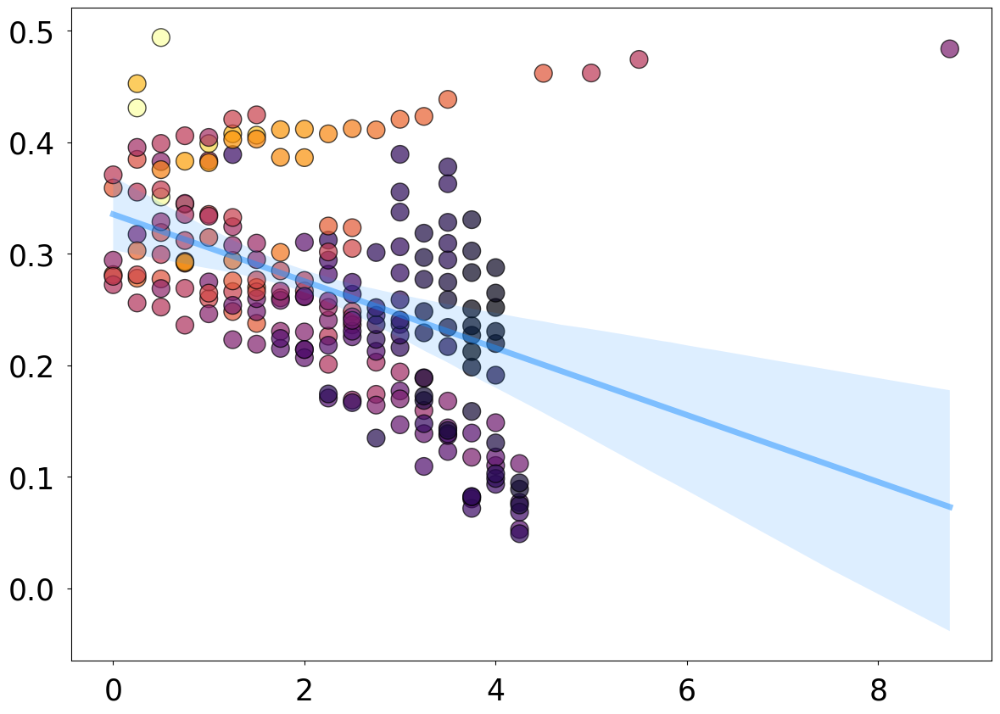

In [224]:
fig, ax = plt.subplots(figsize=(14, 10))

data = fixed_105['bursts_oscillation_600'].loc[subset]
x = data['natural_freq_prox']
y = data['Z_delta']
color_variable = data['V_AUC_delta']


points = ax.scatter(x, y,c=color_variable, s=225, cmap="inferno", alpha = .7, edgecolor = 'black')

ax = sns.regplot(x, y, data=data, scatter=False, line_kws={'color': 'dodgerblue', 
                                                           'linewidth' : 5,
                                                           'alpha' : .5 })


# ax.scatter(0.107, 0, s=1000, c='#23ebe7', marker = 'X', edgecolors='black', linewidths=3)


# ax.set_xticks(np.arange(min(x), max(x)))
ax.tick_params(axis='both', pad=10, labelsize=25)


# Add labels and title
ax.set_xlabel('', fontsize = 35)
ax.set_ylabel('', fontsize = 35)
slope, intercept, r_value, p_value, std_err = linregress(x, y)
print(r_value, p_value)

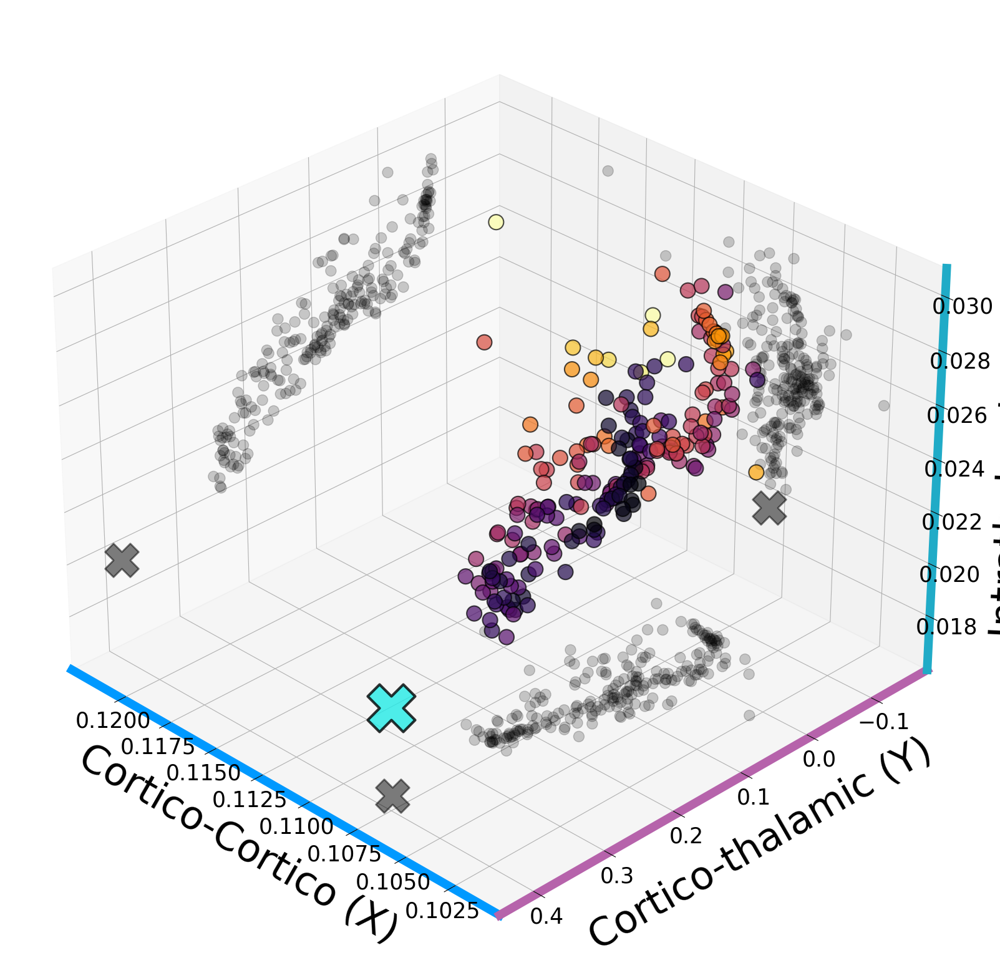

In [214]:
import matplotlib
from matplotlib.animation import FuncAnimation

# Create a 3D scatterplot
fig = plt.figure(figsize=(20, 20))
ax = fig.add_subplot(111, projection='3d')

df = fixed_105['bursts_oscillation_600'].loc[subset]
X, Y, Z = df['X'], df['Y'], df['Z']
color_var = df['V_AUC_delta']
size_var = df['PARAM_bur']

# xyz_gains['alpha_PW_delta'].loc['eirs-tms-custom_PERM_[bur=3.00_osc=5.00].output']

norm_df = sp.norm(df)
# Step 2: Calculate the displacement from the start
displacement = np.sqrt(norm_df['X_delta']**2 +
                       norm_df['Y_delta']**2 +
                       norm_df['Z_delta']**2)

# Scatter plot for the main points
sc = ax.scatter(X, Y, Z, s=300, alpha = .7, c=color_var, cmap='inferno', edgecolors='black', linewidths=1.5)

ax.scatter(0.107, 0.412, 0.0202, s=3000, alpha = .8, c='#23ebe7', marker = 'X', edgecolors='black', linewidths=3)

ax.scatter(X.max() + (X.max() * .05), 0.412, 0.0202, s=1500, alpha = .5, c='black', marker = 'X', edgecolors='black', linewidths=2)
ax.scatter(0.107, Y.min() - .1, 0.0202, s=1500, alpha = .5, c='black', marker = 'X', edgecolors='black', linewidths=2)
ax.scatter(0.107, 0.412, Z.min() - (Z.min() * .2), s=1500, alpha = .5, c='black', marker = 'X', edgecolors='black', linewidths=2)

# Add labels and a colorbar
ax.set_xlabel('Cortico-Cortico (X)', fontsize=45, labelpad = 30)
ax.set_ylabel('Cortico-thalamic (Y)', fontsize=45, labelpad = 30)
ax.set_zlabel('Intrathalamic (Z)', fontsize=45, labelpad = 30)

ax.view_init(30, 180-45)

# Scatter plot for the shadows with reduced brightness (alpha)
ax.scatter(X.max() + (X.max() * .05), Y, Z, s=150, c='black', alpha=0.2)
ax.scatter(X, Y.min() - .1, Z, s=150, c='black', alpha=0.2)
ax.scatter(X, Y, Z.min() - (Z.min() * .2), s=150, c='black', alpha=0.2)

ax.xaxis.line.set_color('#0099ff'); ax.xaxis.line.set_linewidth(10)
ax.yaxis.line.set_color('#b663ab'); ax.yaxis.line.set_linewidth(10)
ax.zaxis.line.set_color('#20abc7'); ax.zaxis.line.set_linewidth(10)

ax.tick_params(axis='both', which='major', labelsize=25, width = 'bold')

# plt.subplots_adjust(left=0.1, right=0.9, bottom=0.15, top=0.85)

plt.show()

In [10]:
gnmda_std_cols = [c for c in scaled_105['bursts_oscillation_600'].columns if 'gnmda' and 'std' in c]
gnmda_roc_cols = [c for c in scaled_105['bursts_oscillation_600'].columns if 'gnmda' and 'RoC' in c]

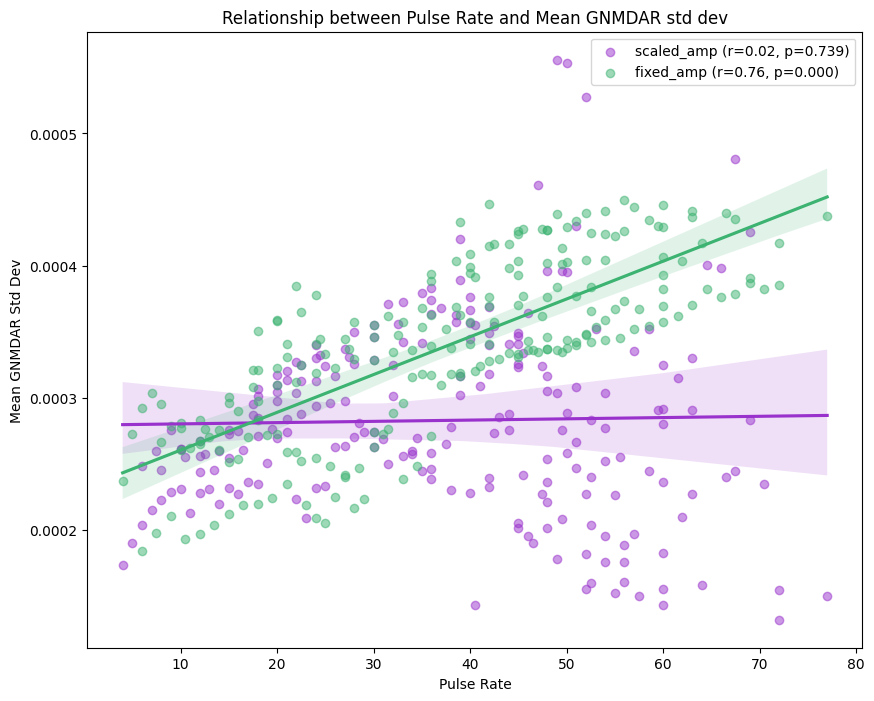

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.stats import pearsonr

# Extract the necessary data
scaled_amp_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data = fixed_105['bursts_oscillation_600'].loc[subset]

scaled_amp_x = scaled_amp_data['train_dose']
scaled_amp_y = scaled_amp_data[gnmda_std_cols].mean(axis=1)

fixed_amp_x = fixed_amp_data['train_dose']
fixed_amp_y = fixed_amp_data[gnmda_std_cols].mean(axis=1)

# Calculate Pearson correlation coefficients and p-values
r_scaled_amp, p_scaled_amp = pearsonr(scaled_amp_x, scaled_amp_y)
r_fixed_amp, p_fixed_amp = pearsonr(fixed_amp_x, fixed_amp_y)

# Create the plot
plt.figure(figsize=(10, 8))

# Plot scaled_amp data with trend line
sns.regplot(x=scaled_amp_x, y=scaled_amp_y, scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, label=f'scaled_amp (r={r_scaled_amp:.2f}, p={p_scaled_amp:.3f})', ci=99.9)

# Plot fixed_amp data with trend line
sns.regplot(x=fixed_amp_x, y=fixed_amp_y, scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, label=f'fixed_amp (r={r_fixed_amp:.2f}, p={p_fixed_amp:.3f})', ci=99.9)

# Add labels and title
plt.xlabel('Pulse Rate')
plt.ylabel('Mean GNMDAR Std Dev')
plt.title('Relationship between Pulse Rate and Mean GNMDAR std dev')
plt.legend()

# Show the plot
plt.show()



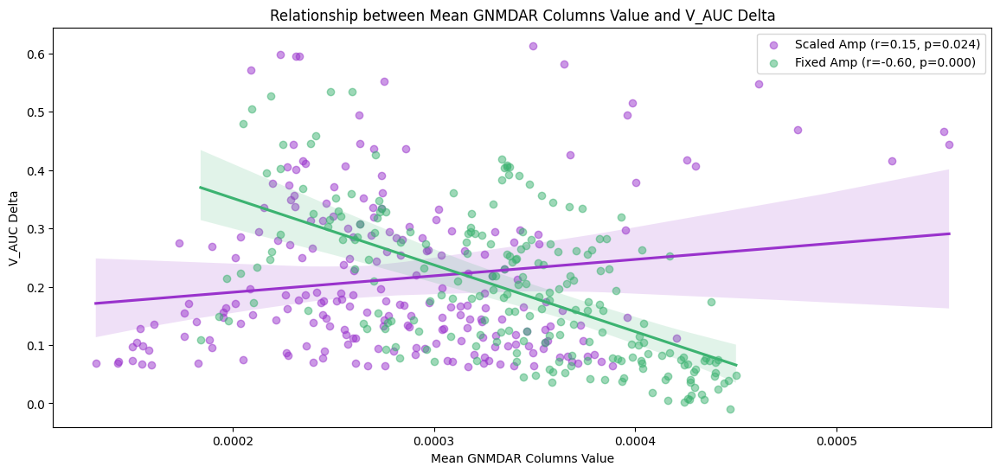

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

# Extract the necessary data
scaled_amp_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data = fixed_105['bursts_oscillation_600'].loc[subset]

scaled_amp_x = scaled_amp_data[gnmda_std_cols].mean(axis=1)
scaled_amp_y = scaled_amp_data['V_AUC_delta']

fixed_amp_x = fixed_amp_data[gnmda_std_cols].mean(axis=1)
fixed_amp_y = fixed_amp_data['V_AUC_delta']

# Calculate Pearson correlation coefficients and p-values
r_scaled_amp, p_scaled_amp = pearsonr(scaled_amp_x, scaled_amp_y)
r_fixed_amp, p_fixed_amp = pearsonr(fixed_amp_x, fixed_amp_y)

# Create the plot
plt.figure(figsize=(14, 6))

# Plot scaled_amp data with trend line
sns.regplot(x=scaled_amp_x, y=scaled_amp_y, scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, label=f'Scaled Amp (r={r_scaled_amp:.2f}, p={p_scaled_amp:.3f})', ci=99.9)

# Plot fixed_amp data with trend line
sns.regplot(x=fixed_amp_x, y=fixed_amp_y, scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, label=f'Fixed Amp (r={r_fixed_amp:.2f}, p={p_fixed_amp:.3f})', ci=99.9)

# Add labels and title
plt.xlabel('Mean GNMDAR Columns Value')
plt.ylabel('V_AUC Delta')
plt.title('Relationship between Mean GNMDAR Columns Value and V_AUC Delta')
plt.legend()

# Show the plot
plt.show()


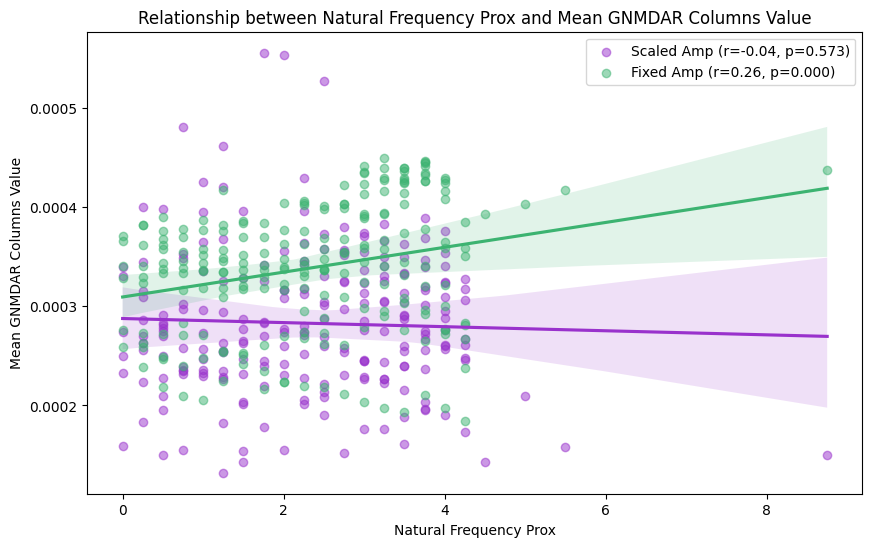

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

# Extract the necessary data
scaled_amp_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data = fixed_105['bursts_oscillation_600'].loc[subset]

scaled_amp_x = scaled_amp_data['natural_freq_prox']
scaled_amp_y = scaled_amp_data[gnmda_std_cols].mean(axis=1)

fixed_amp_x = fixed_amp_data['natural_freq_prox']
fixed_amp_y = fixed_amp_data[gnmda_std_cols].mean(axis=1)

# Calculate Pearson correlation coefficients and p-values
r_scaled_amp, p_scaled_amp = pearsonr(scaled_amp_x, scaled_amp_y)
r_fixed_amp, p_fixed_amp = pearsonr(fixed_amp_x, fixed_amp_y)

# Create the plot
plt.figure(figsize=(10, 6))

# Plot scaled_amp data with trend line
sns.regplot(x=scaled_amp_x, y=scaled_amp_y, scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, label=f'Scaled Amp (r={r_scaled_amp:.2f}, p={p_scaled_amp:.3f})', ci=99.9)

# Plot fixed_amp data with trend line
sns.regplot(x=fixed_amp_x, y=fixed_amp_y, scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, label=f'Fixed Amp (r={r_fixed_amp:.2f}, p={p_fixed_amp:.3f})', ci=99.9)

# Add labels and title
plt.xlabel('Natural Frequency Prox')
plt.ylabel('Mean GNMDAR Columns Value')
plt.title('Relationship between Natural Frequency Prox and Mean GNMDAR Columns Value')
plt.legend()

# Show the plot
plt.show()


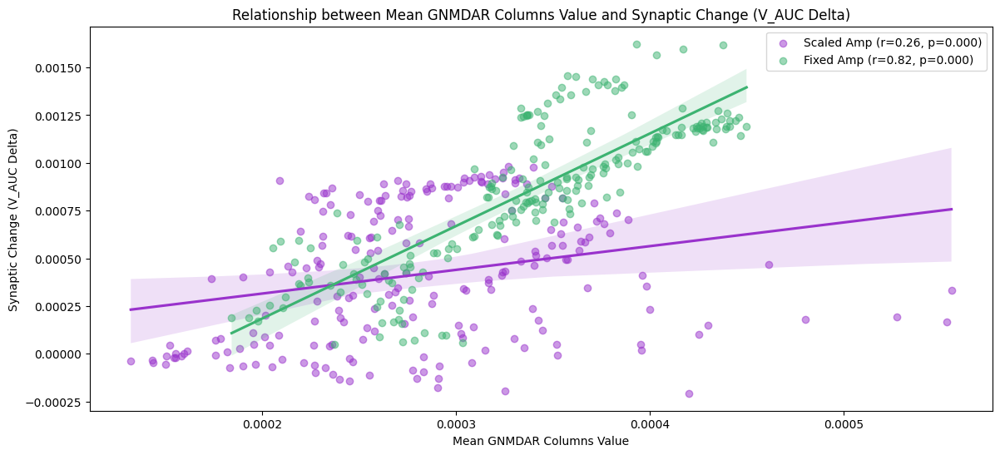

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

# Extract the necessary data
scaled_amp_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data = fixed_105['bursts_oscillation_600'].loc[subset]

scaled_amp_x = scaled_amp_data[gnmda_std_cols].mean(axis=1)
scaled_amp_y = scaled_syn_change.mean(axis=1)

fixed_amp_x = fixed_amp_data[gnmda_std_cols].mean(axis=1)
fixed_amp_y = fixed_syn_change.mean(axis=1)

# Calculate Pearson correlation coefficients and p-values
r_scaled_amp, p_scaled_amp = pearsonr(scaled_amp_x, scaled_amp_y)
r_fixed_amp, p_fixed_amp = pearsonr(fixed_amp_x, fixed_amp_y)

# Create the plot
plt.figure(figsize=(14, 6))

# Plot scaled_amp data with trend line
sns.regplot(x=scaled_amp_x, y=scaled_amp_y, scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, label=f'Scaled Amp (r={r_scaled_amp:.2f}, p={p_scaled_amp:.3f})', ci=99.9)

# Plot fixed_amp data with trend line
sns.regplot(x=fixed_amp_x, y=fixed_amp_y, scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, label=f'Fixed Amp (r={r_fixed_amp:.2f}, p={p_fixed_amp:.3f})', ci=99.9)

# Add labels and title
plt.xlabel('Mean GNMDAR Columns Value')
plt.ylabel('Synaptic Change (V_AUC Delta)')
plt.title('Relationship between Mean GNMDAR Columns Value and Synaptic Change (V_AUC Delta)')
plt.legend()

# Show the plot
plt.show()


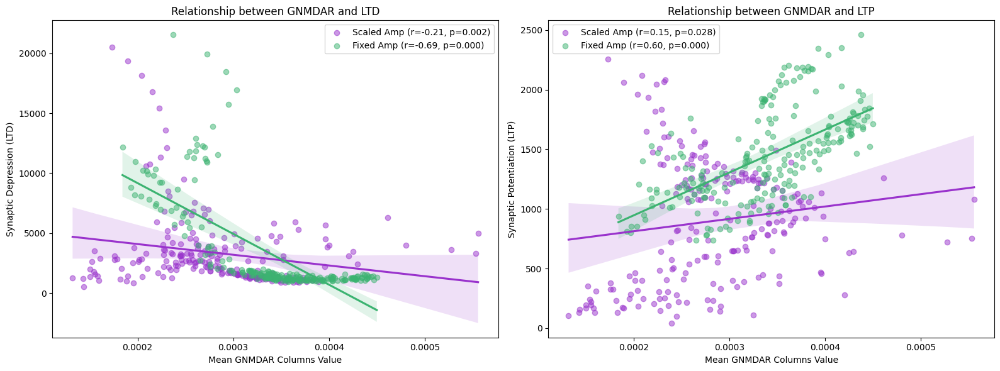

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

# Create a figure with two subplots side by side
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# LEFT SUBPLOT: Using fixed/scaled_ltds
# Extract the necessary data for LTDs
scaled_amp_data_ltd = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data_ltd = fixed_105['bursts_oscillation_600'].loc[subset]
scaled_amp_x_ltd = scaled_amp_data_ltd[gnmda_std_cols].mean(axis=1)
scaled_amp_y_ltd = scaled_ltds.mean(axis=1)  # Using scaled_ltds
fixed_amp_x_ltd = fixed_amp_data_ltd[gnmda_std_cols].mean(axis=1)
fixed_amp_y_ltd = fixed_ltds.mean(axis=1)  # Using fixed_ltds

# Calculate Pearson correlation coefficients and p-values for LTDs
r_scaled_amp_ltd, p_scaled_amp_ltd = pearsonr(scaled_amp_x_ltd, scaled_amp_y_ltd)
r_fixed_amp_ltd, p_fixed_amp_ltd = pearsonr(fixed_amp_x_ltd, fixed_amp_y_ltd)

# Plot scaled_amp data with trend line for LTDs
sns.regplot(x=scaled_amp_x_ltd, y=scaled_amp_y_ltd, 
            scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, 
            label=f'Scaled Amp (r={r_scaled_amp_ltd:.2f}, p={p_scaled_amp_ltd:.3f})', 
            ci=99.9, ax=axes[0])

# Plot fixed_amp data with trend line for LTDs
sns.regplot(x=fixed_amp_x_ltd, y=fixed_amp_y_ltd, 
            scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, 
            label=f'Fixed Amp (r={r_fixed_amp_ltd:.2f}, p={p_fixed_amp_ltd:.3f})', 
            ci=99.9, ax=axes[0])

# Add labels and title for LTDs subplot
axes[0].set_xlabel('Mean GNMDAR Columns Value')
axes[0].set_ylabel('Synaptic Depression (LTD)')
axes[0].set_title('Relationship between GNMDAR and LTD')
axes[0].legend()

# RIGHT SUBPLOT: Using fixed/scaled_ltps (your original code)
# Extract the necessary data for LTPs
scaled_amp_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data = fixed_105['bursts_oscillation_600'].loc[subset]
scaled_amp_x = scaled_amp_data[gnmda_std_cols].mean(axis=1)
scaled_amp_y = scaled_ltps.mean(axis=1)  # Using scaled_ltps
fixed_amp_x = fixed_amp_data[gnmda_std_cols].mean(axis=1)
fixed_amp_y = fixed_ltps.mean(axis=1)  # Using fixed_ltps

# Calculate Pearson correlation coefficients and p-values for LTPs
r_scaled_amp, p_scaled_amp = pearsonr(scaled_amp_x, scaled_amp_y)
r_fixed_amp, p_fixed_amp = pearsonr(fixed_amp_x, fixed_amp_y)

# Plot scaled_amp data with trend line for LTPs
sns.regplot(x=scaled_amp_x, y=scaled_amp_y, 
            scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, 
            label=f'Scaled Amp (r={r_scaled_amp:.2f}, p={p_scaled_amp:.3f})', 
            ci=99.9, ax=axes[1])

# Plot fixed_amp data with trend line for LTPs
sns.regplot(x=fixed_amp_x, y=fixed_amp_y, 
            scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, 
            label=f'Fixed Amp (r={r_fixed_amp:.2f}, p={p_fixed_amp:.3f})', 
            ci=99.9, ax=axes[1])

# Add labels and title for LTPs subplot
axes[1].set_xlabel('Mean GNMDAR Columns Value')
axes[1].set_ylabel('Synaptic Potentiation (LTP)')
axes[1].set_title('Relationship between GNMDAR and LTP')
axes[1].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

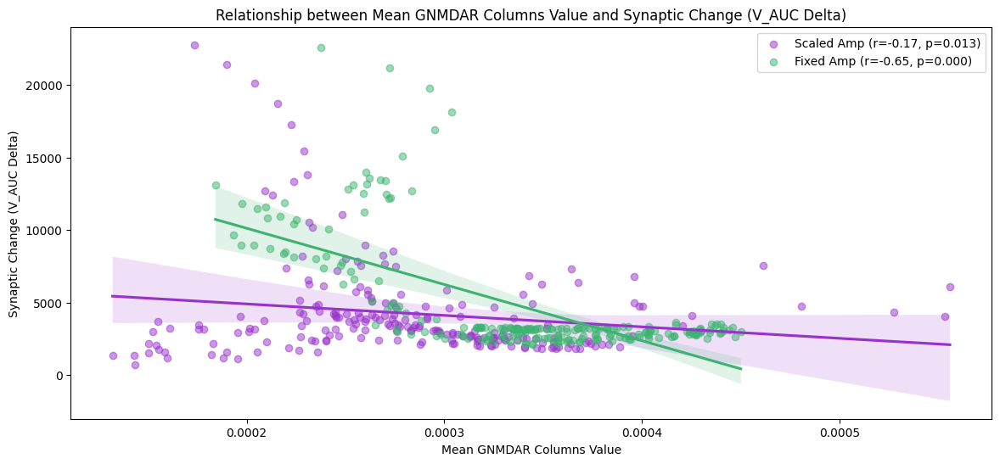

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr

# Extract the necessary data
scaled_amp_data = scaled_105['bursts_oscillation_600'].loc[subset]
fixed_amp_data = fixed_105['bursts_oscillation_600'].loc[subset]

scaled_amp_x = scaled_amp_data[gnmda_std_cols].mean(axis=1)
scaled_amp_y = scaled_ltds.mean(axis=1) + scaled_ltps.mean(axis=1)

fixed_amp_x = fixed_amp_data[gnmda_std_cols].mean(axis=1)
fixed_amp_y = fixed_ltds.mean(axis=1) + fixed_ltps.mean(axis=1)

# Calculate Pearson correlation coefficients and p-values
r_scaled_amp, p_scaled_amp = pearsonr(scaled_amp_x, scaled_amp_y)
r_fixed_amp, p_fixed_amp = pearsonr(fixed_amp_x, fixed_amp_y)

# Create the plot
plt.figure(figsize=(14, 6))

# Plot scaled_amp data with trend line
sns.regplot(x=scaled_amp_x, y=scaled_amp_y, scatter_kws={'color': 'darkorchid', 'alpha': 0.5},
            line_kws={'color': 'darkorchid'}, label=f'Scaled Amp (r={r_scaled_amp:.2f}, p={p_scaled_amp:.3f})', ci=99.9)

# Plot fixed_amp data with trend line
sns.regplot(x=fixed_amp_x, y=fixed_amp_y, scatter_kws={'color': 'mediumseagreen', 'alpha': 0.5},
            line_kws={'color': 'mediumseagreen'}, label=f'Fixed Amp (r={r_fixed_amp:.2f}, p={p_fixed_amp:.3f})', ci=99.9)

# Add labels and title
plt.xlabel('Mean GNMDAR Columns Value')
plt.ylabel('Synaptic Change (V_AUC Delta)')
plt.title('Relationship between Mean GNMDAR Columns Value and Synaptic Change (V_AUC Delta)')
plt.legend()

# Show the plot
plt.show()


In [8]:
standard = sp.dot_conf('eirs-tms-custom.conf').run(params={'Oscillation': '5.00', 'Interval' : '1e-2', 'Deltat' : '1e-3'})

Replacing Oscillation '5' with '5.00' --    Bursts: 3 Burst Frequency: 50 Oscillation Frequency: 5.00 On: 2 Off: 8

Replacing Interval '1e-3' with '1e-2
' -- Output: Node: All Start: 5 Interval: 1e-2

Replacing Deltat '0.0001' with '1e-3
' -- Time: 600 Deltat: 1e-3

Wrote 1 new conf files to: confs/


<Axes: xlabel='Pulses / Burst', ylabel='Inter-Burst Frequency (Hz)'>

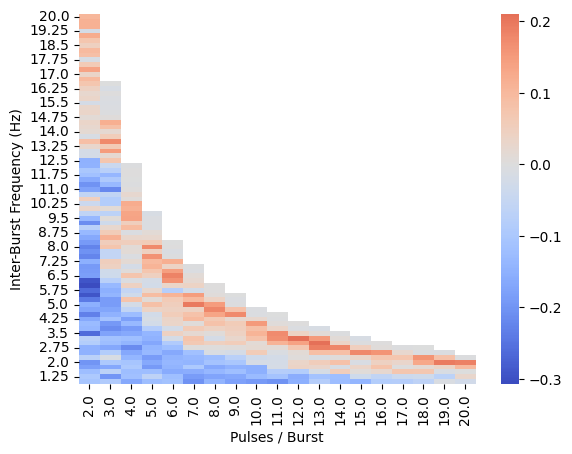

In [20]:
sns.heatmap(sp.param_space(scaled_105['bursts_oscillation_600']['alpha_PW_delta']), cmap = 'coolwarm', center = 0)

/tmp/ipykernel_2266399/2865742251.py:29: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('coolwarm')


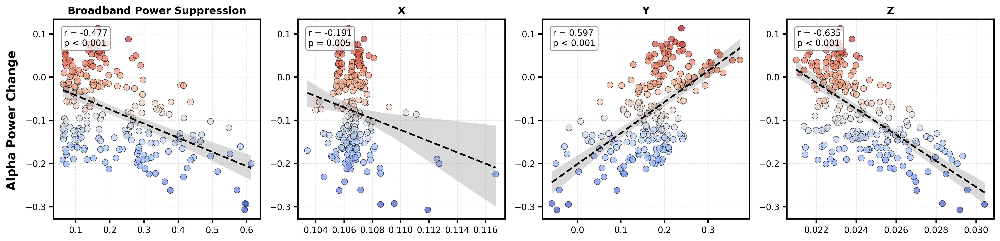

In [67]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scipy.stats as stats
from matplotlib.cm import get_cmap
from matplotlib.colors import Normalize
from matplotlib import rcParams

# Set publication-quality figure parameters
rcParams['font.family'] = 'Arial'
rcParams['font.size'] = 10
rcParams['axes.linewidth'] = 1.5
rcParams['xtick.major.width'] = 1.5
rcParams['ytick.major.width'] = 1.5
rcParams['xtick.major.size'] = 5
rcParams['ytick.major.size'] = 5

# Create a 4x1 subplot figure with appropriate size
fig, axes = plt.subplots(1, 4, figsize=(16, 4), dpi=300)
fig.subplots_adjust(wspace=0.35)

# Define the x variables with proper names for plotting
x_vars = ['V_AUC_delta', 'X', 'Y', 'Z']
x_var_labels = ['Broadband Power Suppression', 'X', 'Y', 'Z']
y_var = 'alpha_PW_delta'
y_var_label = 'Alpha Power Change'

# Set up colormap normalization
cmap = get_cmap('coolwarm')
norm = Normalize(vmin=scaled_105['bursts_oscillation_600'].loc[subset][y_var].min(),
                 vmax=scaled_105['bursts_oscillation_600'].loc[subset][y_var].max())

# Function to add regression plot with r and p values
def add_regression_plot(ax, data, x_var, y_var, x_label, y_label):
    x_data = data[x_var]
    y_data = data[y_var]
    
    # Map colors from y_var
    colors = cmap(norm(y_data))
    
    # Scatter plot with color mapped to y_var
    scatter = ax.scatter(x_data, y_data, c=colors, s=50, alpha=0.7, edgecolor='k', linewidth=0.5)
    
    # Fit regression line
    sns.regplot(x=x_data, y=y_data, ax=ax, ci=95, scatter=False, 
                line_kws={'color': 'black', 'linewidth': 2, 'linestyle': '--'})
    
    # Correlation statistics
    r, p = stats.pearsonr(x_data, y_data)
    
    # Format p-value text with scientific notation if very small
    if p < 0.001:
        p_text = f"p < 0.001"
    else:
        p_text = f"p = {p:.3f}"
    
    # Add r and p text
    ax.annotate(f"r = {r:.3f}\n{p_text}", 
                xy=(0.05, 0.95), 
                xycoords='axes fraction',
                fontsize=10,
                bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
                verticalalignment='top')
    
    # Set axis titles and labels
    ax.set_title(f'{x_label}', fontsize=12, fontweight='bold')
    ax.set_xlabel('', fontsize=11)
    ax.set_ylabel('', fontsize=11)
    
    # Add grid for better readability
    ax.grid(True, linestyle='--', alpha=0.3)
    
    # Make tick labels more readable
    ax.tick_params(axis='both', which='major', labelsize=10)
    
    # Add a subtle box around the plot
    for spine in ax.spines.values():
        spine.set_color('black')
        spine.set_linewidth(1.5)

# Plot each subplot
for i, (x_var, x_label) in enumerate(zip(x_vars, x_var_labels)):
    add_regression_plot(axes[i], scaled_105['bursts_oscillation_600'].loc[subset], 
                       x_var, y_var, x_label, y_var_label)

# Add a common y-label for the entire figure (optional)
fig.text(-0.01, 0.5, y_var_label, va='center', rotation='vertical', fontsize=14, fontweight='bold')

# Add a color bar to indicate the scale of alpha power change
# cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
# cbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cbar_ax)
# cbar.set_label('Alpha Power Change', fontsize=12, fontweight='bold')

# Add a title for the entire figure
# fig.suptitle('Relationship between Neural Oscillation Measures', fontsize=16, fontweight='bold', y=1.05)

plt.tight_layout()
# plt.savefig('manuscript_quality_figure.png', dpi=300, bbox_inches='tight')
# plt.savefig('manuscript_quality_figure.pdf', bbox_inches='tight')
plt.show()

/tmp/ipykernel_2266399/3839884716.py:34: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('coolwarm')


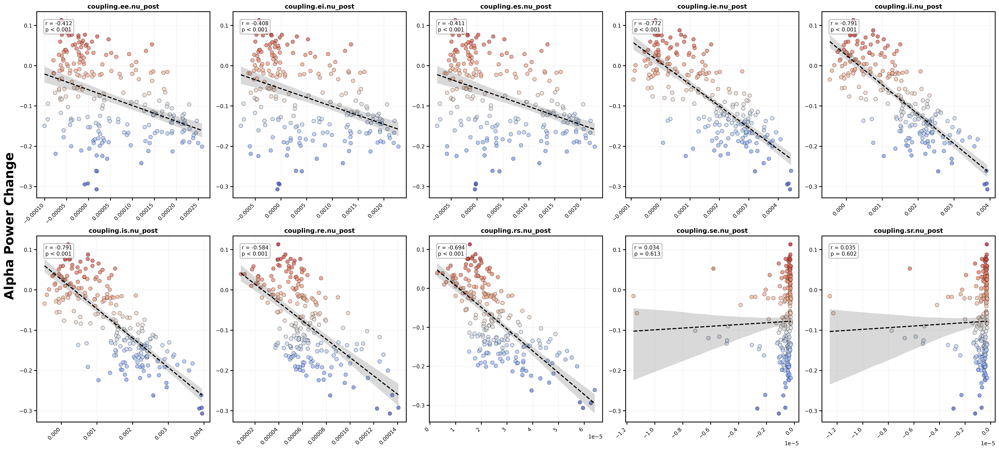

In [69]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scipy.stats as stats
from matplotlib.cm import get_cmap
from matplotlib.colors import Normalize
from matplotlib import rcParams

# Set publication-quality figure parameters
rcParams['font.family'] = 'Arial'
rcParams['font.size'] = 10
rcParams['axes.linewidth'] = 1.5
rcParams['xtick.major.width'] = 1.5
rcParams['ytick.major.width'] = 1.5
rcParams['xtick.major.size'] = 5
rcParams['ytick.major.size'] = 5

# Get the number of columns from scaled_syn_change_full
num_cols = len(scaled_syn_change_full.columns)

# Calculate grid dimensions - aim for rows of 4 plots each
num_rows = (num_cols + 3) // 5  # Ceiling division
num_cols_per_row = min(5, num_cols)

# Create the subplot figure
fig, axes = plt.subplots(num_rows, num_cols_per_row, figsize=(26, 6 * num_rows), dpi=300)
axes = axes.flatten() if num_rows > 1 or num_cols_per_row > 1 else [axes]

# Define the y variable (alpha power)
y_var = 'alpha_PW_delta'
y_var_label = 'Alpha Power Change'

# Set up colormap normalization
cmap = get_cmap('coolwarm')
norm = Normalize(vmin=scaled_105['bursts_oscillation_600'].loc[subset][y_var].min(),
                 vmax=scaled_105['bursts_oscillation_600'].loc[subset][y_var].max())

# Function to add regression plot with r and p values
def add_regression_plot(ax, x_data, y_data, x_var_name):
    # Map colors from y_var
    colors = cmap(norm(y_data))
    
    # Scatter plot with color mapped to y_var
    scatter = ax.scatter(x_data, y_data, c=colors, s=50, alpha=0.7, edgecolor='k', linewidth=0.5)
    
    # Fit regression line
    sns.regplot(x=x_data, y=y_data, ax=ax, ci=95, scatter=False, 
                line_kws={'color': 'black', 'linewidth': 2, 'linestyle': '--'})
    
    # Correlation statistics
    r, p = stats.pearsonr(x_data, y_data)
    
    # Format p-value text with scientific notation if very small
    if p < 0.001:
        p_text = f"p < 0.001"
    else:
        p_text = f"p = {p:.3f}"
    
    # Add r and p text
    ax.annotate(f"r = {r:.3f}\n{p_text}", 
                xy=(0.05, 0.95), 
                xycoords='axes fraction',
                fontsize=10,
                bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8),
                verticalalignment='top')
    
    # Set axis titles and labels
    ax.set_title(f'{x_var_name}', fontsize=12, fontweight='bold')
    ax.set_xlabel('', fontsize=11)
    ax.set_ylabel('', fontsize=11)
    
    # Add grid for better readability
    ax.grid(True, linestyle='--', alpha=0.3)
    
    # Make tick labels more readable
    ax.tick_params(axis='both', which='major', labelsize=10)
    
    # Add a subtle box around the plot
    for spine in ax.spines.values():
        spine.set_color('black')
        spine.set_linewidth(1.5)
    
    # Rotate x-axis tick labels by 45 degrees
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

# Plot each subplot
for i, col_name in enumerate(scaled_syn_change_full.columns):
    if i < len(axes):  # Ensure we don't exceed the number of created subplots
        # Extract the data we need
        x_data = scaled_syn_change_full.loc[subset][col_name]
        y_data = scaled_105['bursts_oscillation_600'].loc[subset][y_var]
        # Create the regression plot
        add_regression_plot(axes[i], x_data, y_data, col_name)

# Hide any unused subplots
for i in range(num_cols, len(axes)):
    axes[i].set_visible(False)

# Add a common y-label for the entire figure
fig.text(-0.01, 0.5, y_var_label, va='center', rotation='vertical', fontsize=24, fontweight='bold')

# Add space between subplots
plt.subplots_adjust(wspace=0.35, hspace=0.4)

plt.tight_layout()
plt.show()